In [1]:
import pandas as pd
from sklearn.datasets import make_regression
from keras.models import Sequential
from keras.layers import Dense
import numpy as np
import os
import seaborn as sns
import pandas as pd
from math import e,sqrt
import matplotlib.pyplot as plt
from scipy.optimize import least_squares
from scipy.optimize import leastsq
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_percentage_error
from sklearn.metrics import r2_score

In [2]:
import numpy as np
def clean_dataset(df):
    assert isinstance(df, pd.DataFrame)
    df.dropna(inplace=True)
    indices_to_keep = ~df.isin([np.nan, np.inf, -np.inf]).any(1)
    return df[indices_to_keep].astype(np.float64)

In [3]:
#!pip3 install -U git+https://github.com/PYFTS/pyFTS

In [5]:
import pandas as pd

#df = pd.read_csv('/content/energydata_complete.csv', sep=',')
df = pd.read_csv('/home/hugo/projetos-doutorado/mimo_emb_fts/data/energydata_complete.csv', sep=',')
df = df.drop(labels=['date','rv1', 'rv2'], axis=1)
df = clean_dataset(df)
df.head()


,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,...,T8,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint
0,60.0,30.0,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,45.566667,...,18.2,48.900000,17.033333,45.53,6.600000,733.5,92.0,7.000000,63.000000,5.3
1,60.0,30.0,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,45.992500,...,18.2,48.863333,17.066667,45.56,6.483333,733.6,92.0,6.666667,59.166667,5.2
2,50.0,30.0,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,45.890000,...,18.2,48.730000,17.000000,45.50,6.366667,733.7,92.0,6.333333,55.333333,5.1
3,50.0,40.0,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,45.723333,...,18.1,48.590000,17.000000,45.40,6.250000,733.8,92.0,6.000000,51.500000,5.0
4,60.0,40.0,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,45.530000,...,18.1,48.590000,17.000000,45.40,6.133333,733.9,92.0,5.666667,47.666667,4.9


In [6]:
# convert series to supervised learning
def series_to_supervised_mimo(data, n_in, n_out, dropnan=True):
	"""
	Frame a time series as a supervised learning dataset.
	Arguments:
		data: Sequence of observations as a list or NumPy array.
		n_in: Number of lag observations as input (X).
		n_out: Number of observations as output (y).
		dropnan: Boolean whether or not to drop rows with NaN values.
	Returns:
		Pandas DataFrame of series framed for supervised learning.
	"""
	n_vars = 1 if type(data) is list else data.shape[1]
	df = pd.DataFrame(data)
	cols, names = list(), list()
	# input sequence (t-n, ... t-1)
	for i in range(n_in, 0, -1):
		cols.append(df.shift(i))
		names += [(df.columns[j]+'(t-%d)' % (i)) for j in range(n_vars)]
	# forecast sequence (t, t+1, ... t+n)
	for i in range(0, n_out):
		cols.append(df.shift(-i))
		if i == 0:
			names += [(df.columns[j]+'(t)') for j in range(n_vars)]
		else:
			names += [(df.columns[j]+'%d(t+%d)' % (j, i)) for j in range(n_vars)]
	# put it all together
	agg = pd.concat(cols, axis=1)
	agg.columns = names
	# drop rows with NaN values
	if dropnan:
		agg.dropna(inplace=True)
	return agg

In [7]:
reframed = series_to_supervised_mimo(df, 1, 1)
reframed.head()

,Appliances(t-1),lights(t-1),T1(t-1),RH_1(t-1),T2(t-1),RH_2(t-1),T3(t-1),RH_3(t-1),T4(t-1),RH_4(t-1),...,T8(t),RH_8(t),T9(t),RH_9(t),T_out(t),Press_mm_hg(t),RH_out(t),Windspeed(t),Visibility(t),Tdewpoint(t)
1,60.0,30.0,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,45.566667,...,18.2,48.863333,17.066667,45.56,6.483333,733.6,92.0,6.666667,59.166667,5.2
2,60.0,30.0,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,45.992500,...,18.2,48.730000,17.000000,45.50,6.366667,733.7,92.0,6.333333,55.333333,5.1
3,50.0,30.0,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,45.890000,...,18.1,48.590000,17.000000,45.40,6.250000,733.8,92.0,6.000000,51.500000,5.0
4,50.0,40.0,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,45.723333,...,18.1,48.590000,17.000000,45.40,6.133333,733.9,92.0,5.666667,47.666667,4.9
5,60.0,40.0,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,45.530000,...,18.1,48.590000,17.000000,45.29,6.016667,734.0,92.0,5.333333,43.833333,4.8


In [8]:
reframed.columns

Index(['Appliances(t-1)', 'lights(t-1)', 'T1(t-1)', 'RH_1(t-1)', 'T2(t-1)',
       'RH_2(t-1)', 'T3(t-1)', 'RH_3(t-1)', 'T4(t-1)', 'RH_4(t-1)', 'T5(t-1)',
       'RH_5(t-1)', 'T6(t-1)', 'RH_6(t-1)', 'T7(t-1)', 'RH_7(t-1)', 'T8(t-1)',
       'RH_8(t-1)', 'T9(t-1)', 'RH_9(t-1)', 'T_out(t-1)', 'Press_mm_hg(t-1)',
       'RH_out(t-1)', 'Windspeed(t-1)', 'Visibility(t-1)', 'Tdewpoint(t-1)',
       'Appliances(t)', 'lights(t)', 'T1(t)', 'RH_1(t)', 'T2(t)', 'RH_2(t)',
       'T3(t)', 'RH_3(t)', 'T4(t)', 'RH_4(t)', 'T5(t)', 'RH_5(t)', 'T6(t)',
       'RH_6(t)', 'T7(t)', 'RH_7(t)', 'T8(t)', 'RH_8(t)', 'T9(t)', 'RH_9(t)',
       'T_out(t)', 'Press_mm_hg(t)', 'RH_out(t)', 'Windspeed(t)',
       'Visibility(t)', 'Tdewpoint(t)'],
      dtype='object')

In [9]:
def lags_v(dados, p):
  T, n = dados.shape
  X = np.zeros((T-p, n*p))
  Y = dados[p:, :]
  for i in range(p, T):
    for j in range(p):
      X[i - p, j*n:(j*n)+n] = dados[i-(p-j), : ]
  return X, Y

def var(dados, parametros):
  T, n = dados.shape
  coef, _ = parametros
  p = int(coef.shape[0]/n)
  X,_ = lags_v(dados, p)
  ret = np.zeros((T-p, n))
  for i in range(T-p):
    ret[i, :] = coef.T @ X[i, :]
  return ret

def ajustar_var(dados, p):
  X,Y = lags_v(dados, p)

  coef = np.linalg.inv(X.T @ X) @ ( X.T @ Y )
  #coef = np.linalg.pinv(X.T @ X) @ ( X.T @ Y )

  previsoes = var(dados, [coef, None])

  residuos = dados[p:, :] - previsoes

  Sigma = np.sqrt(np.cov(residuos, rowvar=False))

  return coef, Sigma

In [10]:
def cal_nrmse(rmse, y):
    x = max(y)-min(y)
    return (rmse/x)

In [22]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
import math
from pyFTS.common import Util
from pyFTS.benchmarks import Measures
def sliding_window(data,n_windows,train_size):

    result = {
         "window": [],
         "rmse": [],
         "mape": [],
         "mae": [],
         "r2": [],
         "smape": [],
         "nrmse": [],
         "variable":[]
    }

    final_result = {
         "window": [],
         "rmse": [],
         "mape": [],
         "mae": [],
         "r2": [],
         "smape": [],
         "nrmse": [],
         "variable":[]
    }

    tam = len(data)
    n_windows = 30
    windows_length = math.floor(tam / n_windows)
    for ct, ttrain, ttest in Util.sliding_window(data, windows_length, train_size, inc=1):
        if len(ttest) > 0:

            print('-' * 20)
            print(f'training window {(ct)}')

#             Xtrain = ttrain.loc[:,'Appliances(t-1)':'Tdewpoint(t-1)']
#             ytrain = ttrain.loc[:,'Appliances(t)':'Tdewpoint(t)']
#             Xtest = ttest.loc[:,'Appliances(t-1)':'Tdewpoint(t-1)']
#             ytest = ttest.loc[:,'Appliances(t)':'Tdewpoint(t)']

            scaler1 = StandardScaler()
            scaler2 = StandardScaler()
            Xtrain = scaler1.fit_transform(ttrain.loc[:,'Appliances(t-1)':'Tdewpoint(t-1)'])
            ytrain = scaler2.fit_transform(ttrain.loc[:,'Appliances(t)':'Tdewpoint(t)'])
            Xtest = scaler1.transform(ttest.loc[:,'Appliances(t-1)':'Tdewpoint(t-1)'])
            ytest = scaler2.transform(ttest.loc[:,'Appliances(t)':'Tdewpoint(t)'])
            order = 1  # Order of the VAR model
            p = order

# Prepare lagged data matrix
            def prepare_lagged_data(data, order):
                n_obs, n_vars = data.shape
                X = np.zeros((n_obs - order, order * n_vars))
                for i in range(order, n_obs):
                    X[i - order] = data[i - order:i, :].flatten()
                return X

          # Fit VAR model
            def fit_var_model(train_data, order):
                X_train = prepare_lagged_data(Xtrain, order)
                Y_train = Xtrain[order:]
                coefficients = np.linalg.lstsq(X_train, Y_train, rcond=None)[0]
                return coefficients

            coefficients = fit_var_model(Xtrain, order)

          # Forecast
            def forecast_var_model(coefficients, initial_values, steps):
                n_vars = initial_values.shape[1]
                forecast = np.zeros((steps, n_vars))
                current_values = initial_values[-order:, :]
                for i in range(steps):
                    flattened_lagged = current_values.flatten()
                    forecast[i] = np.dot(flattened_lagged, coefficients)
                    current_values = np.vstack((current_values[1:], forecast[i]))
                return forecast

            initial_values = Xtrain[-order:, :]
            forecast_steps = len(Xtest)
            forecast = forecast_var_model(coefficients, initial_values, forecast_steps)


            # param = ajustar_var(Xtrain, p)
            # forecast = var(Xtest, param)


            forecast = scaler2.inverse_transform(forecast)
            ytest_metric = ttest.loc[:,'Appliances(t)':'Tdewpoint(t)']
            df_forecast = pd.DataFrame(forecast,columns=ytest_metric.columns)
            df_original = pd.DataFrame(ytest_metric,columns=list(ytest_metric.columns))

            for col in ytest_metric.columns:
                original = df_original[col].values
                # print(original)
                forecast = df_forecast[col].values
                # print(forecast)
                #original = original[p-1:len(original)-1]



                fig, ax = plt.subplots(nrows=1, ncols=1, figsize=[15, 3])
                ax.plot(original, label='Original')
                ax.plot(forecast, label='Forecast')
                handles, labels = ax.get_legend_handles_labels()
                lgd = ax.legend(handles, labels, loc=2, bbox_to_anchor=(1, 1))
                plt.show()

                #print("[{0: %H:%M:%S}]".format(datetime.datetime.now()) + f" getting statistics for variable: " + col)
                mae = round(mean_absolute_error(original,forecast),3)
                r2 = round(r2_score(original,forecast),3)
                #rmse = mean_squared_error(original,forecast,squared=False)
                rmse = round(Measures.rmse(original,forecast),3)
                mape = round(Measures.mape(original,forecast),3)
                nrmse = round(cal_nrmse(rmse, original),3)
                smape = round(Measures.smape(original,forecast),3)

                result["rmse"].append(rmse)
                result["nrmse"].append(nrmse)
                result["mape"].append(mape)
                result["mae"].append(mae)
                result["r2"].append(r2)
                result["smape"].append(smape)
                result["window"].append(ct)
                result["variable"].append(col)



    measures = pd.DataFrame(result)
    return measures

--------------------
training window 0


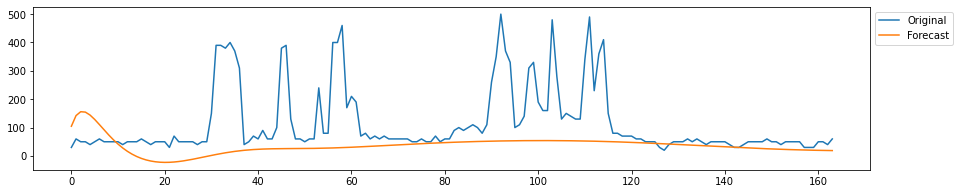

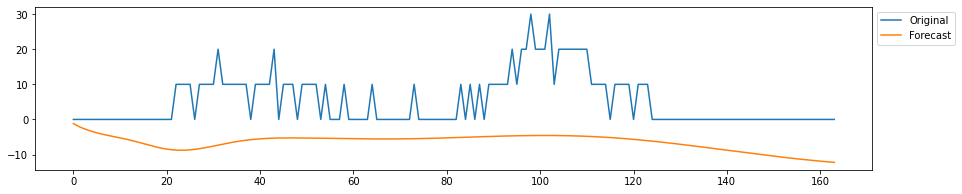

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


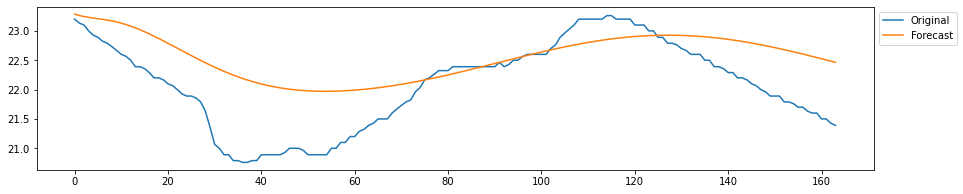

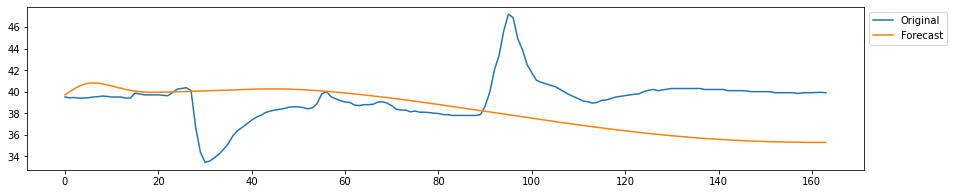

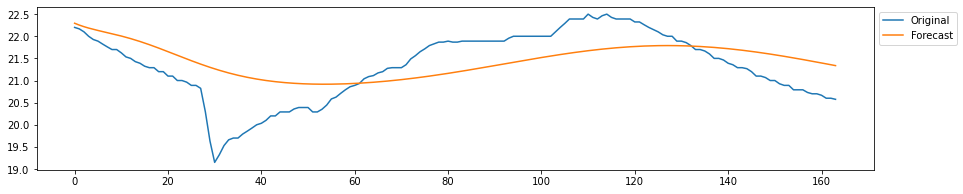

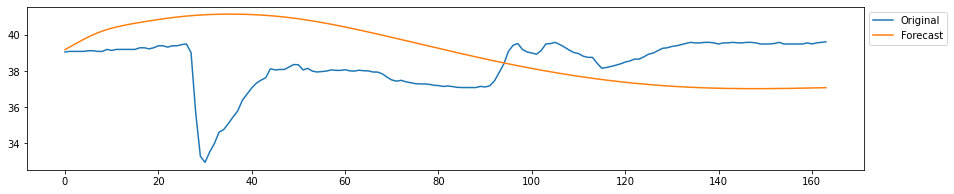

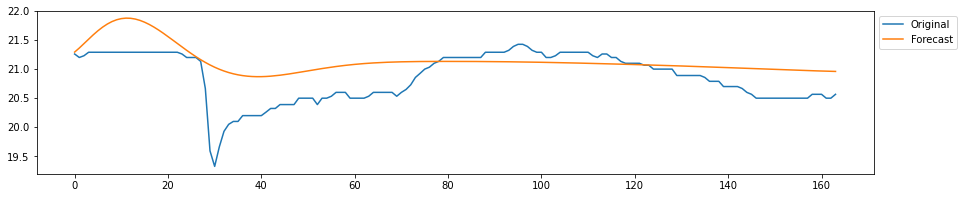

...

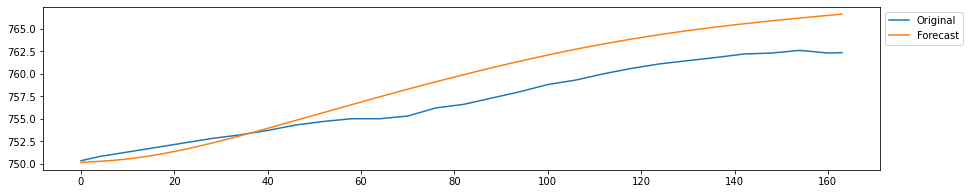

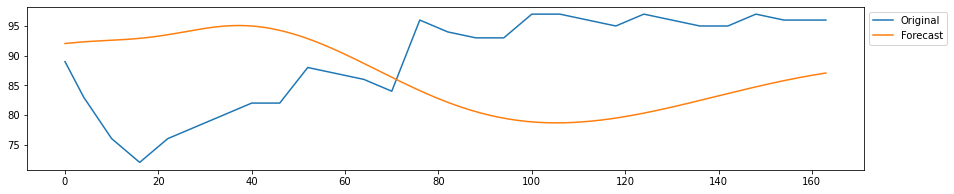

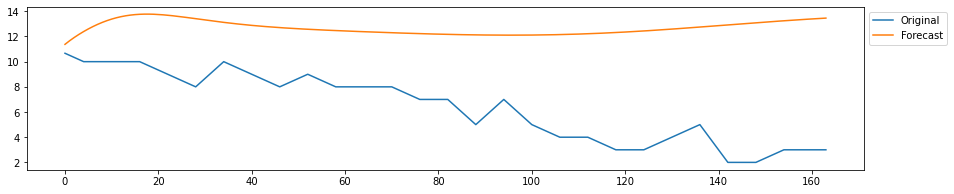

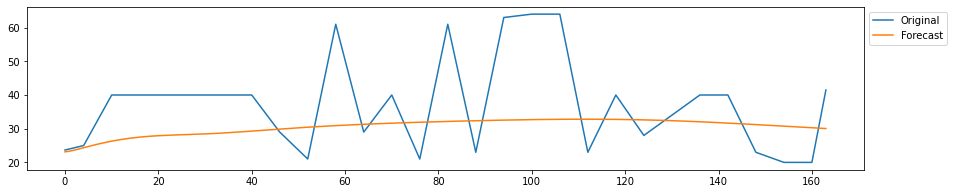

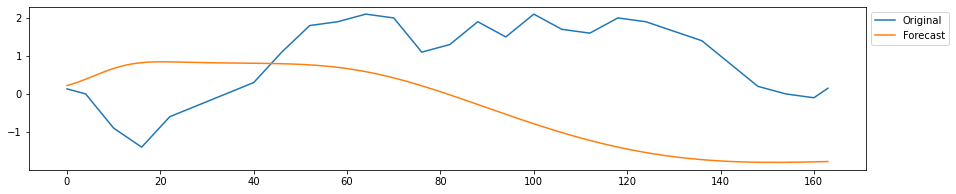

--------------------
training window 657


/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


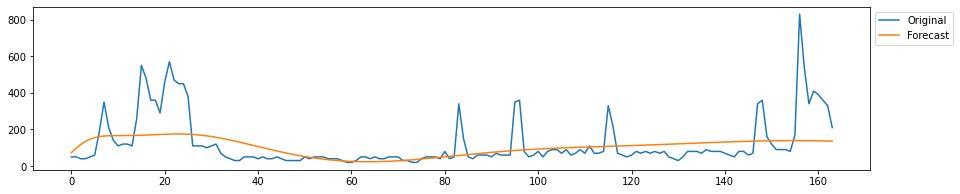

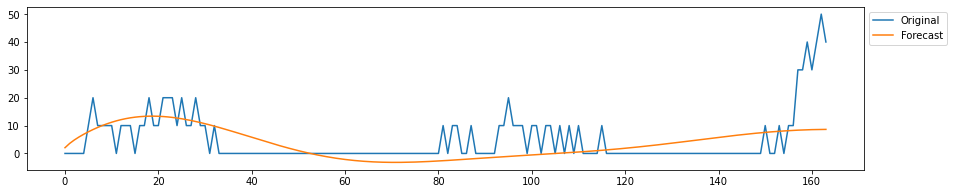

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


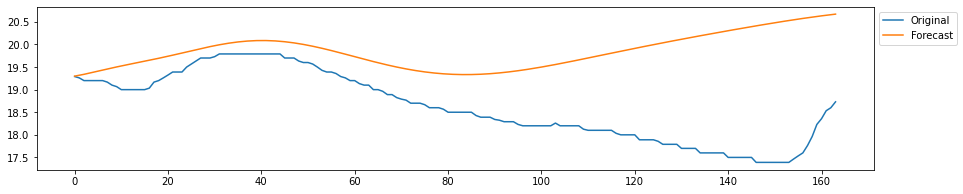

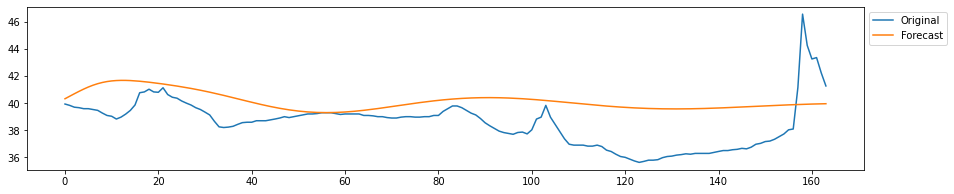

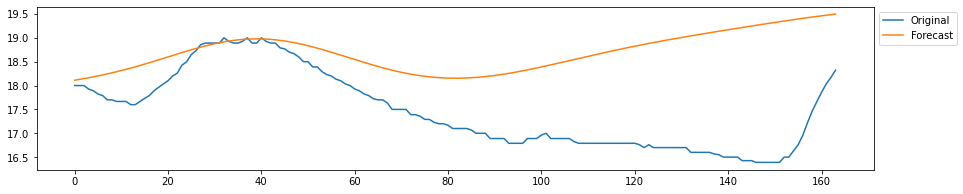

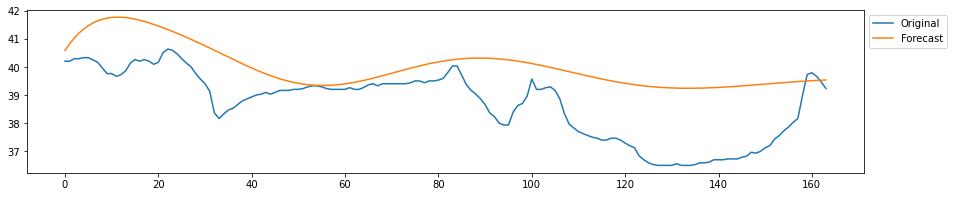

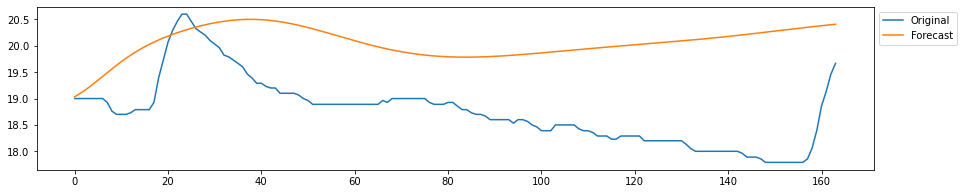

...

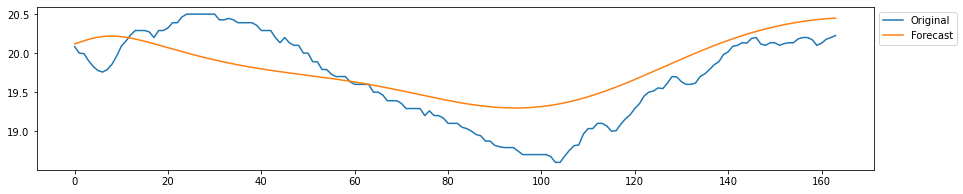

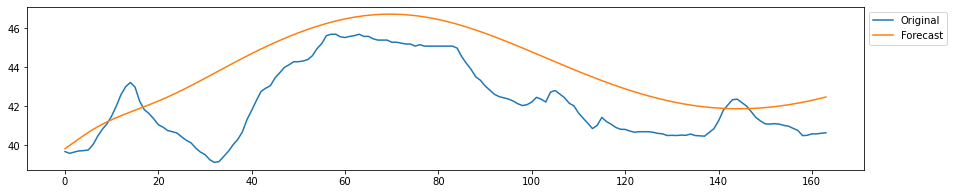

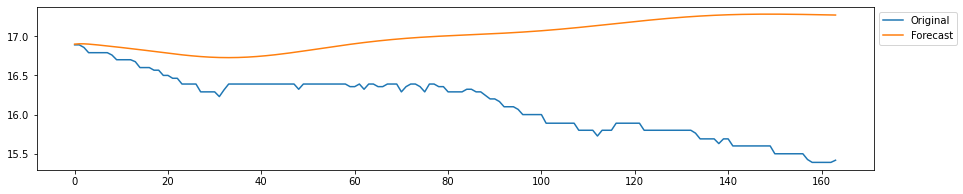

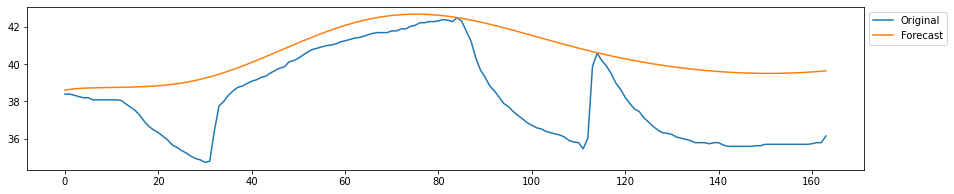

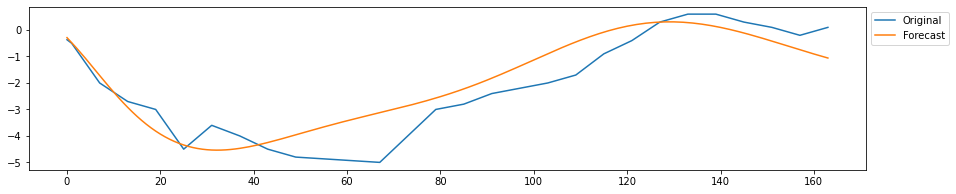

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


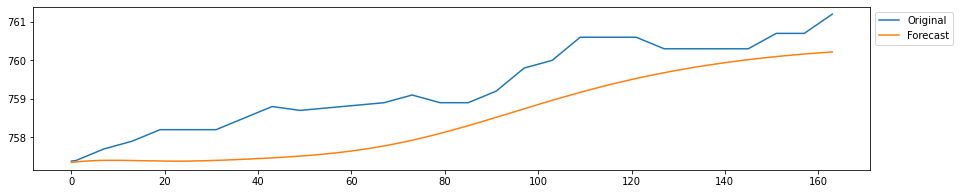

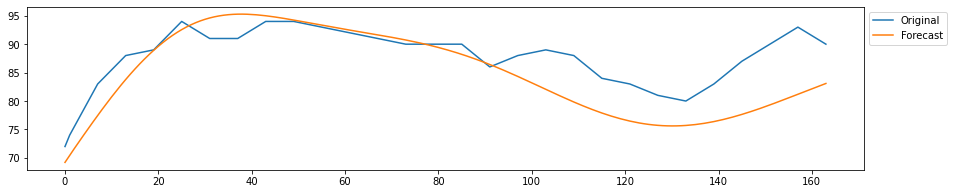

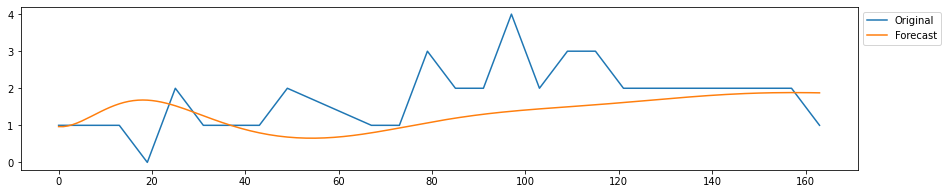

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


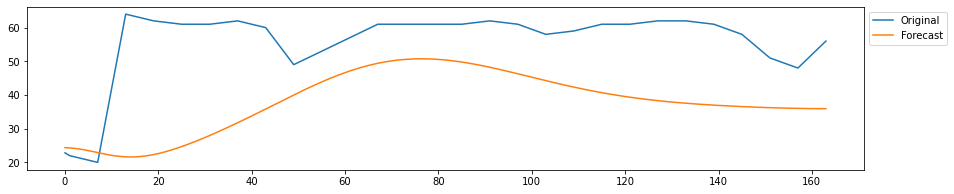

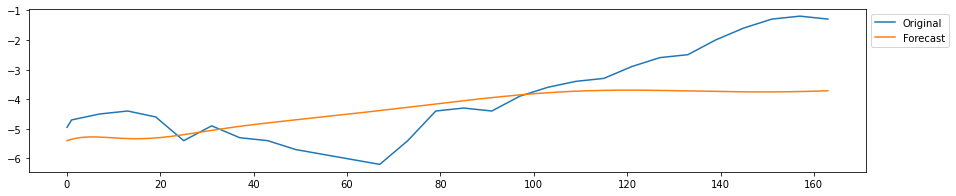

--------------------
training window 1314


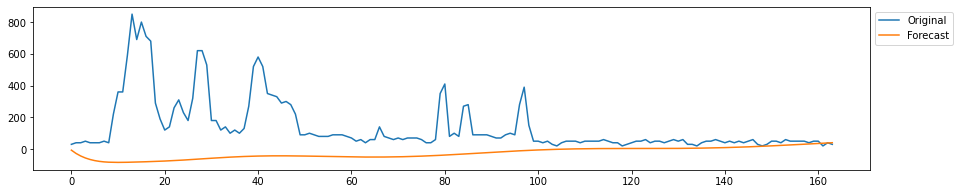

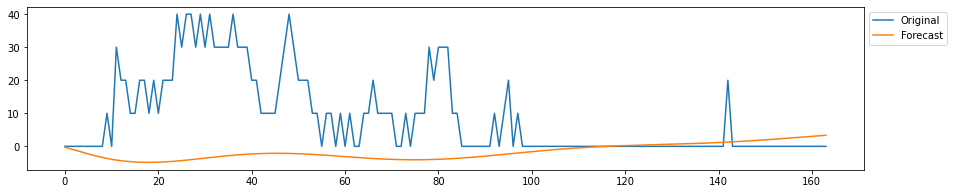

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


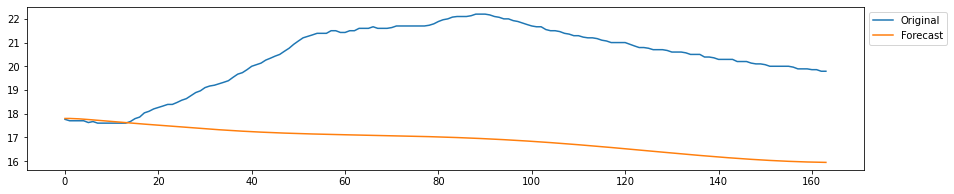

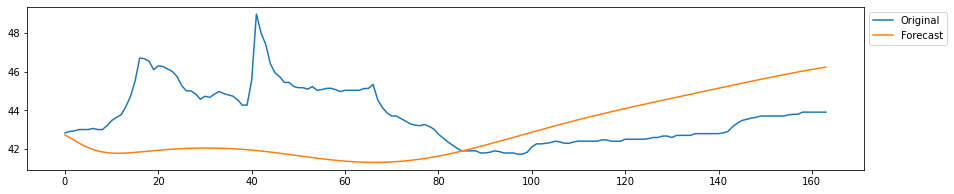

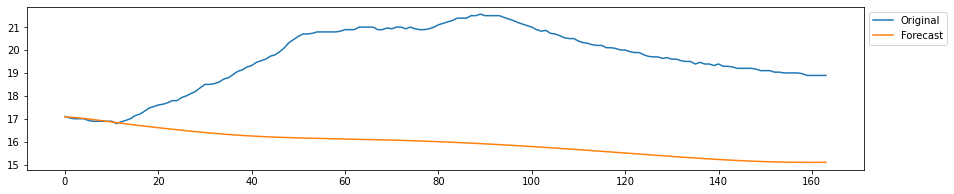

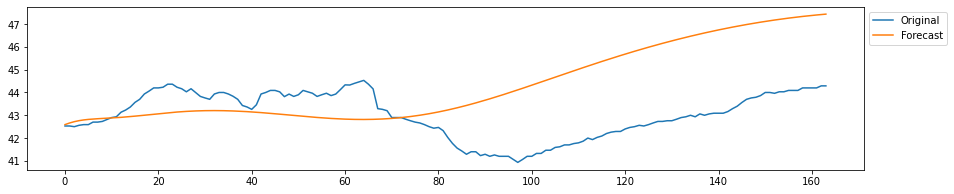

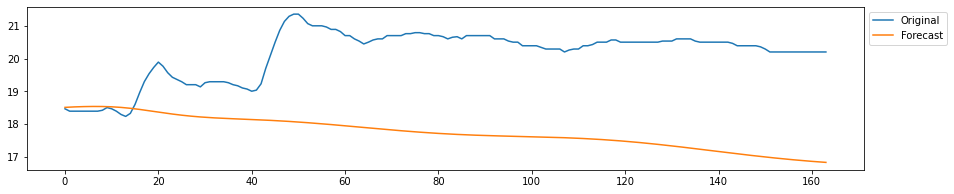

...

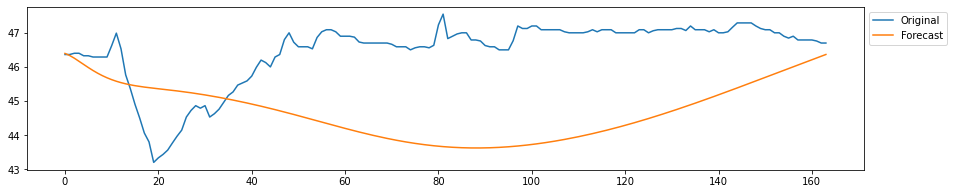

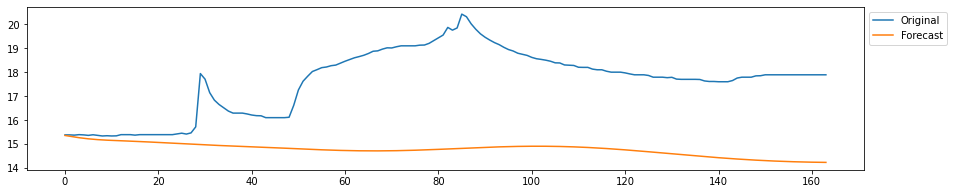

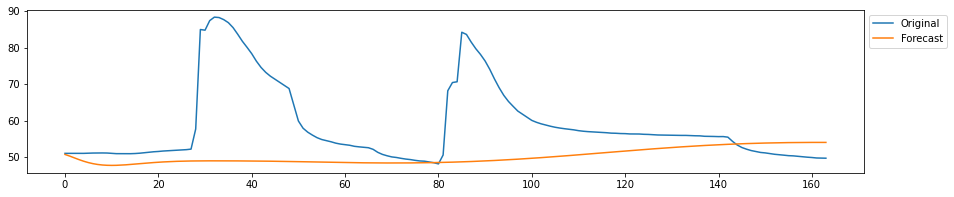

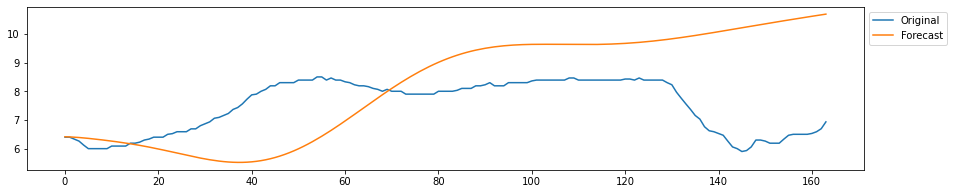

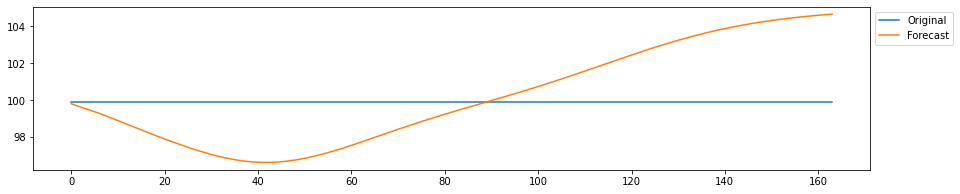

<ipython-input-10-1be783193a86>:3: RuntimeWarning: divide by zero encountered in double_scalars
  return (rmse/x)


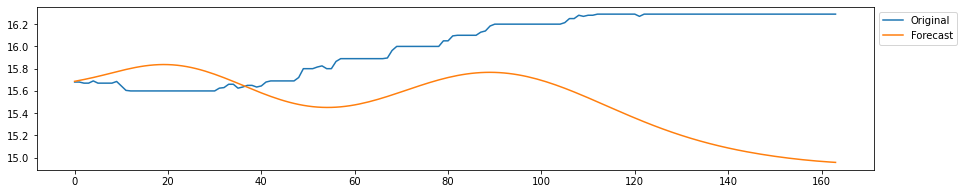

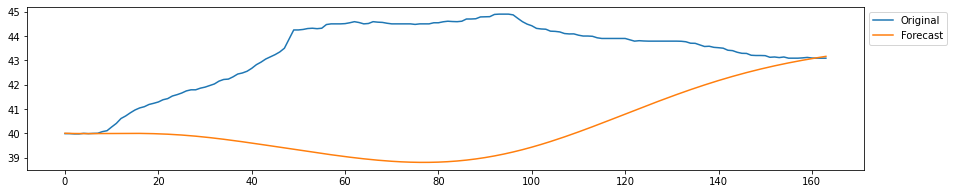

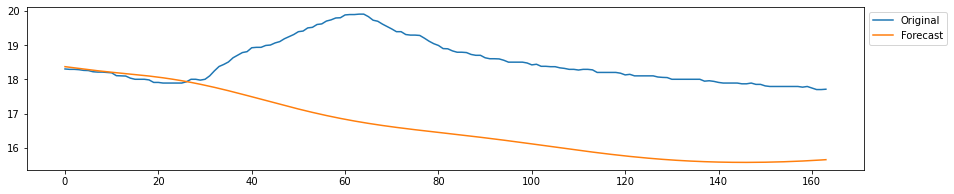

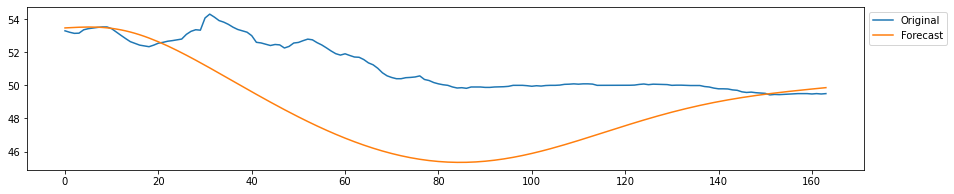

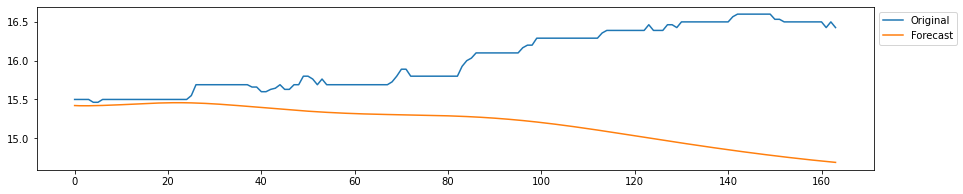

...

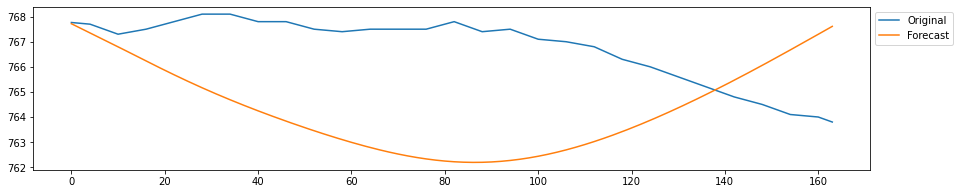

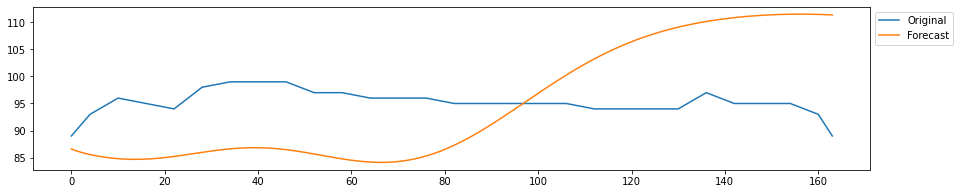

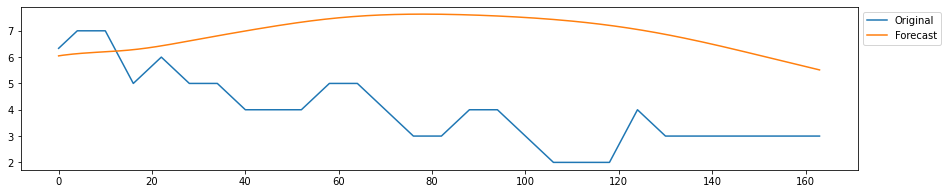

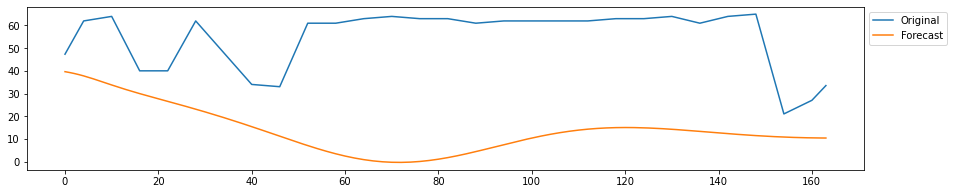

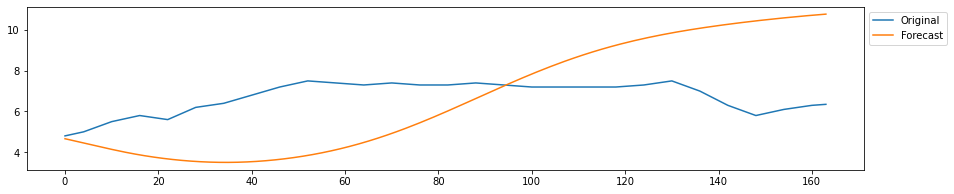

--------------------
training window 1971


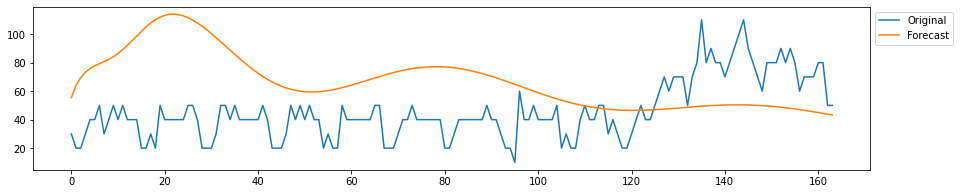

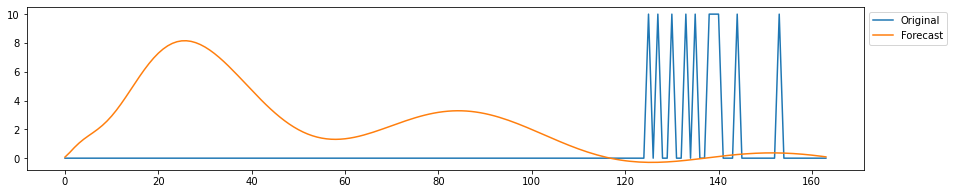

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


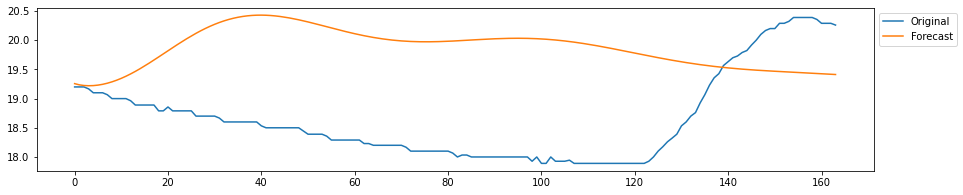

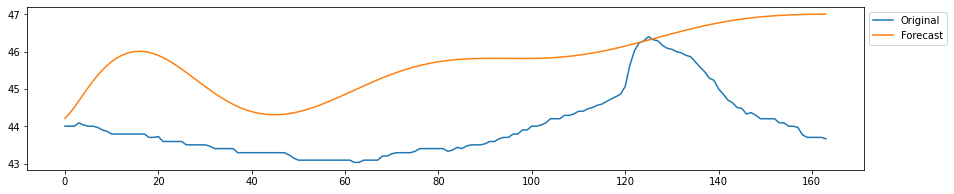

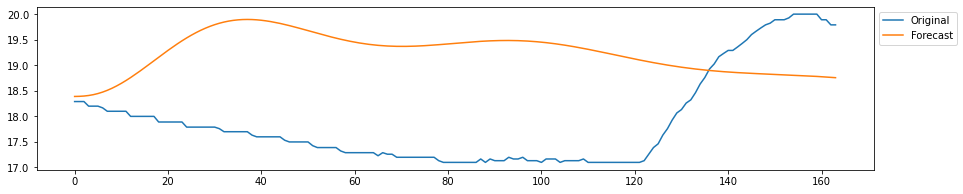

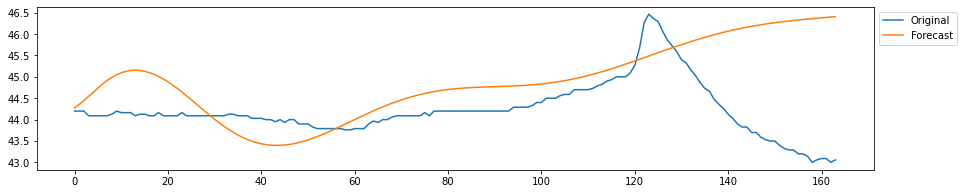

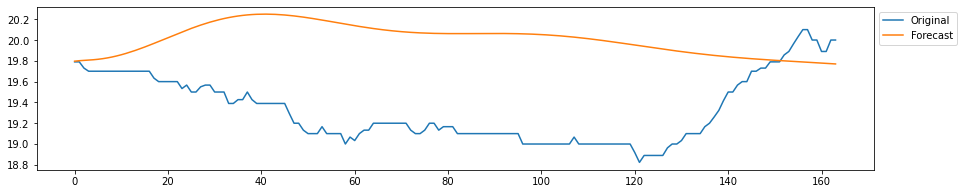

...

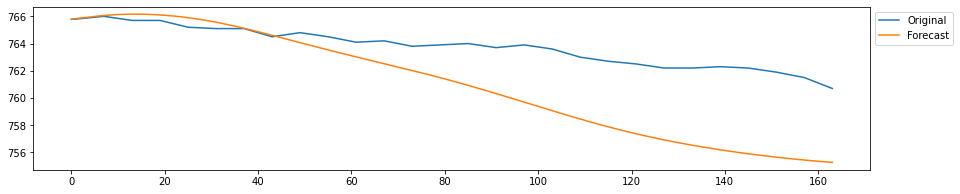

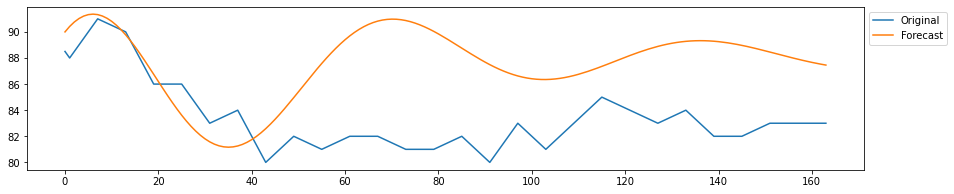

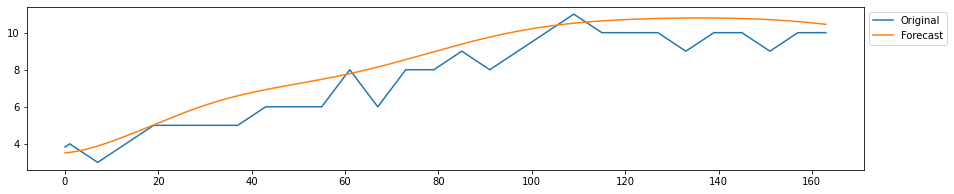

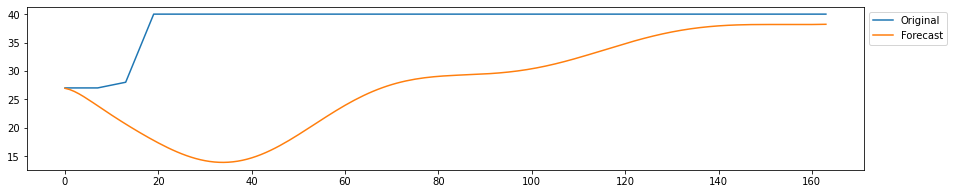

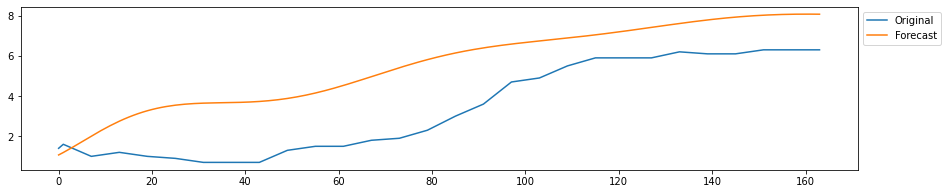

--------------------
training window 2628


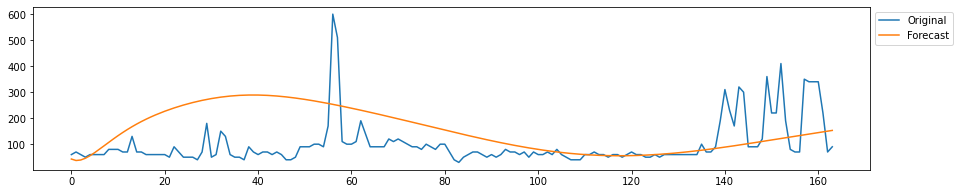

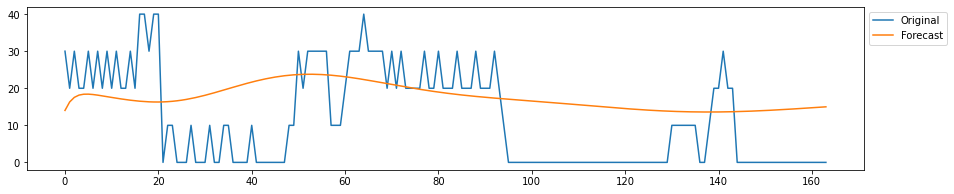

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


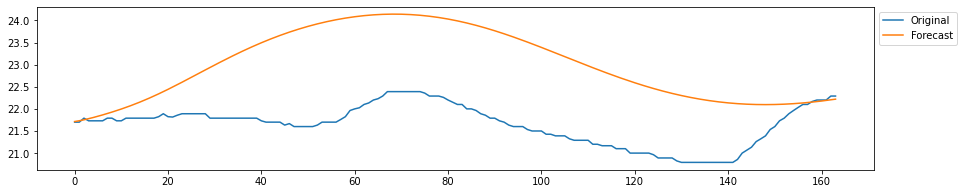

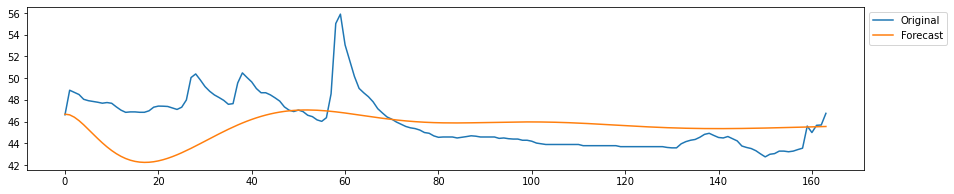

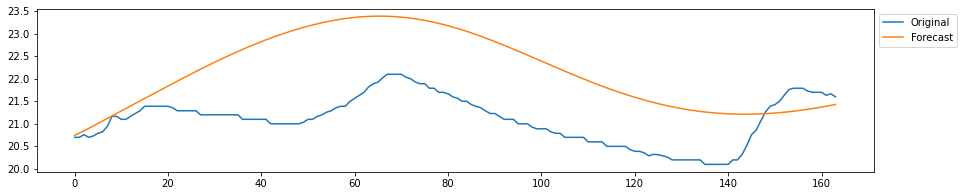

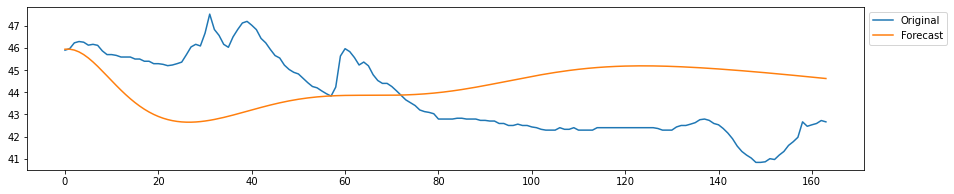

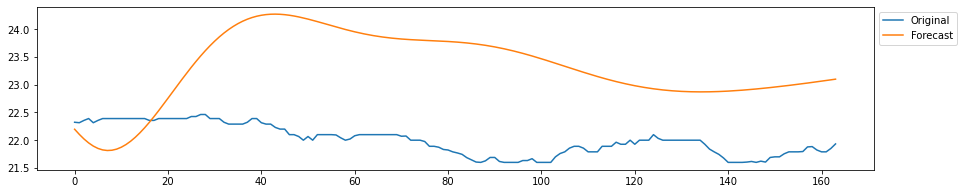

...

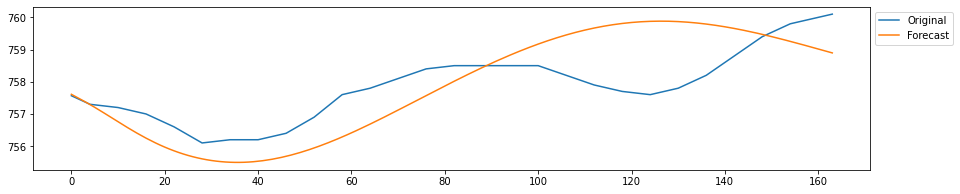

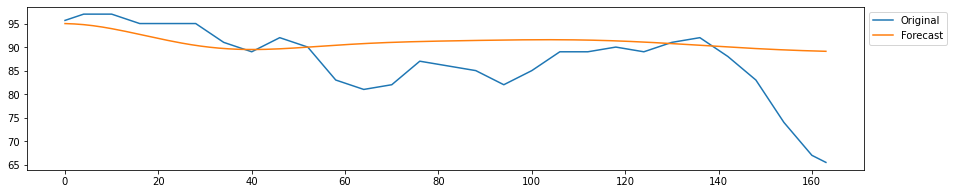

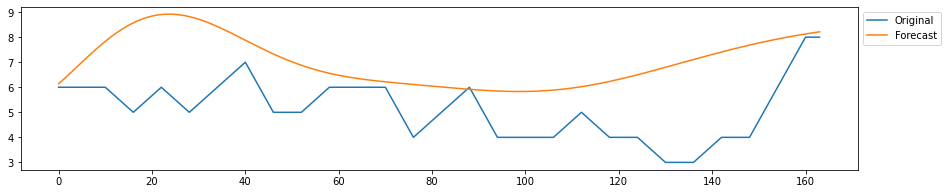

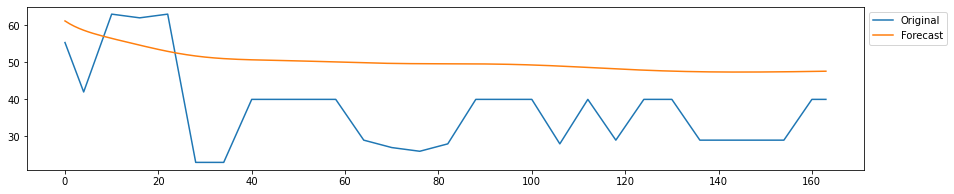

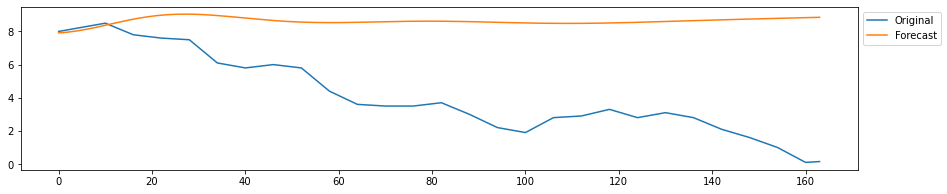

--------------------
training window 3285


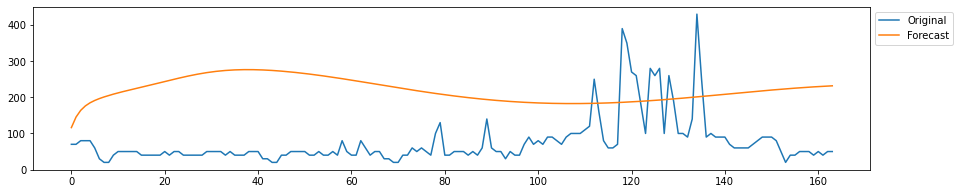

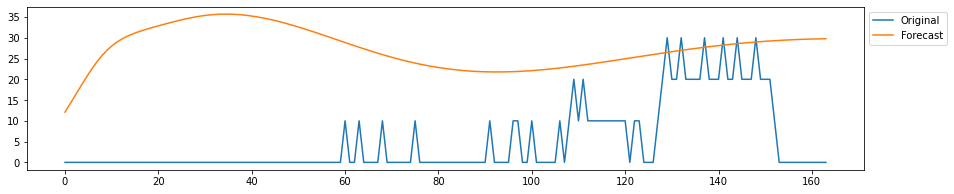

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


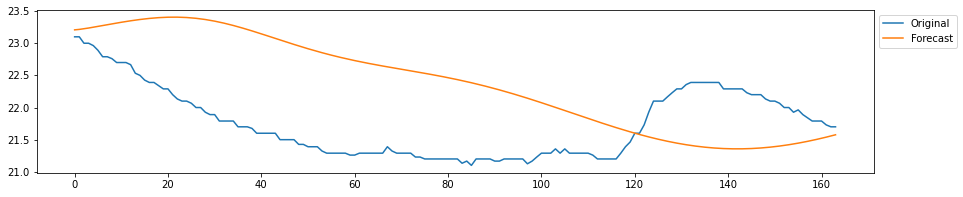

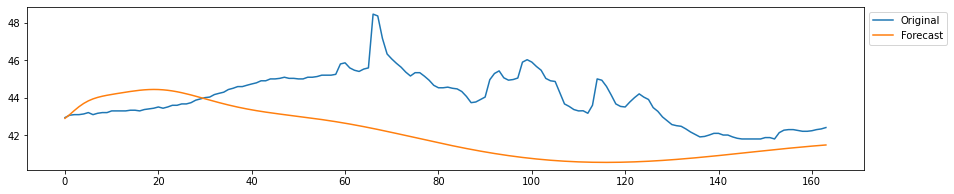

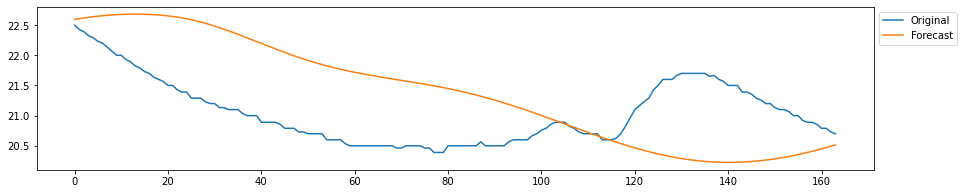

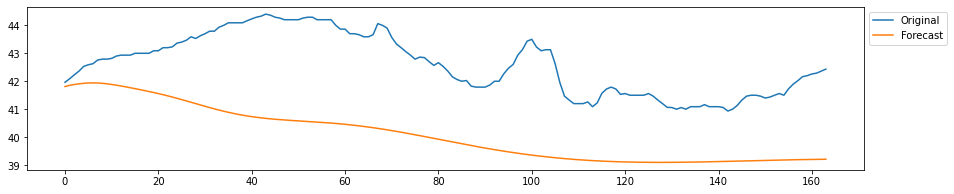

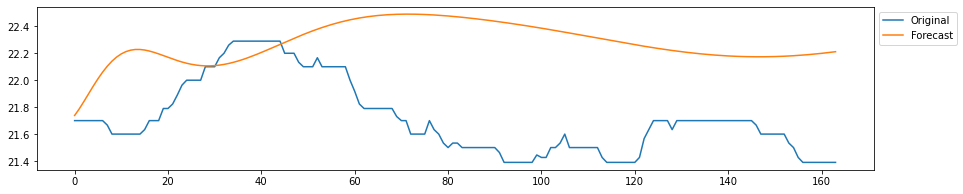

...

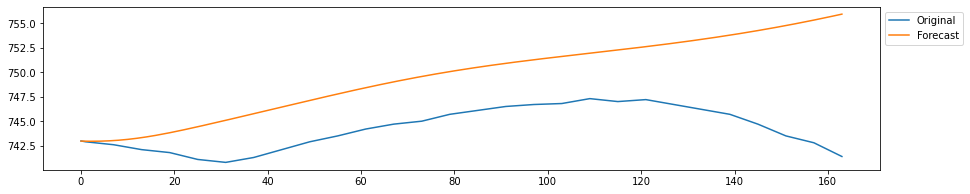

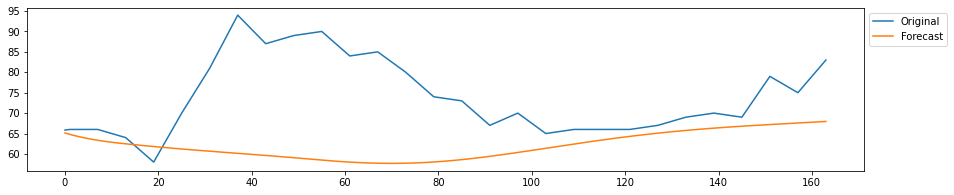

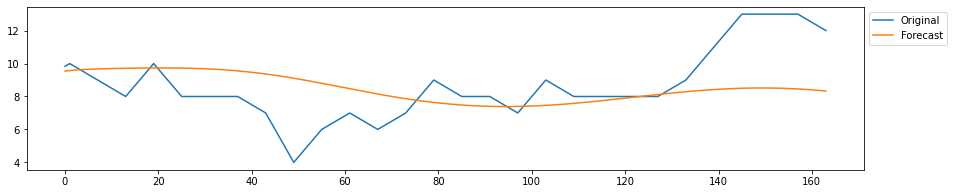

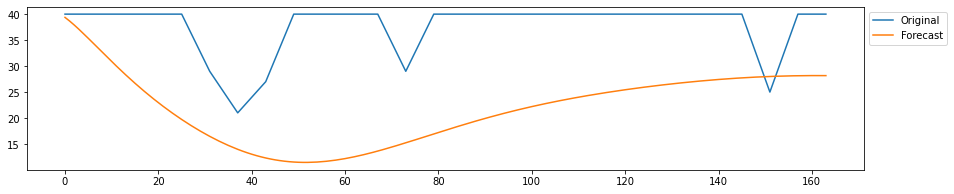

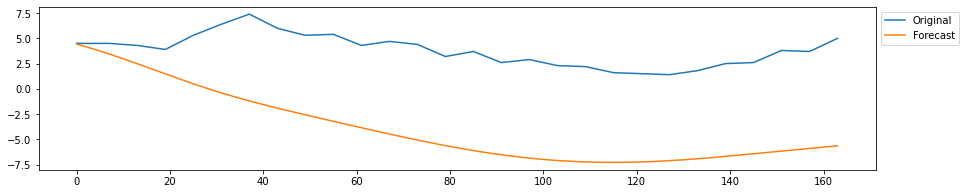

--------------------
training window 3942


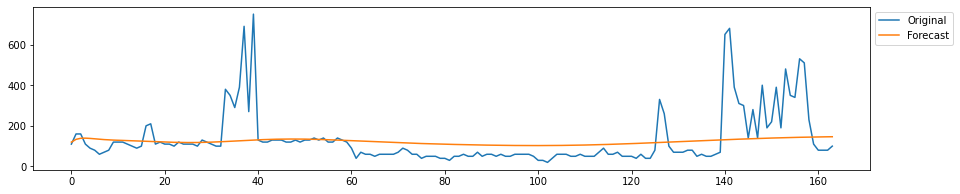

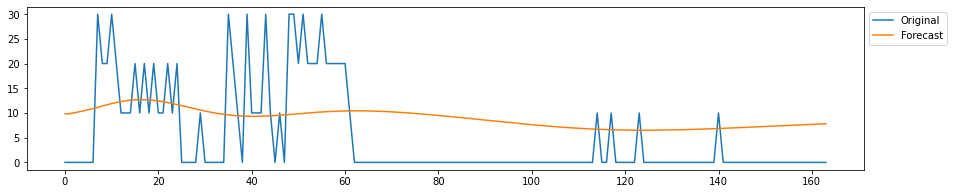

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


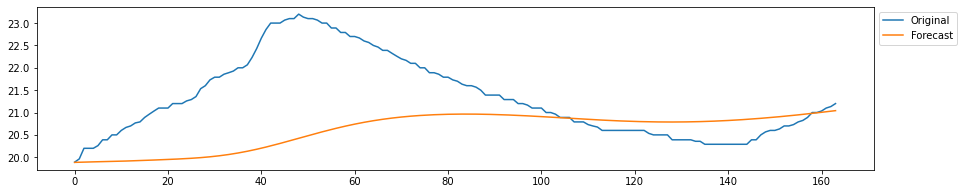

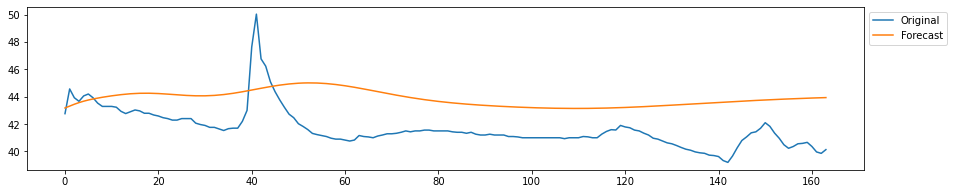

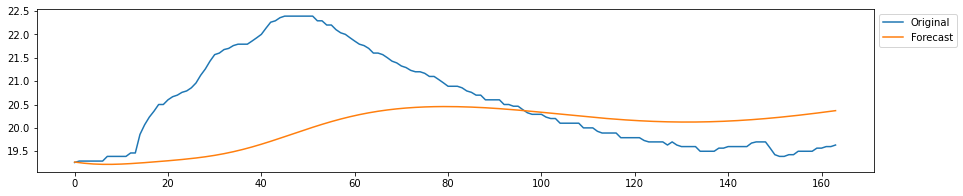

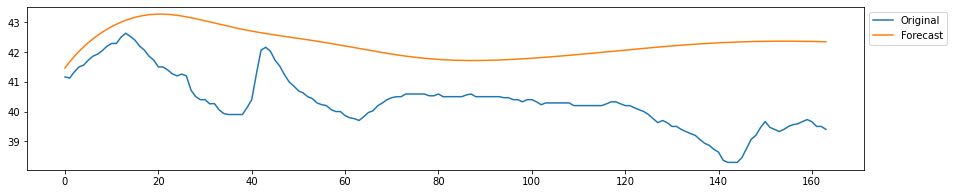

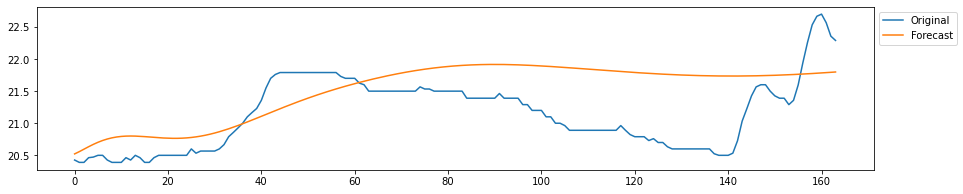

...

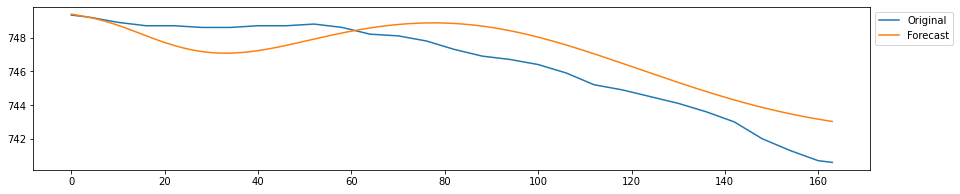

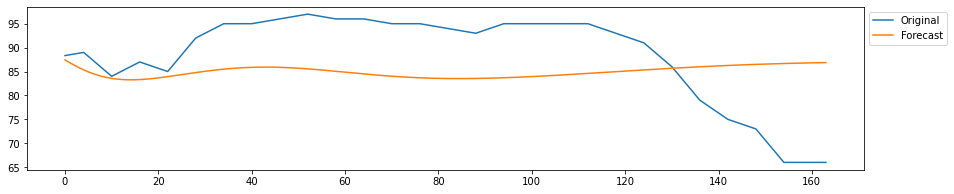

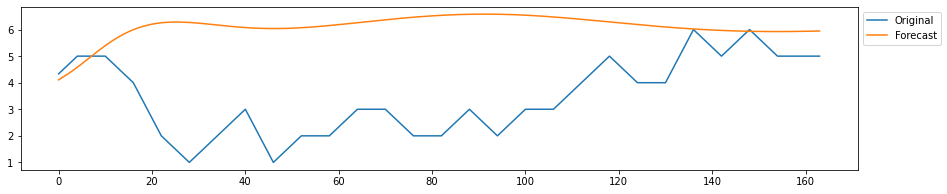

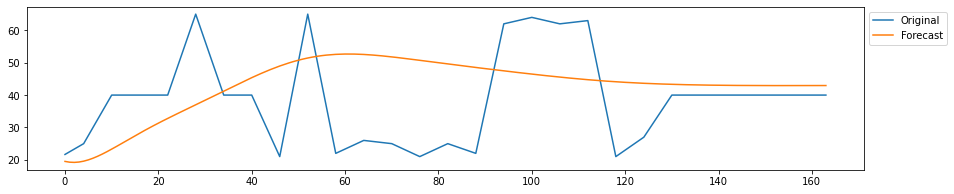

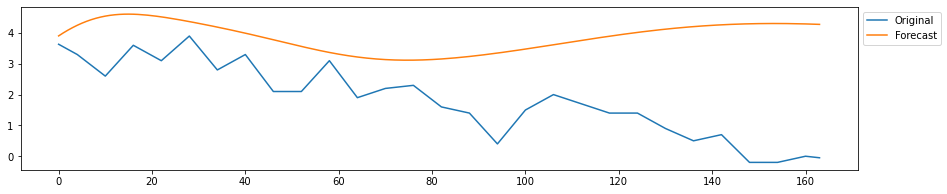

--------------------
training window 4599


/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


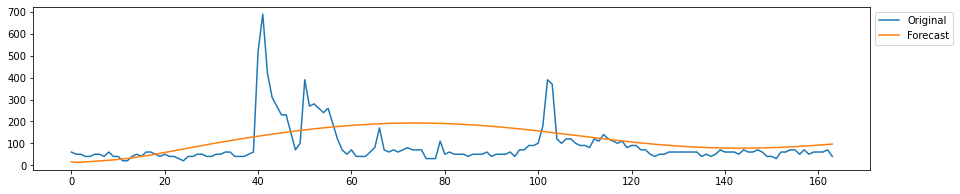

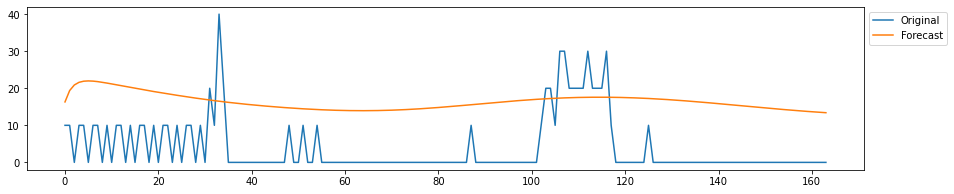

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


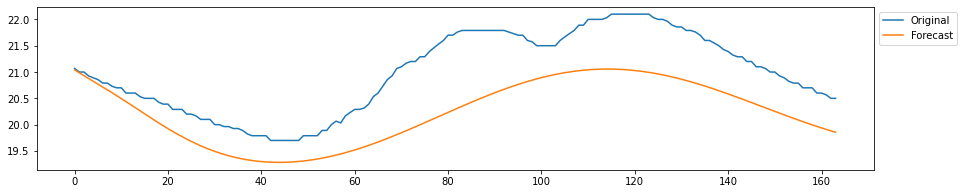

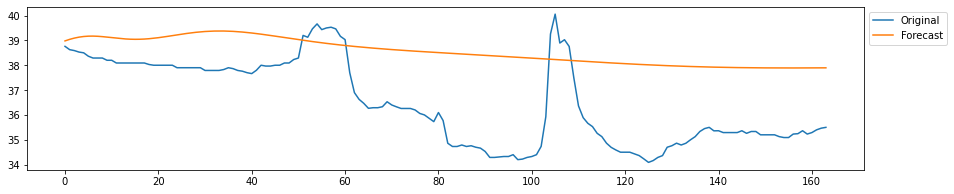

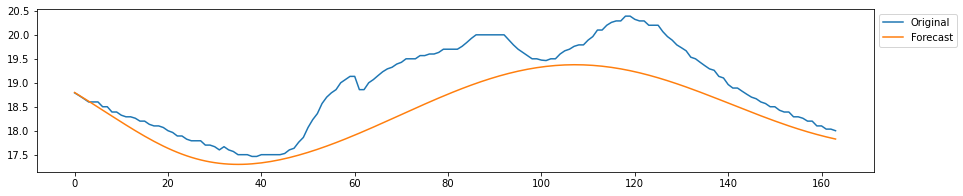

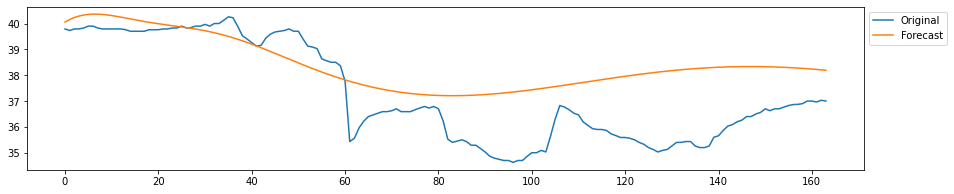

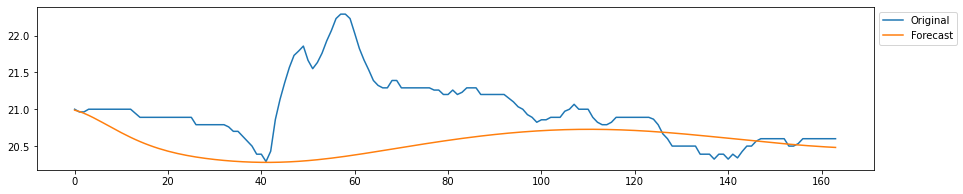

...

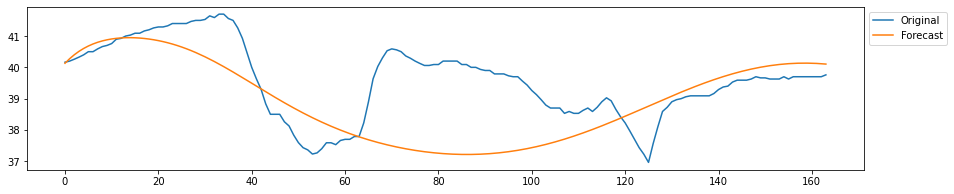

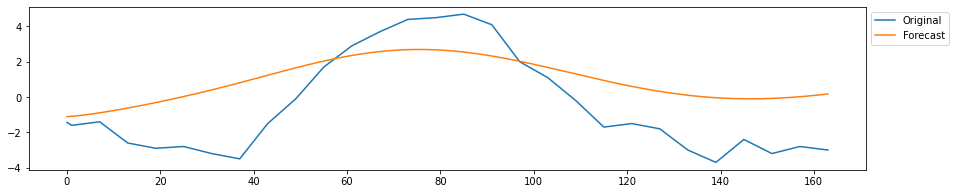

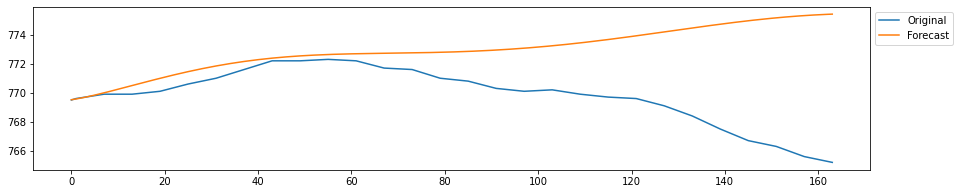

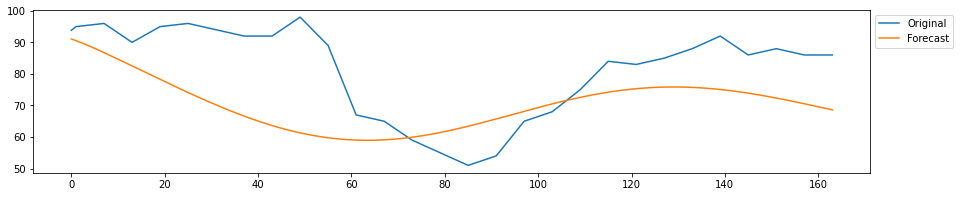

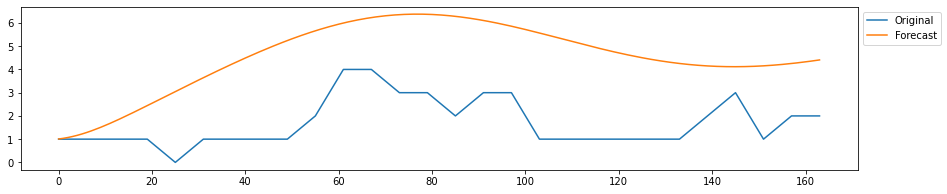

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


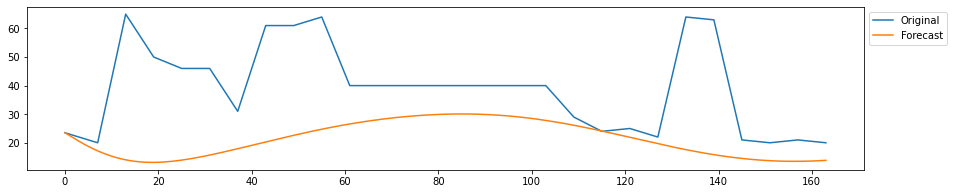

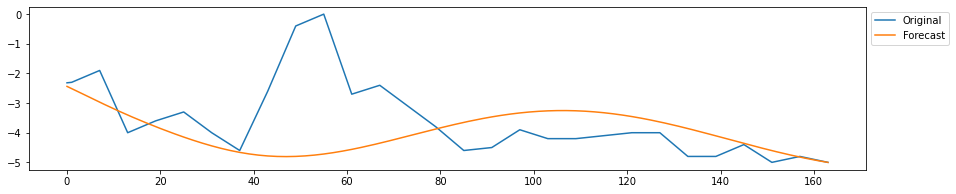

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


--------------------
training window 5256


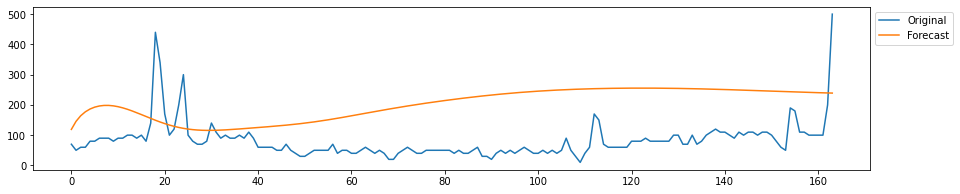

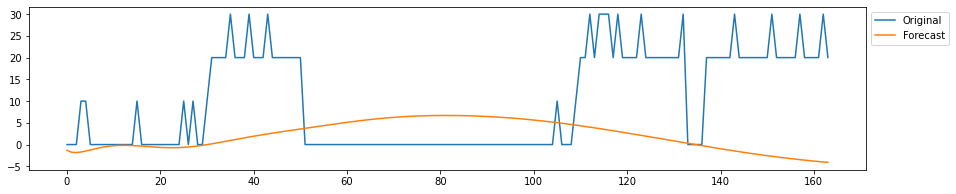

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


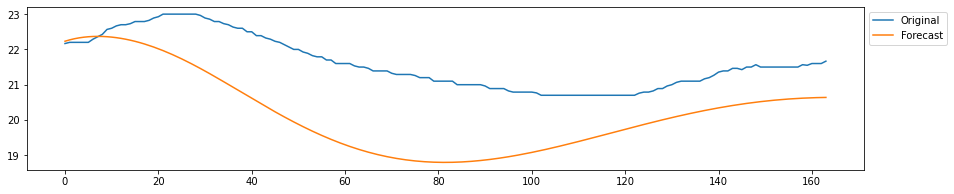

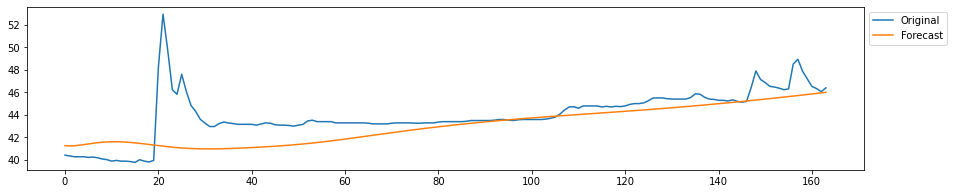

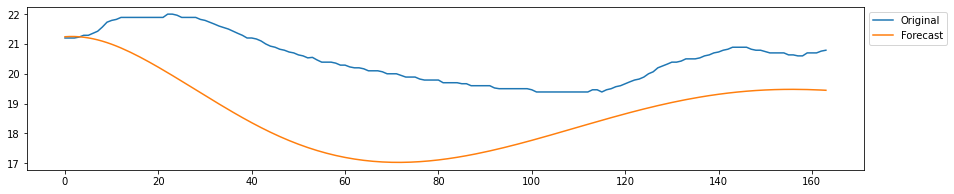

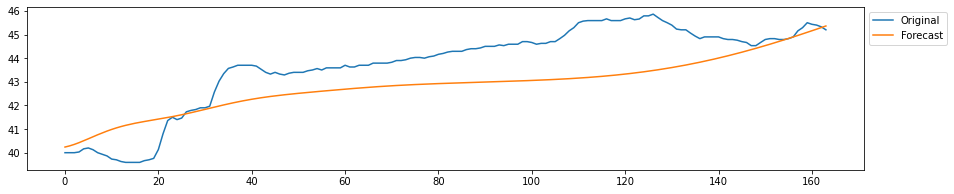

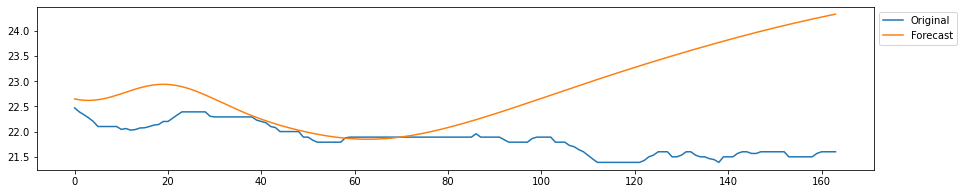

...

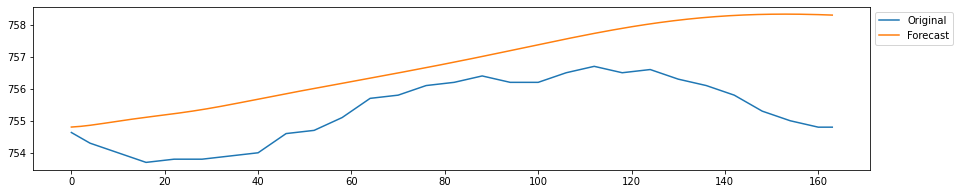

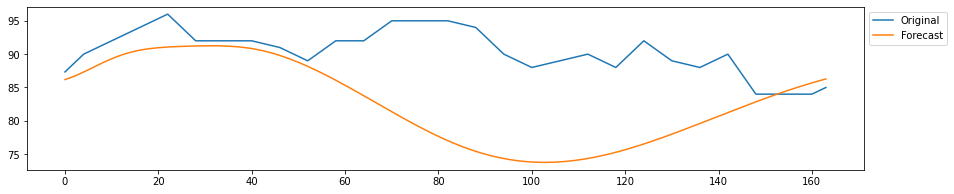

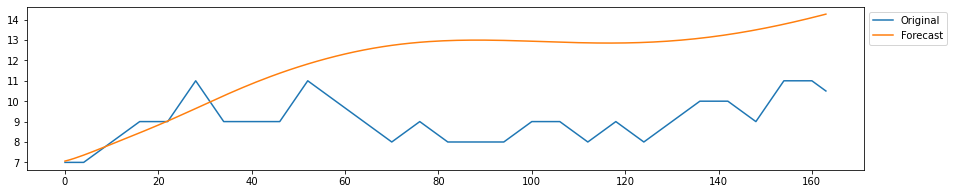

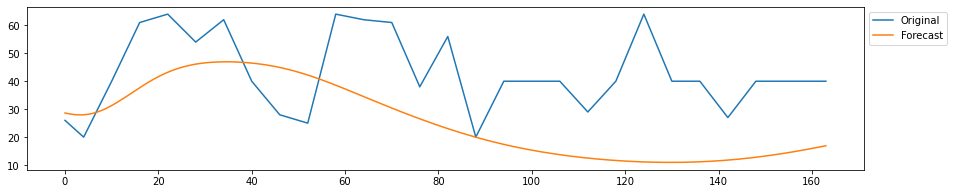

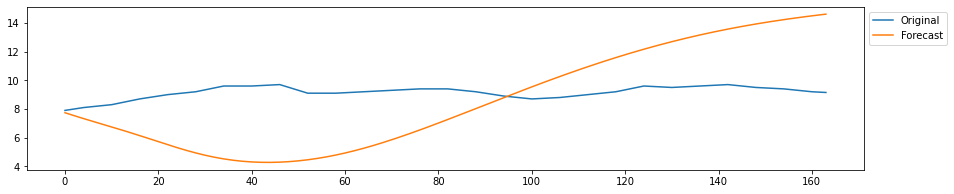

--------------------
training window 5913


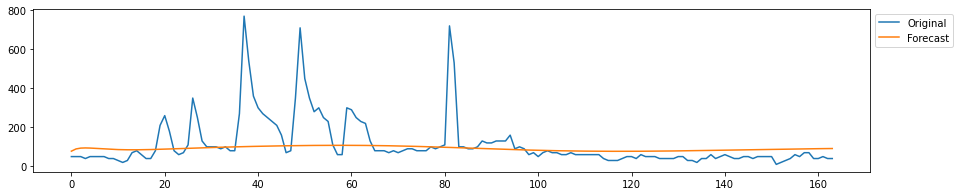

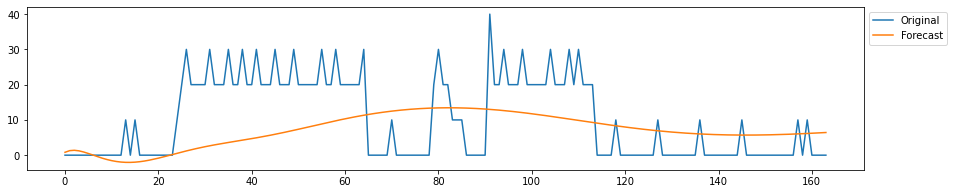

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


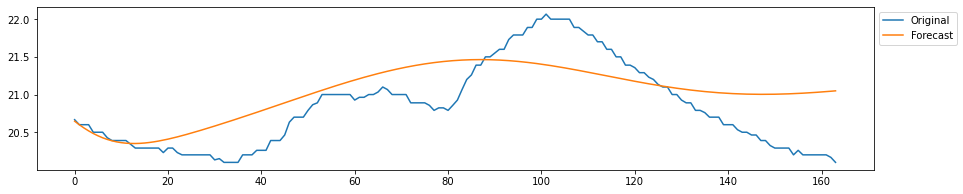

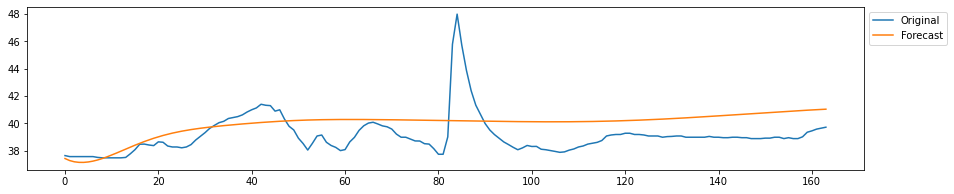

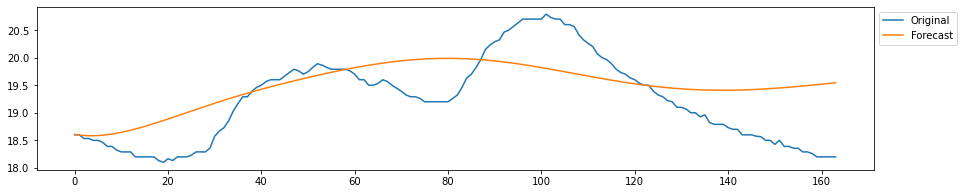

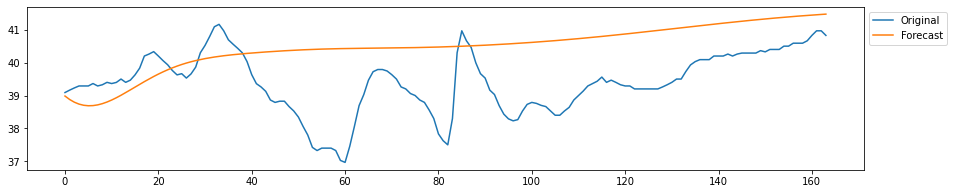

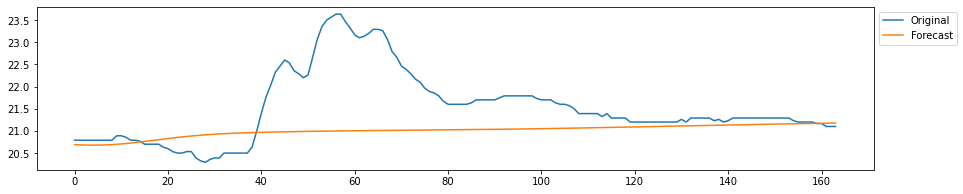

...

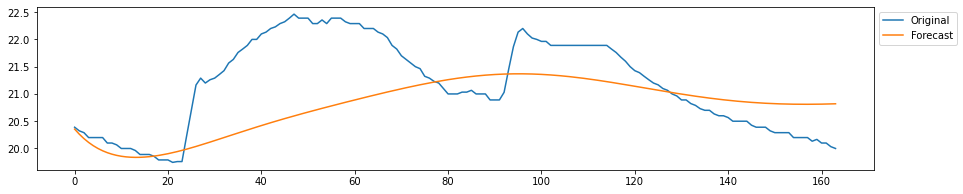

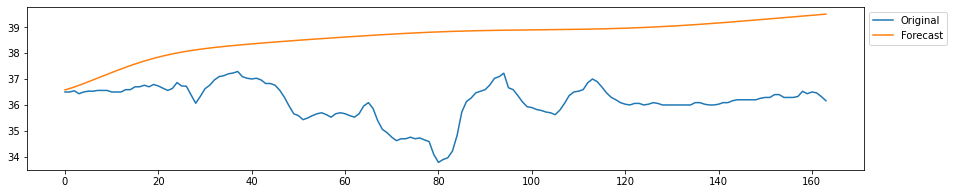

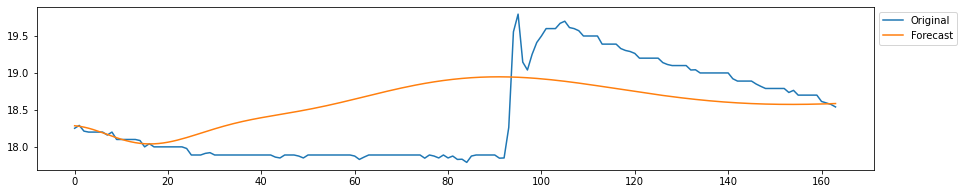

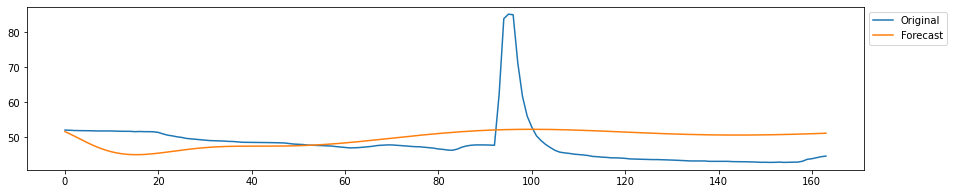

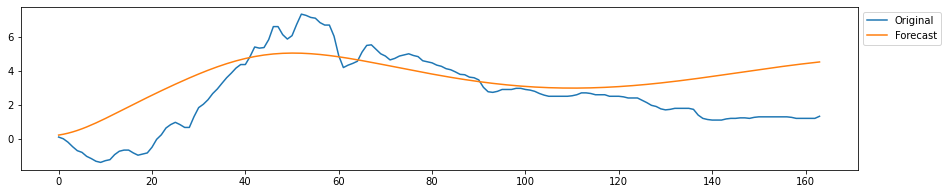

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


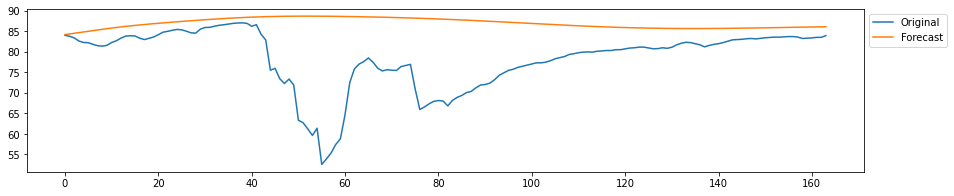

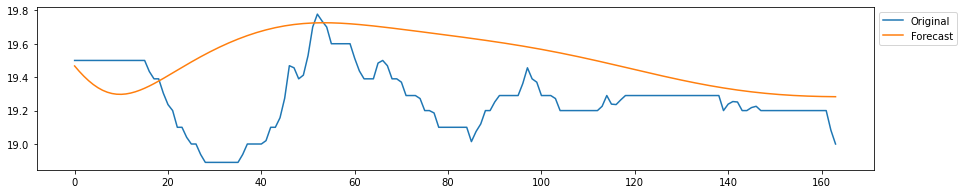

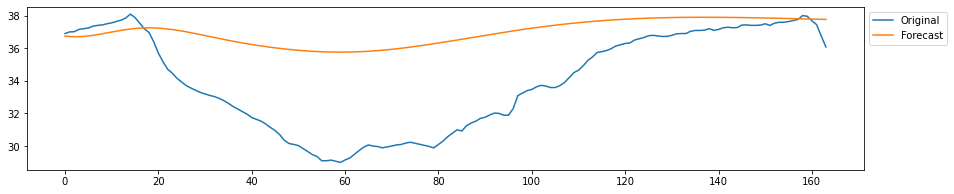

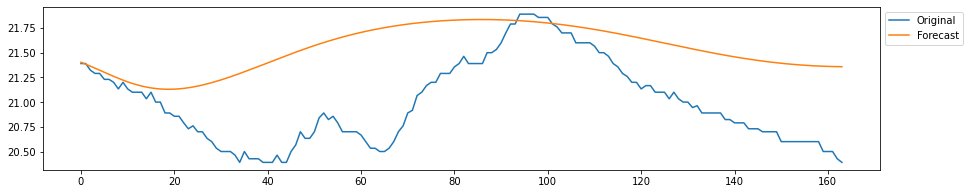

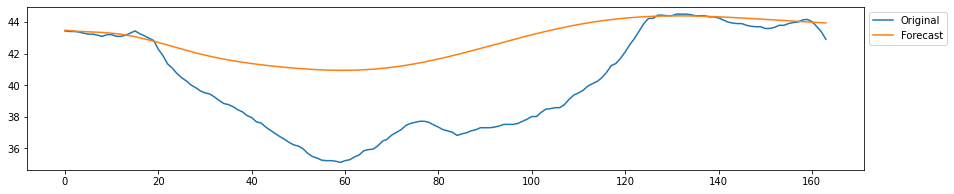

...

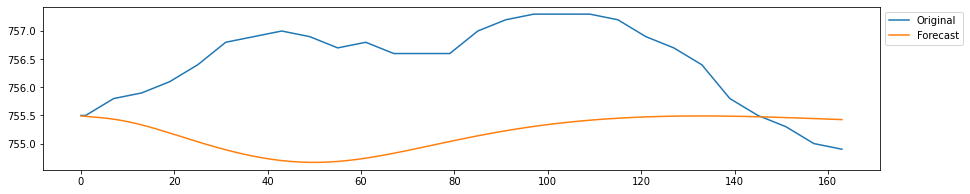

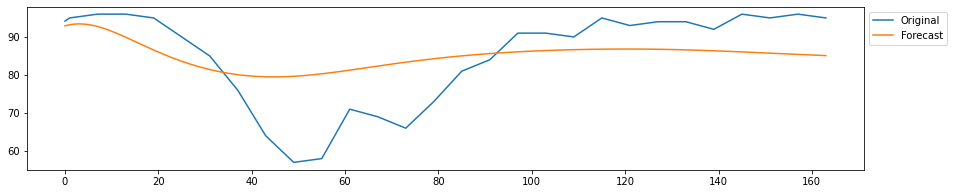

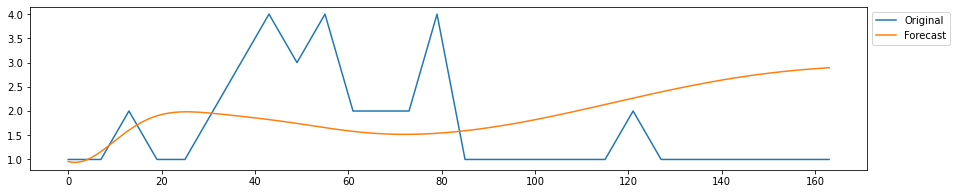

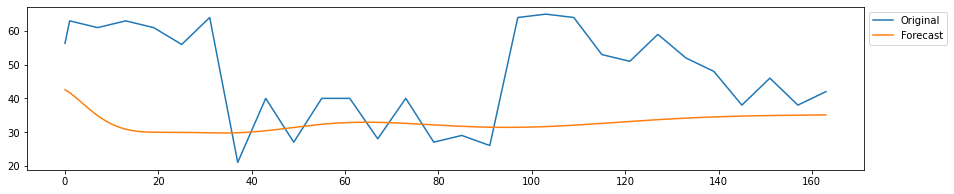

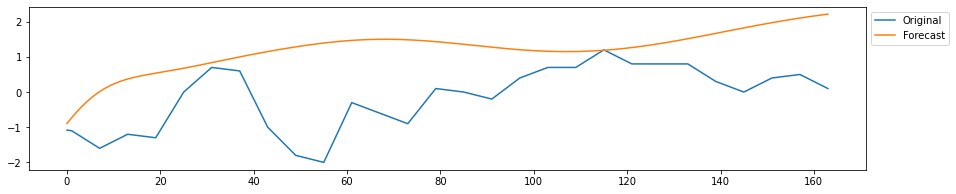

--------------------
training window 6570


/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


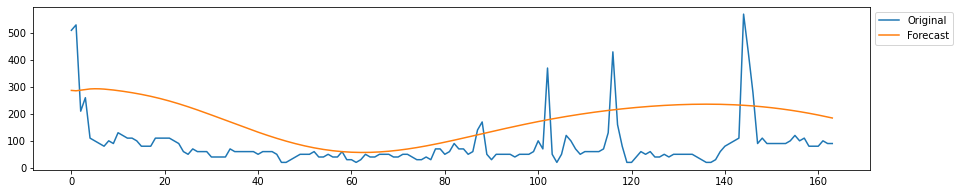

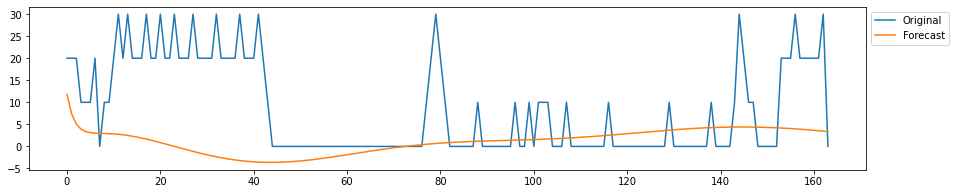

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


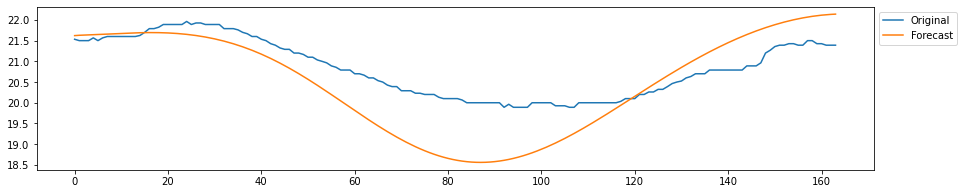

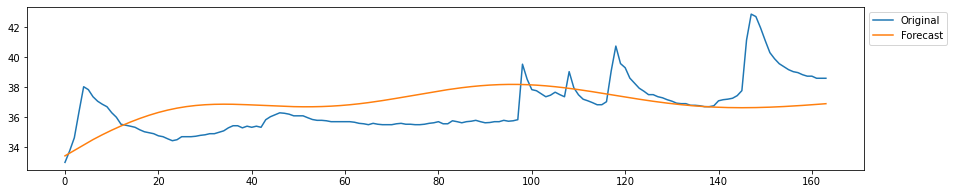

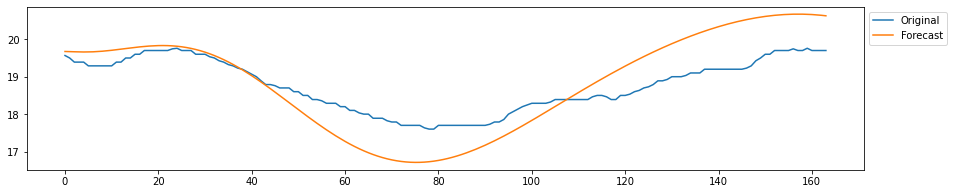

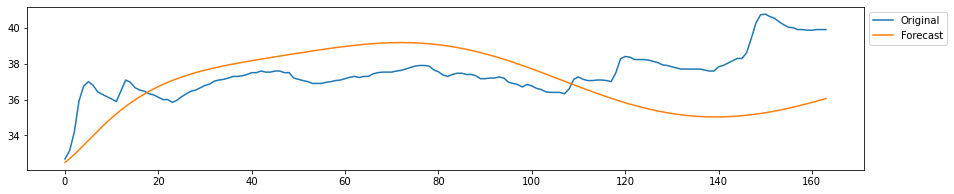

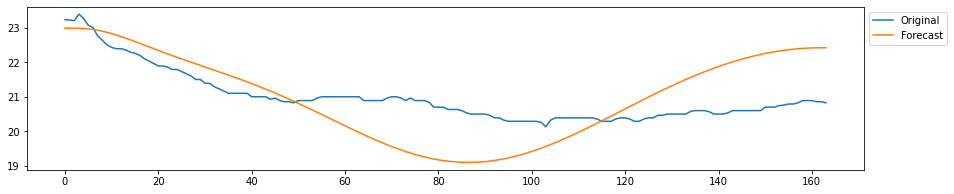

...

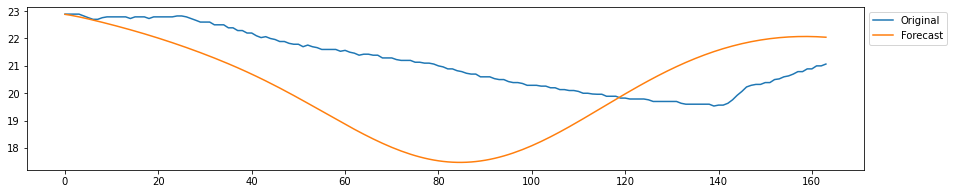

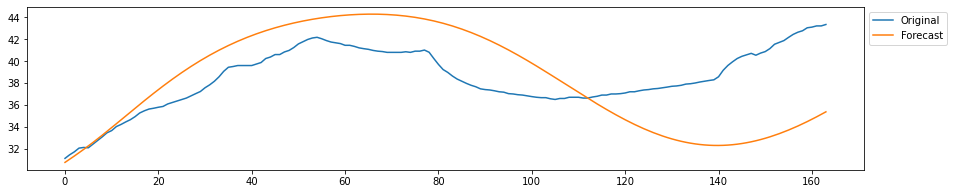

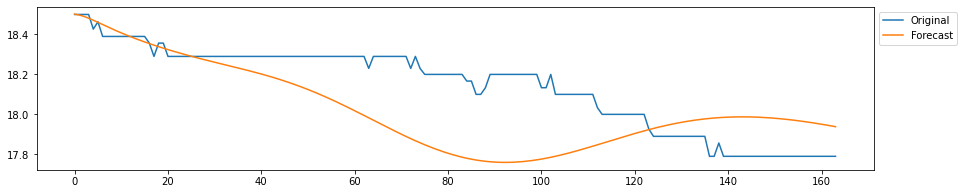

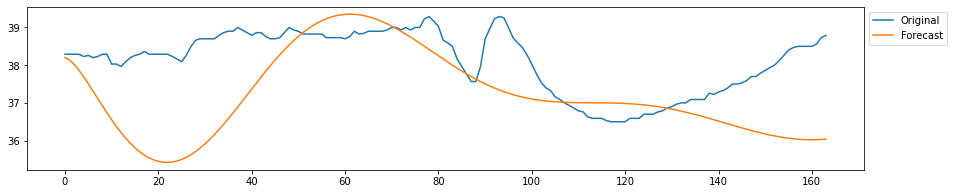

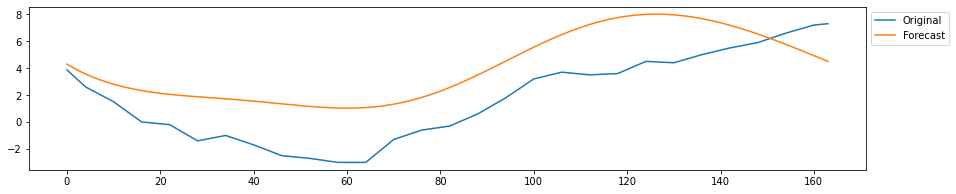

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


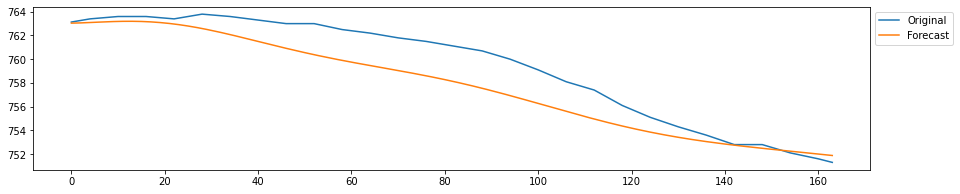

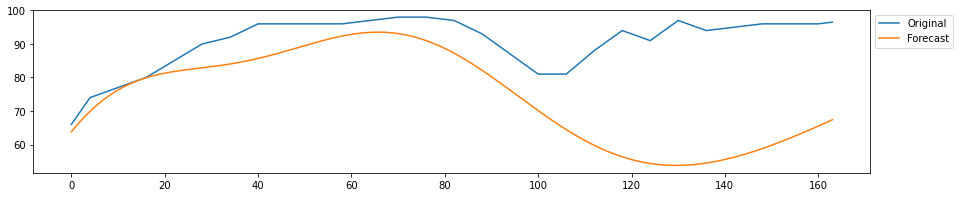

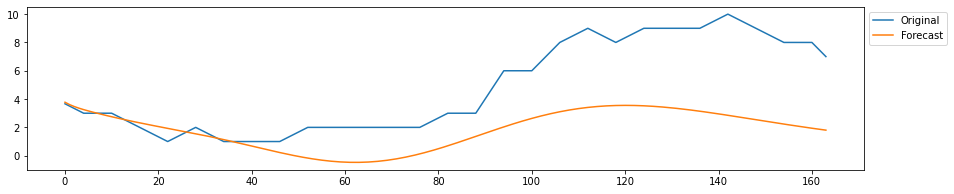

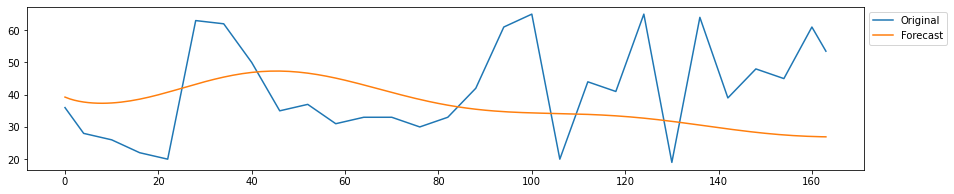

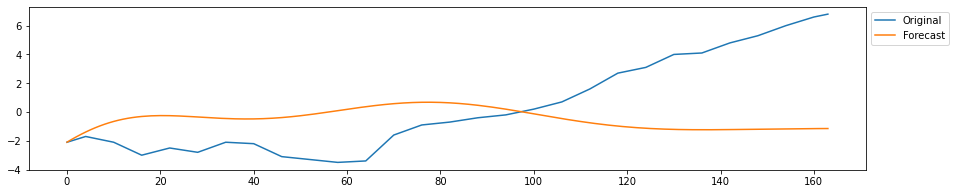

--------------------
training window 7227


/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


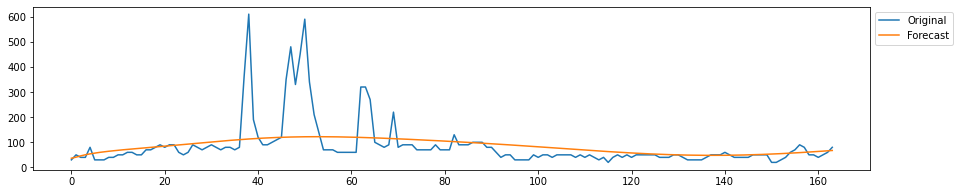

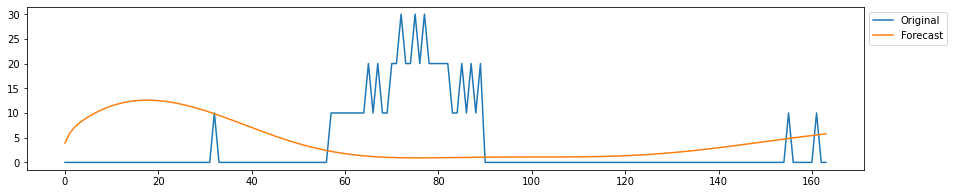

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


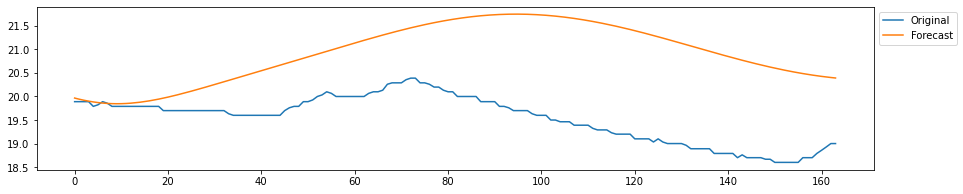

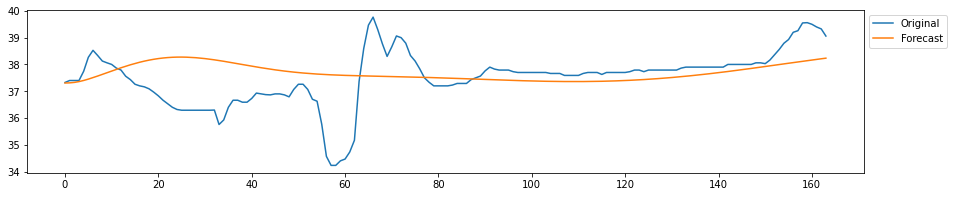

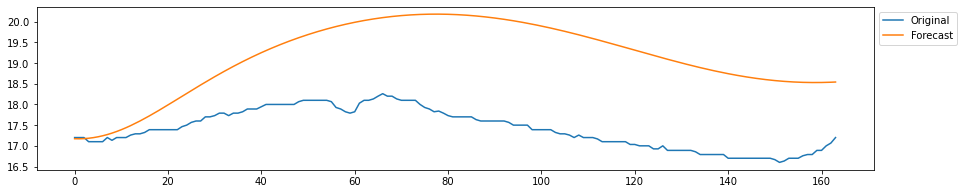

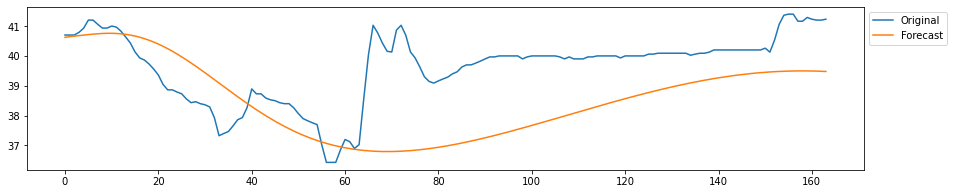

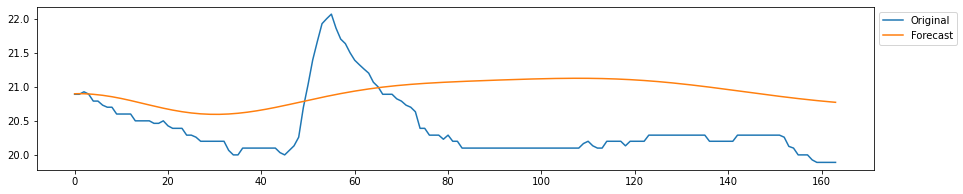

...

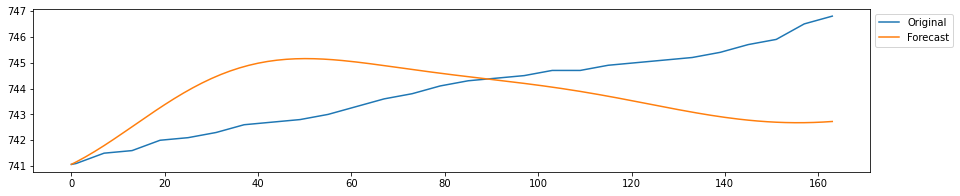

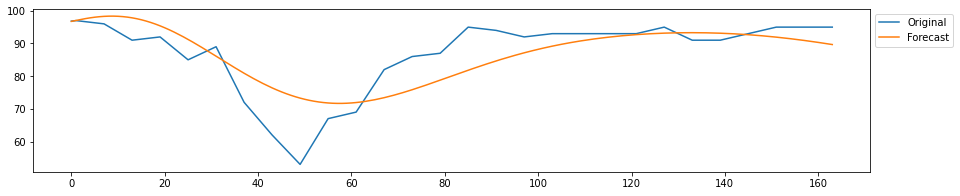

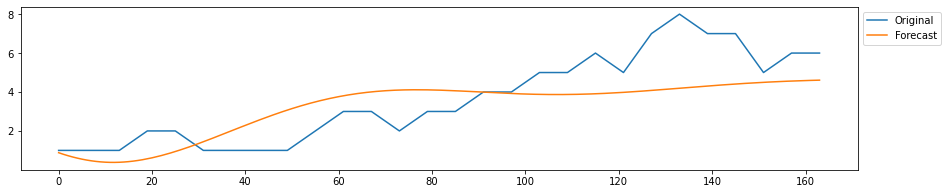

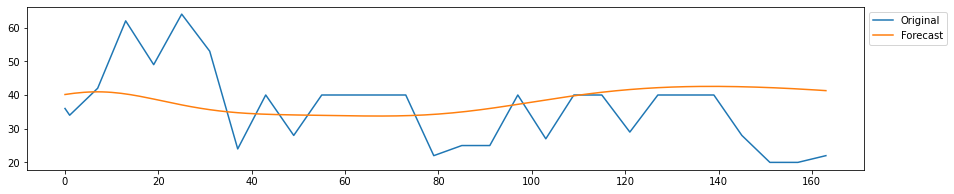

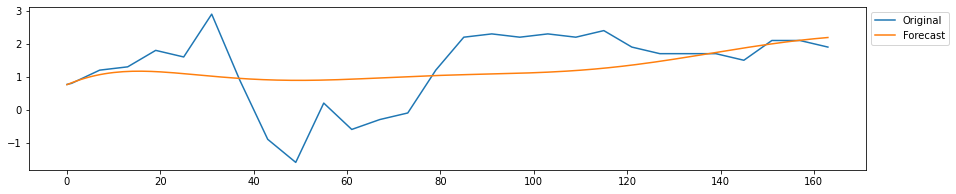

--------------------
training window 7884


/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


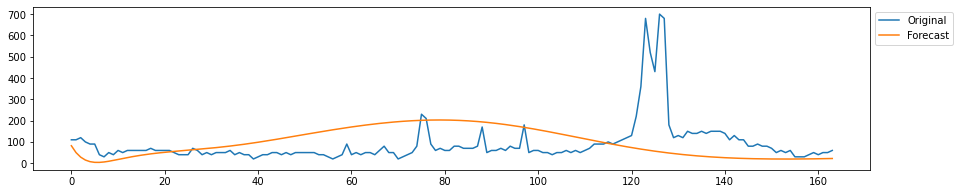

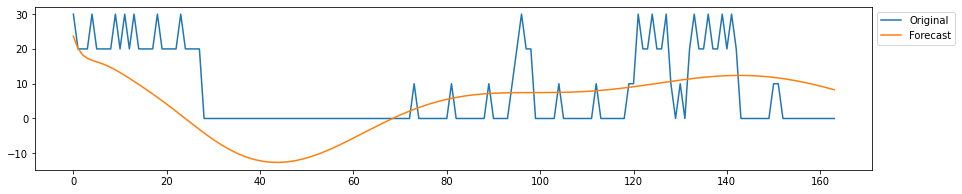

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


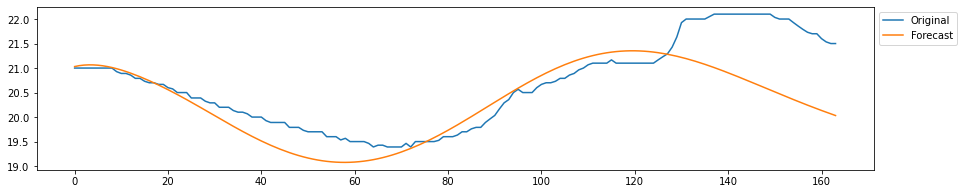

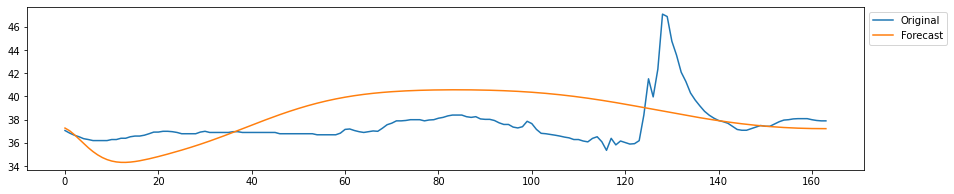

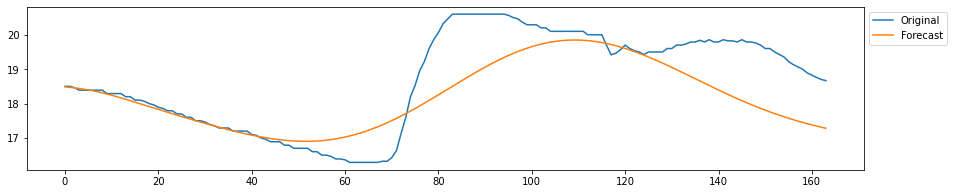

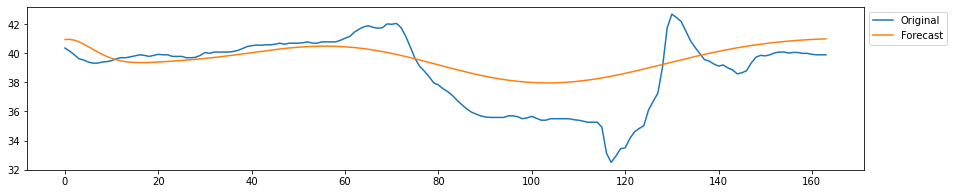

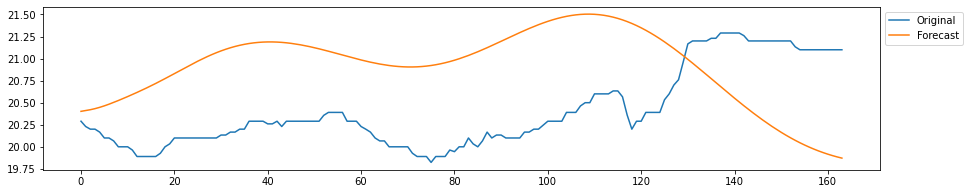

...

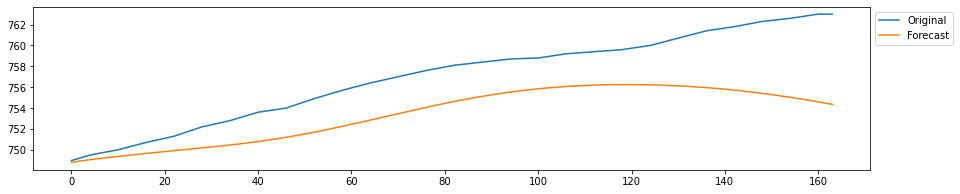

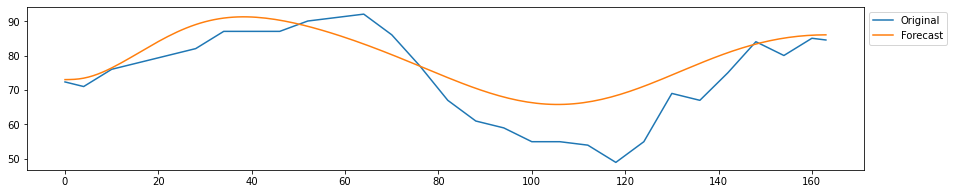

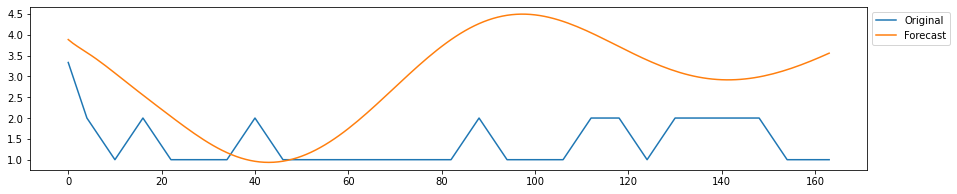

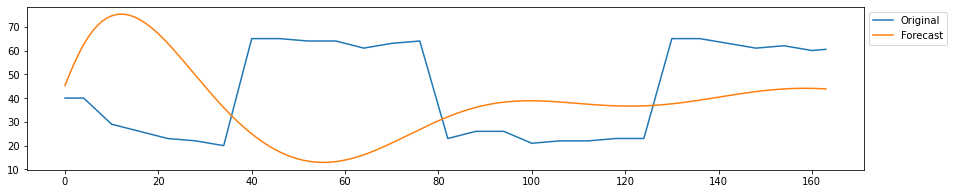

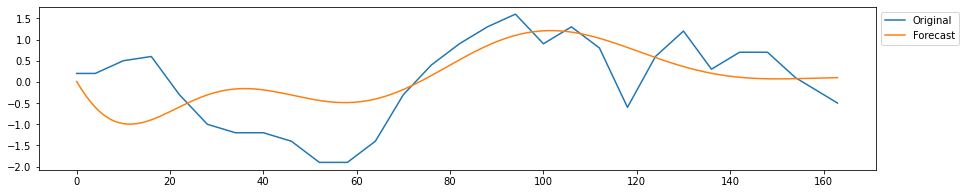

--------------------
training window 8541


/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


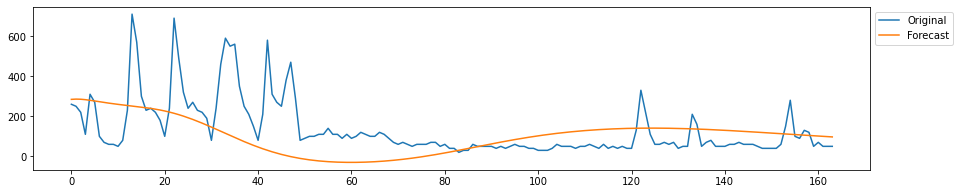

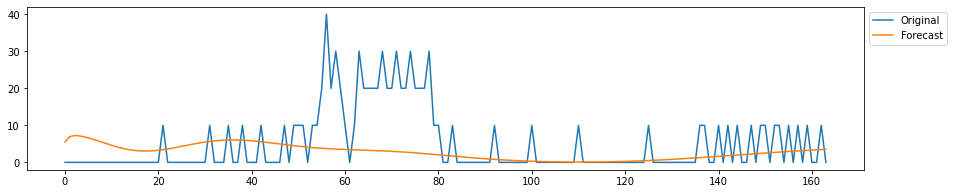

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


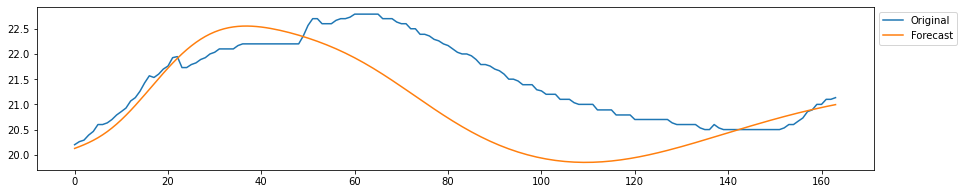

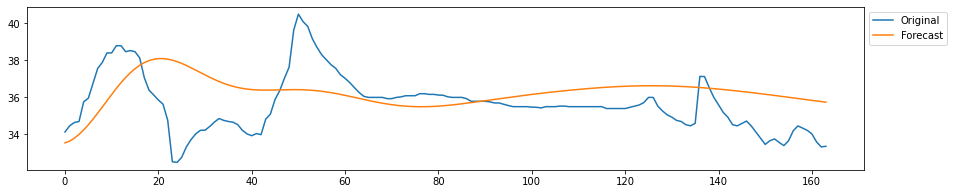

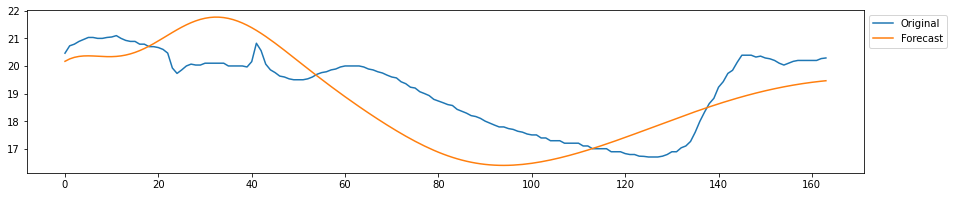

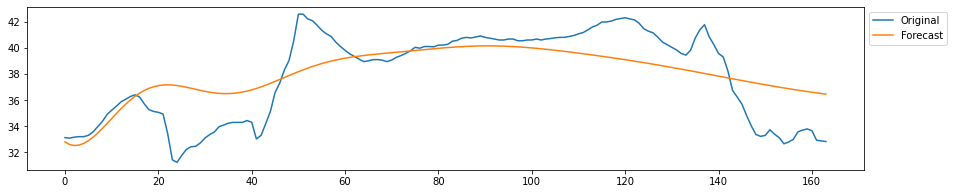

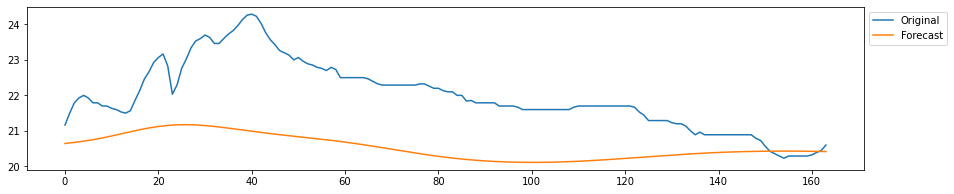

...

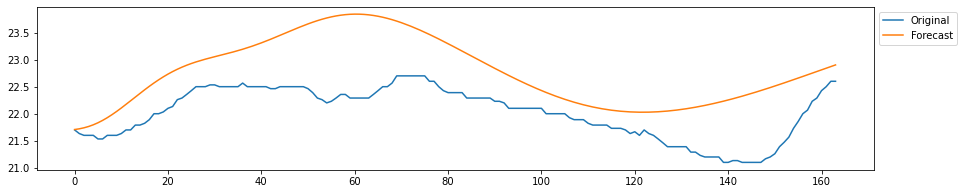

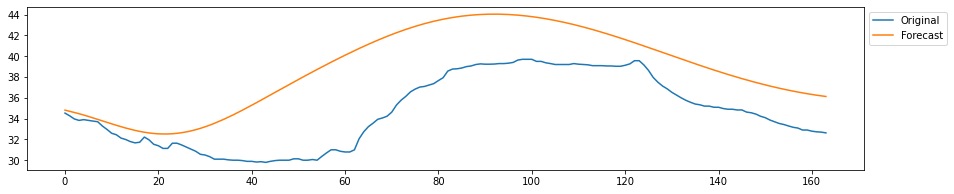

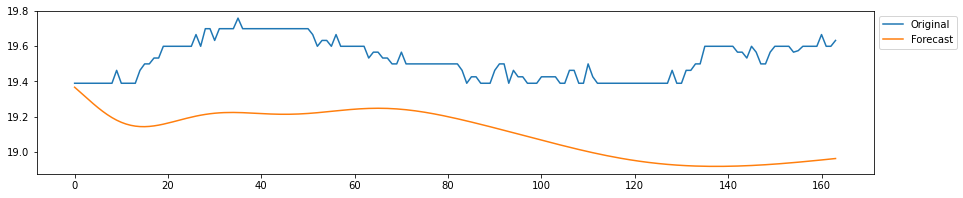

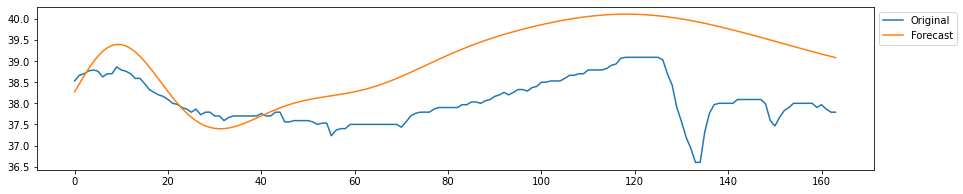

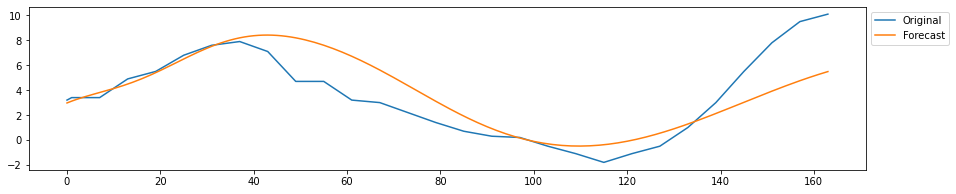

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


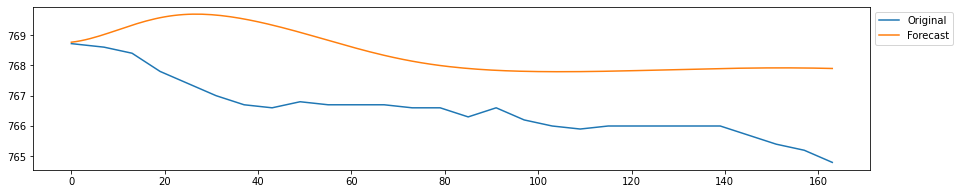

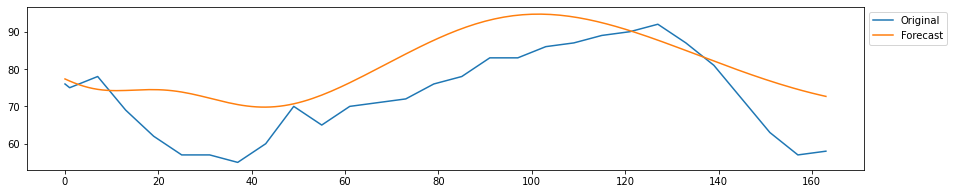

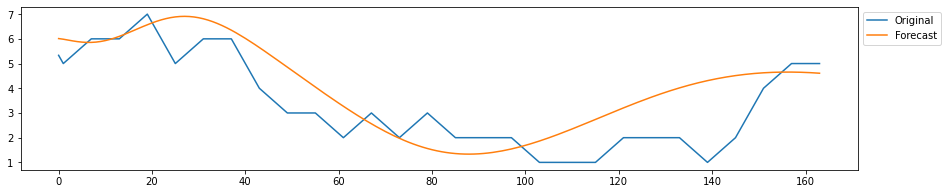

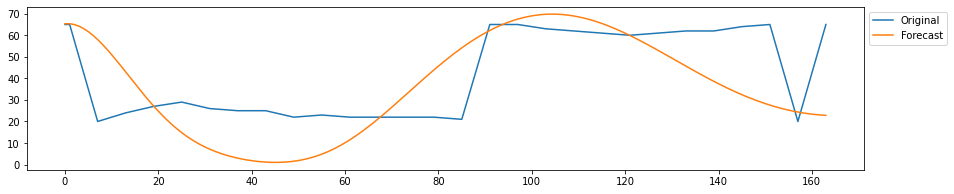

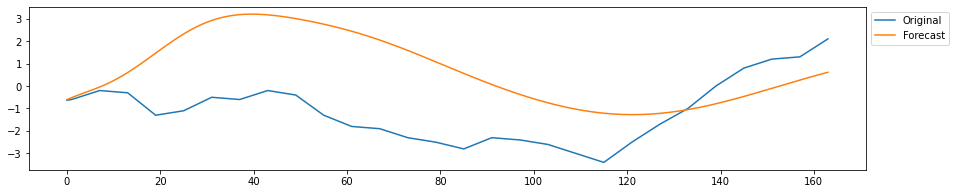

--------------------
training window 9198


/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


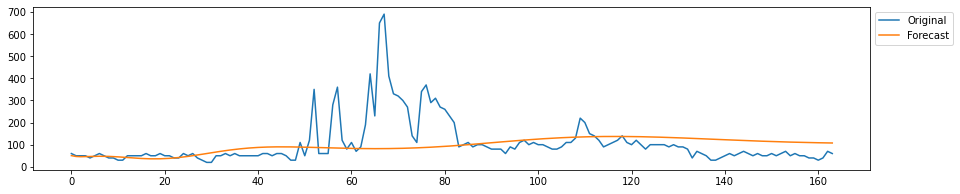

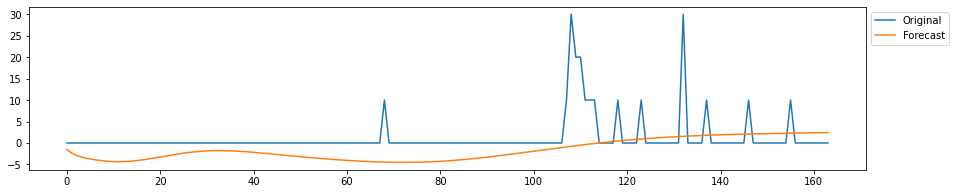

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


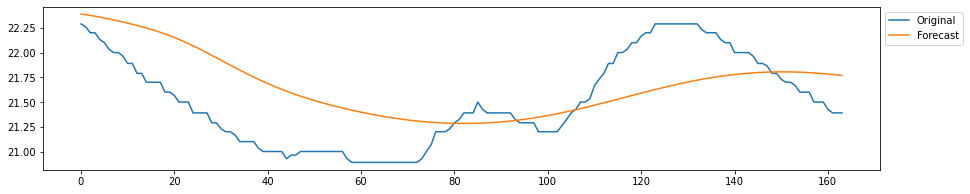

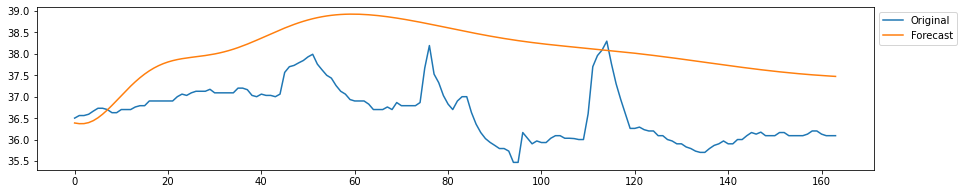

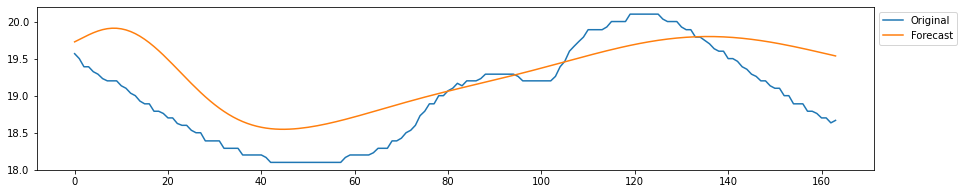

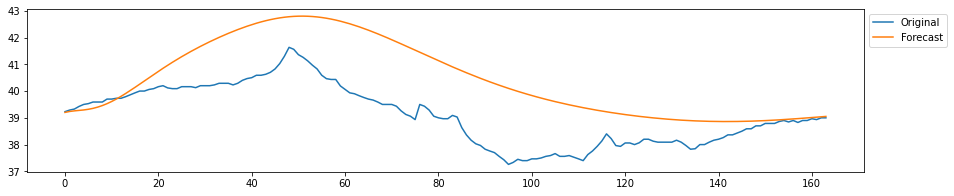

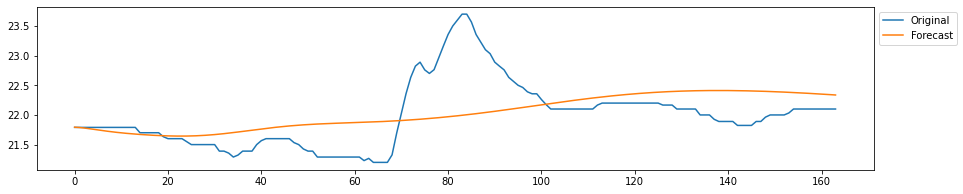

...

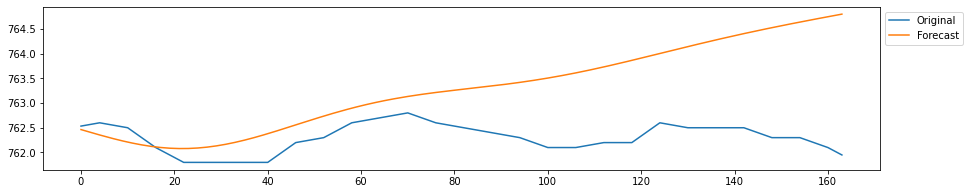

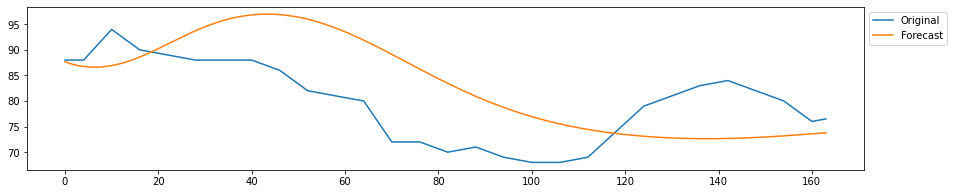

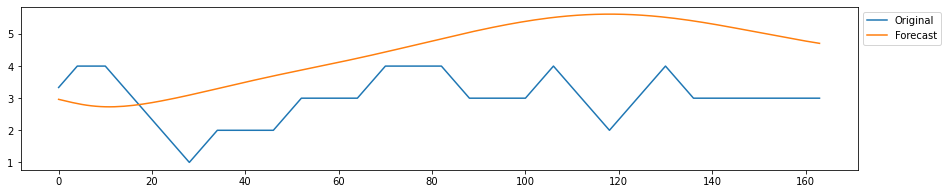

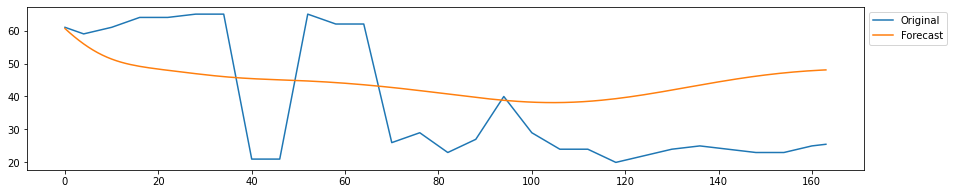

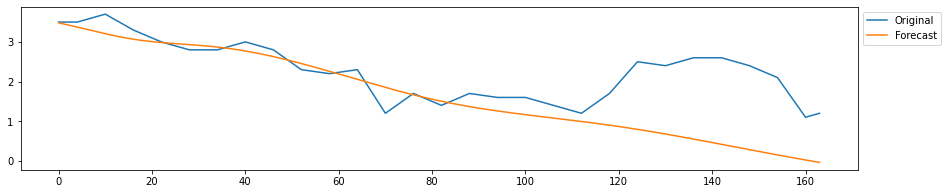

--------------------
training window 9855


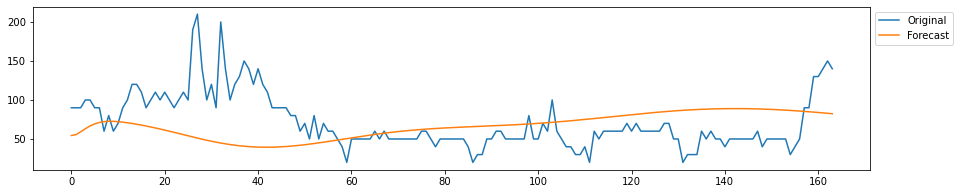

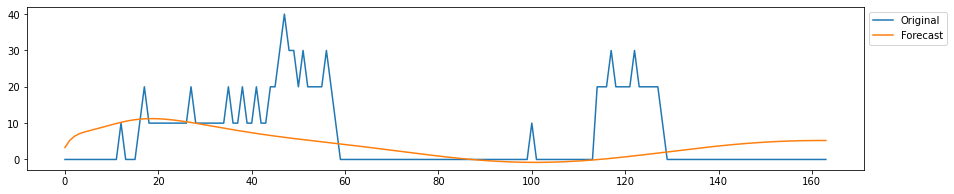

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


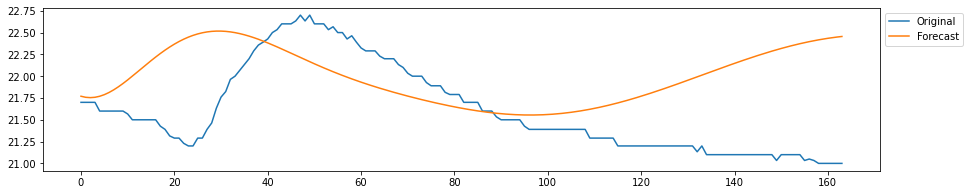

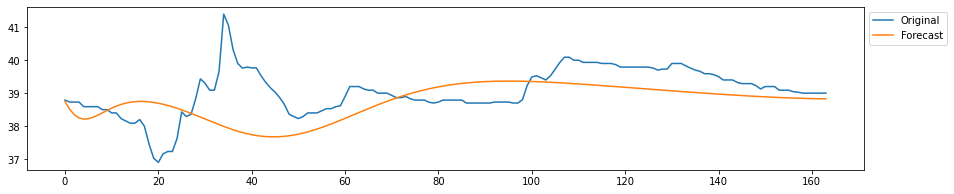

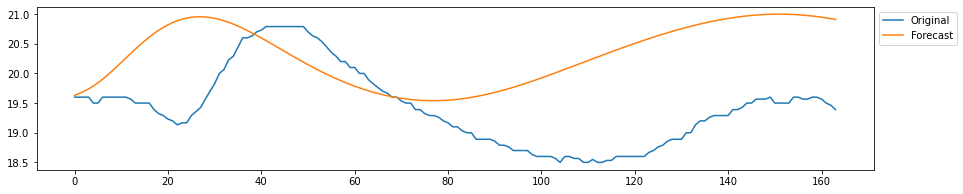

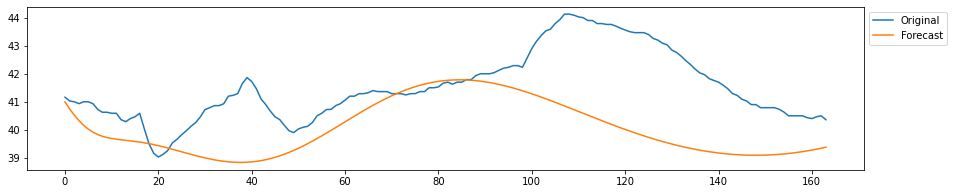

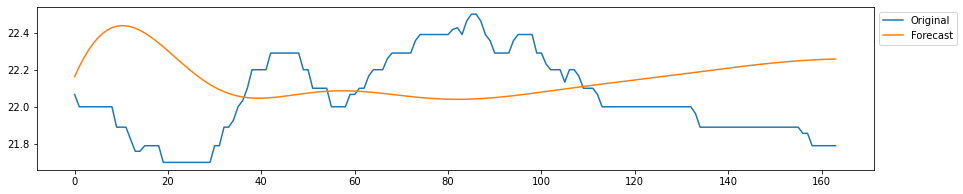

...

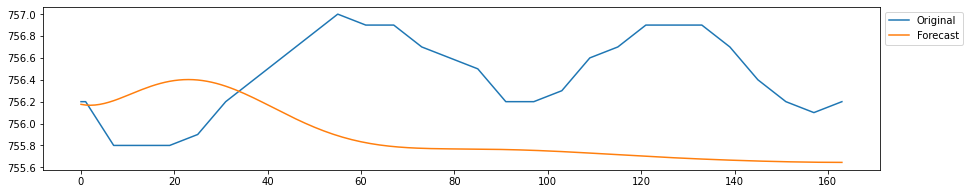

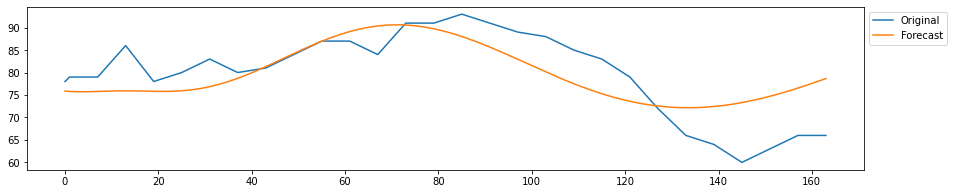

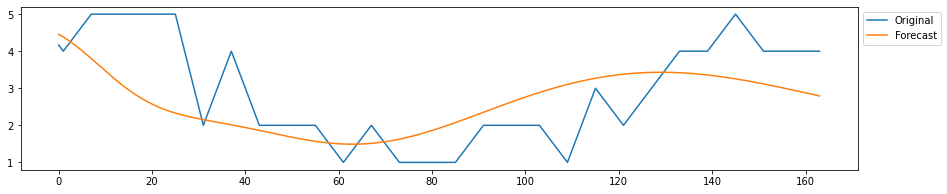

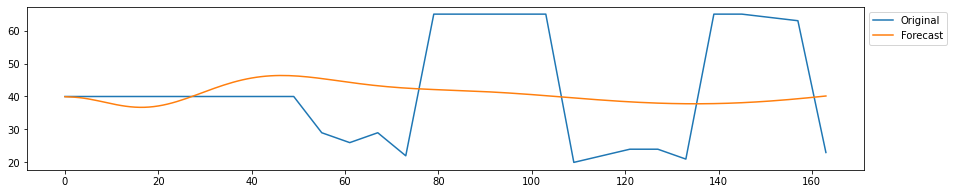

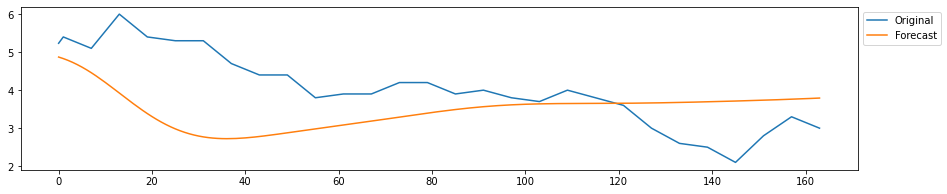

--------------------
training window 10512


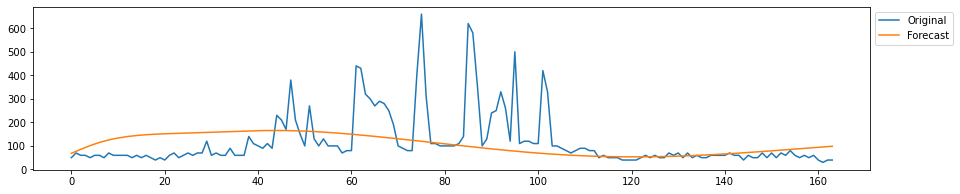

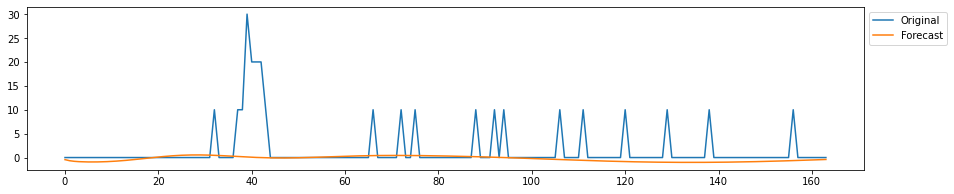

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


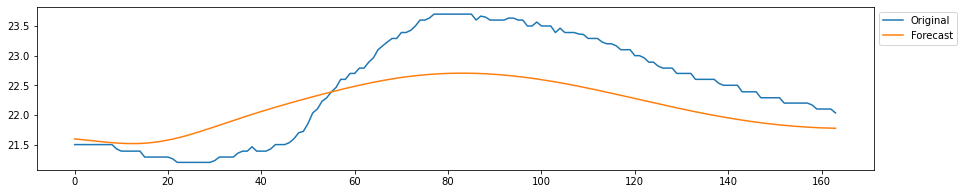

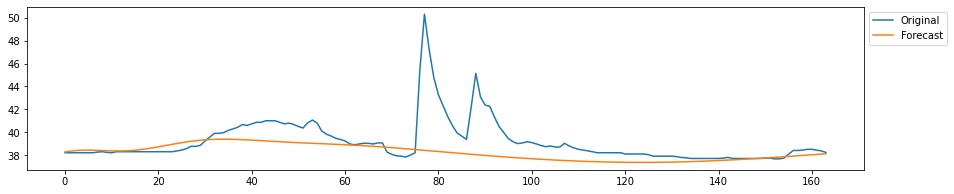

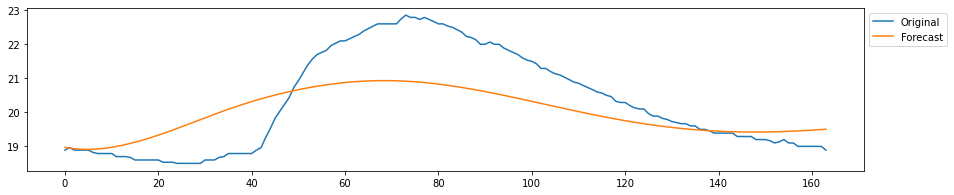

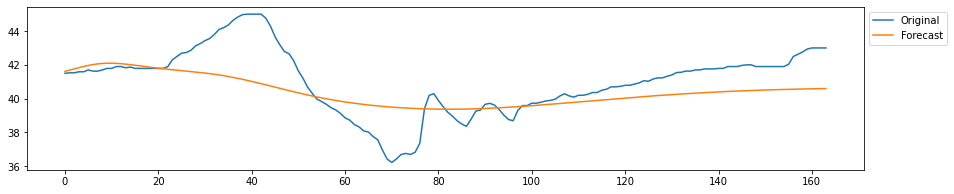

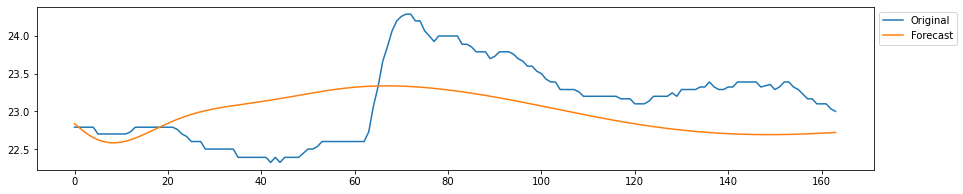

...

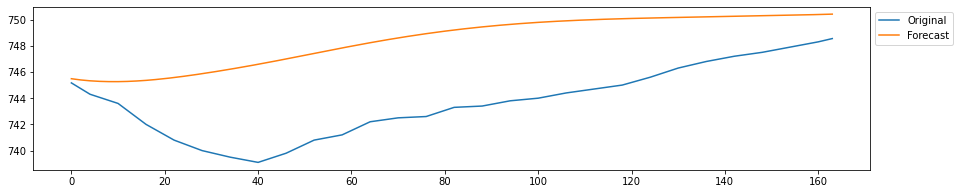

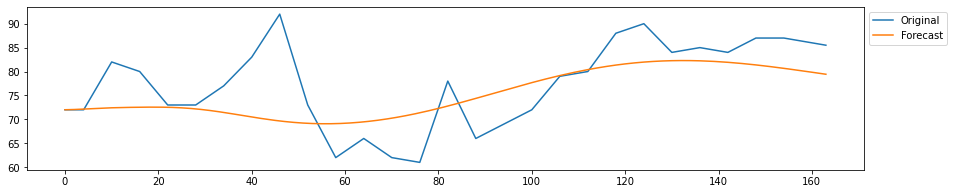

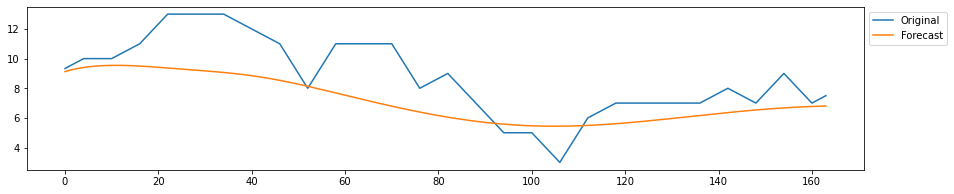

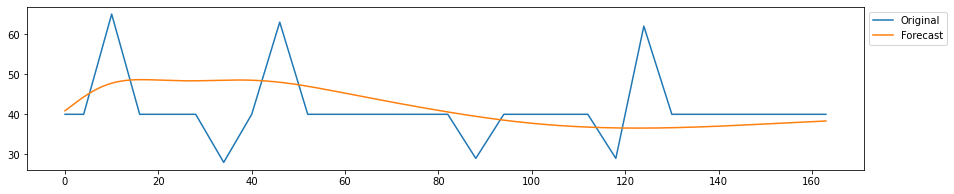

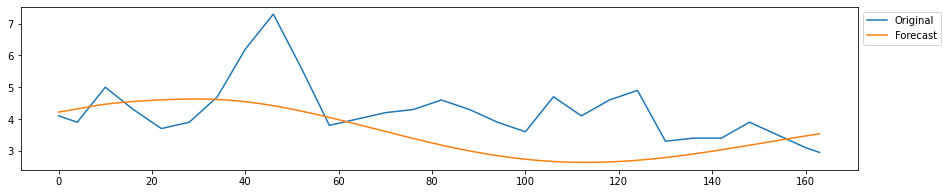

--------------------
training window 11169


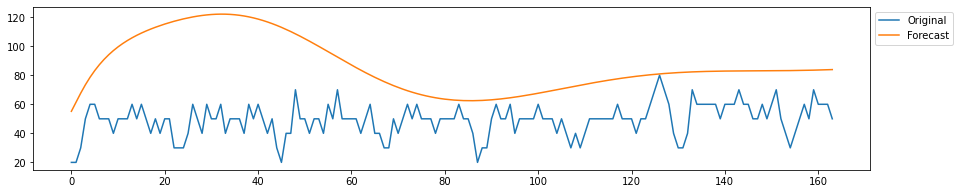

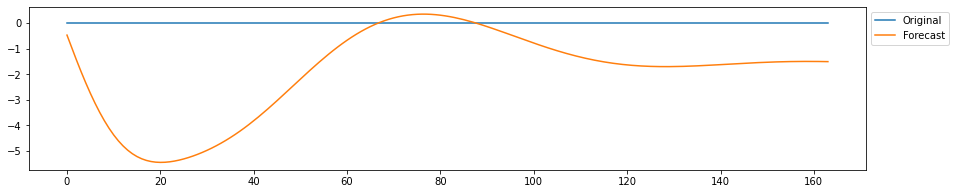

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100
<ipython-input-10-1be783193a86>:3: RuntimeWarning: divide by zero encountered in double_scalars
  return (rmse/x)


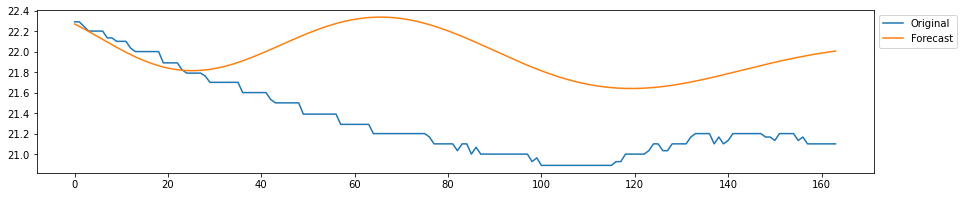

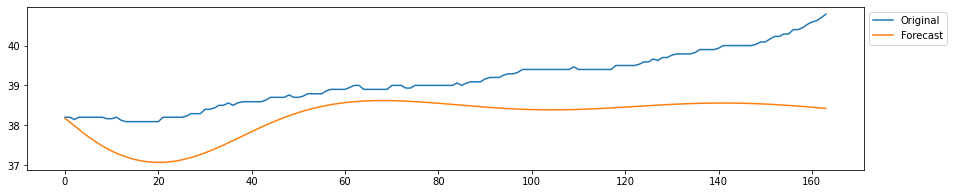

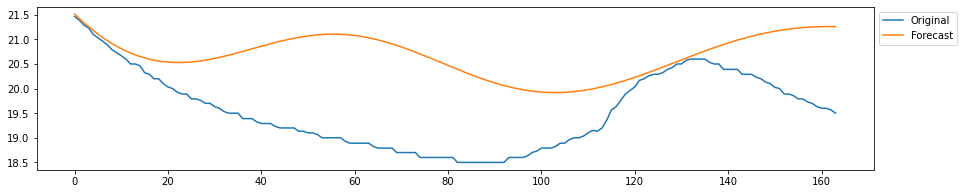

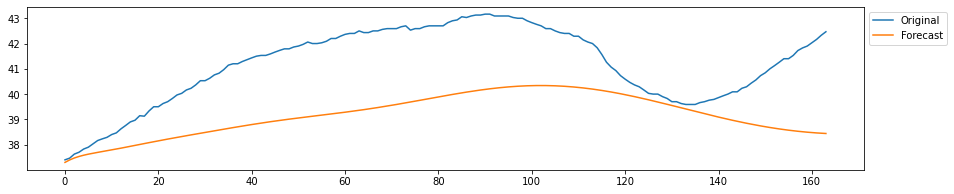

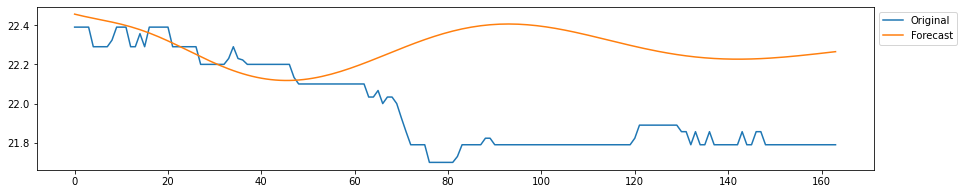

...

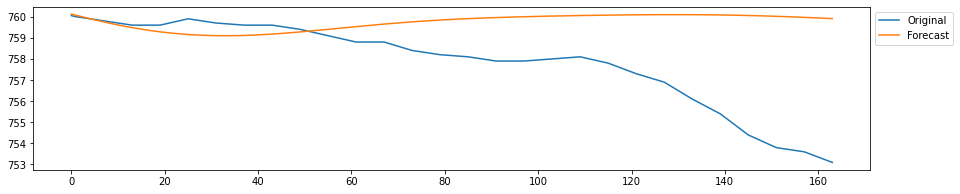

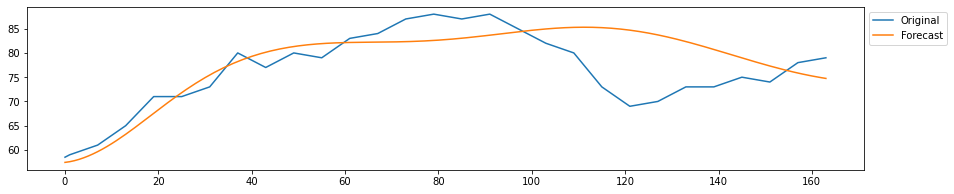

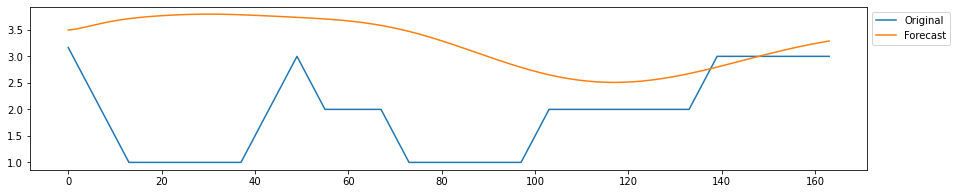

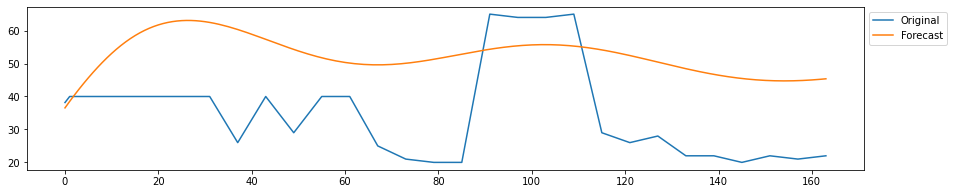

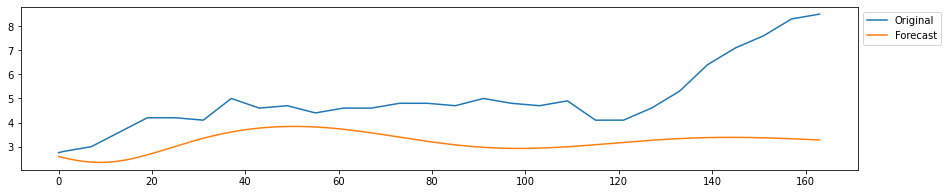

--------------------
training window 11826


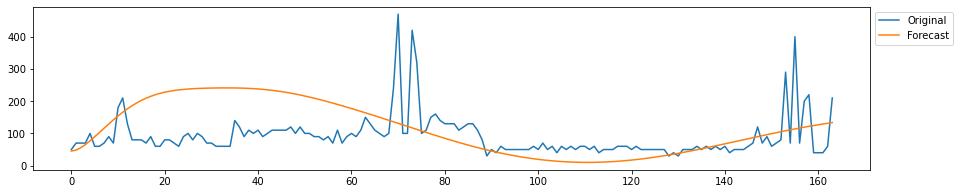

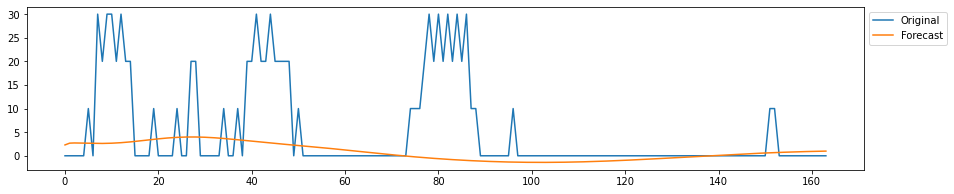

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


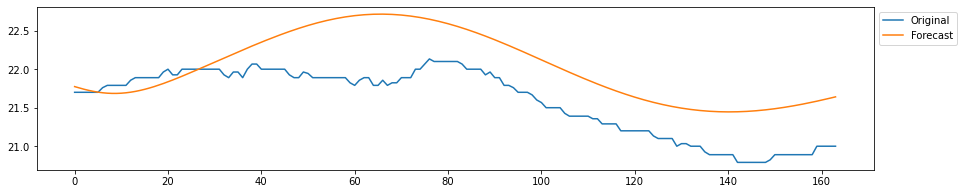

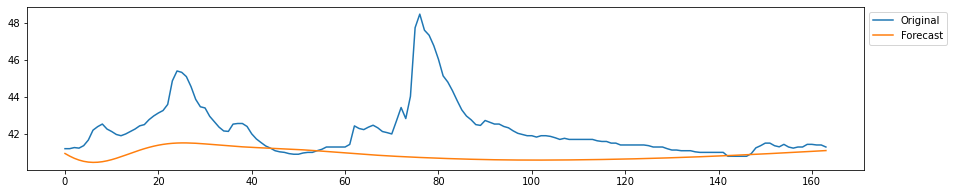

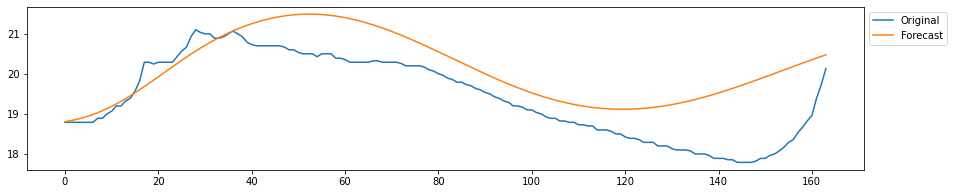

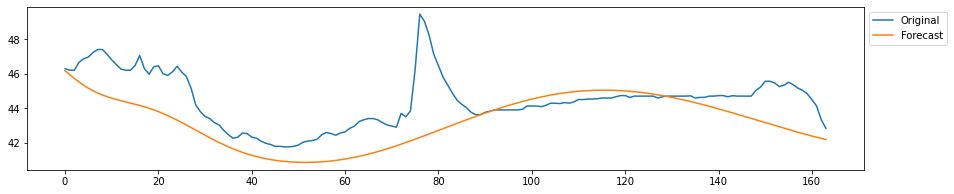

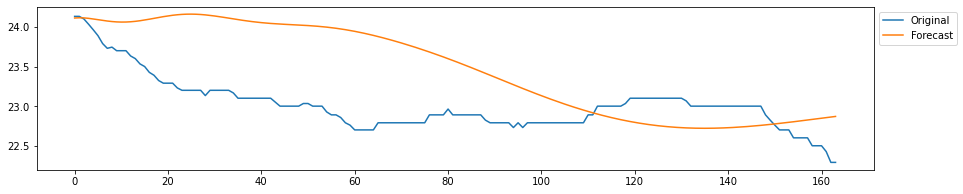

...

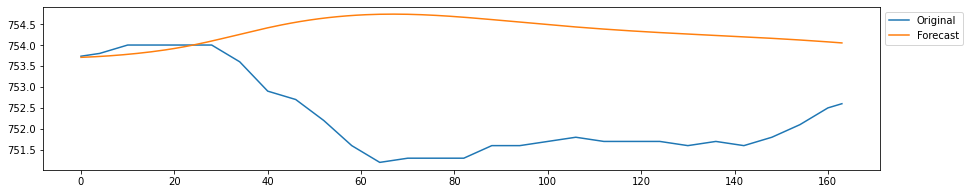

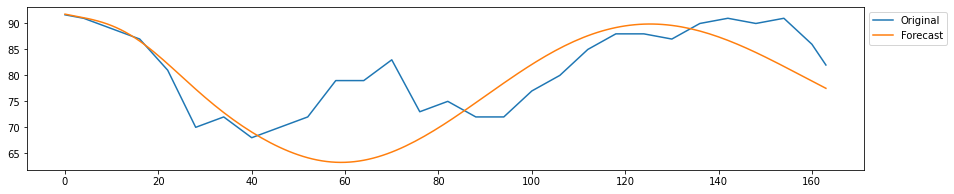

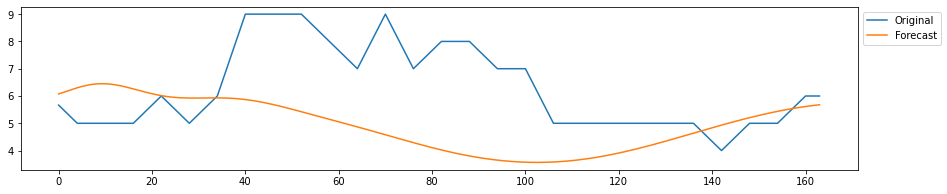

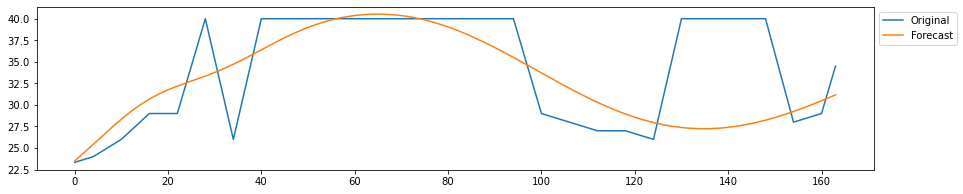

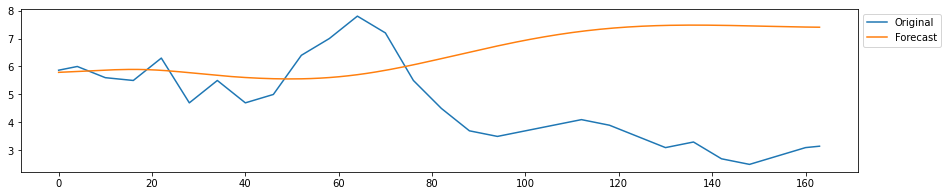

--------------------
training window 12483


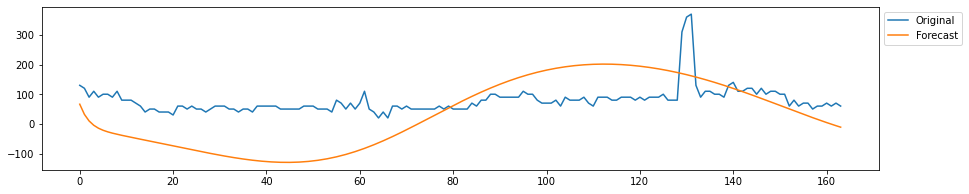

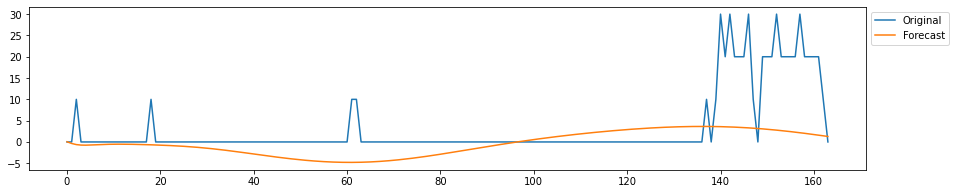

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


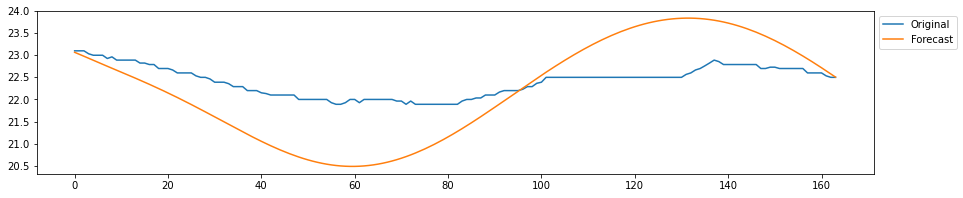

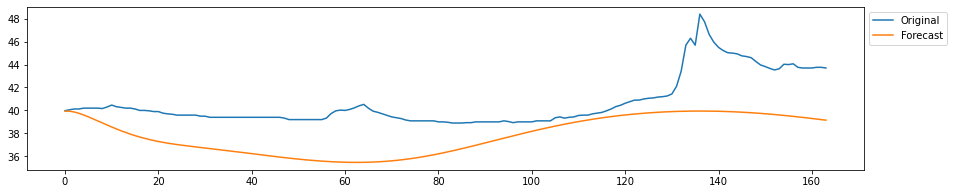

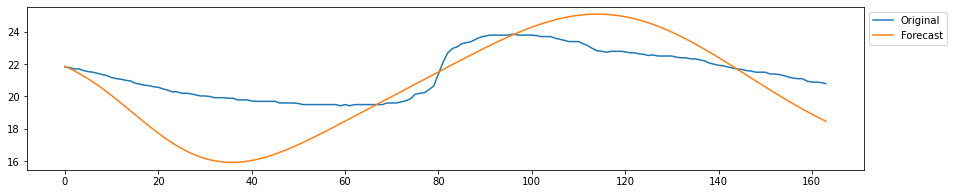

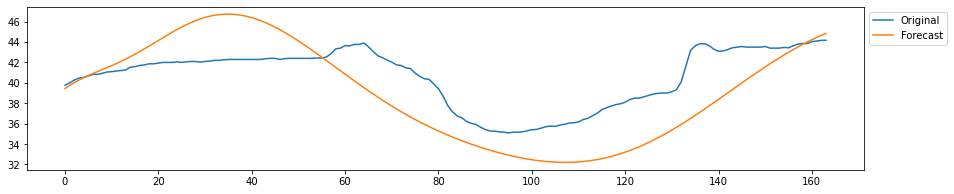

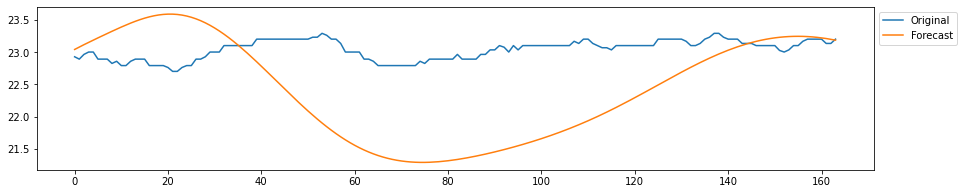

...

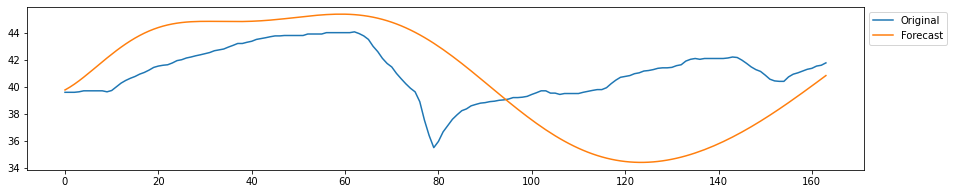

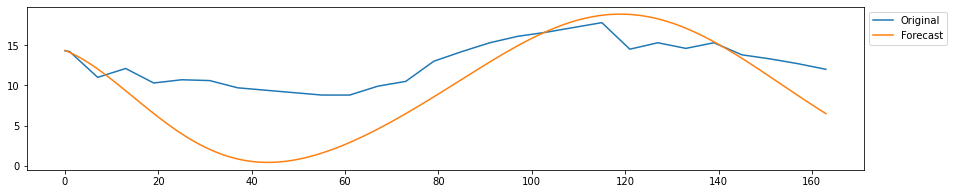

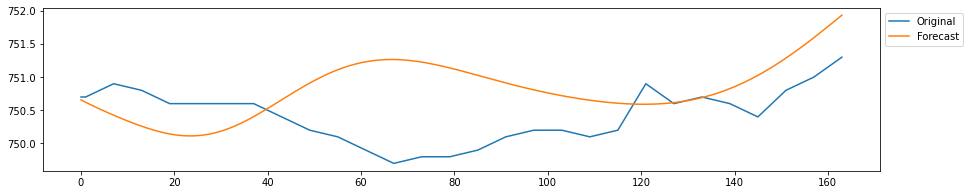

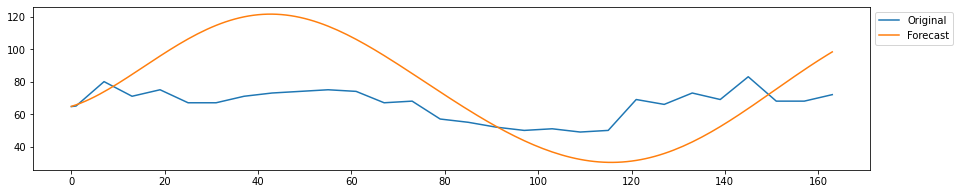

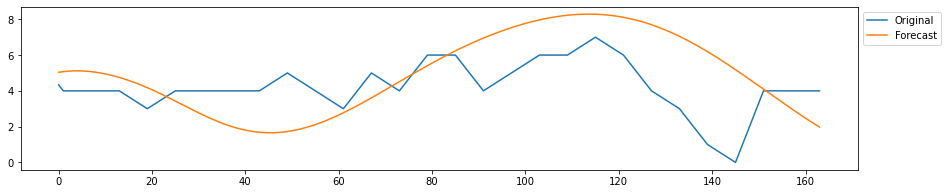

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


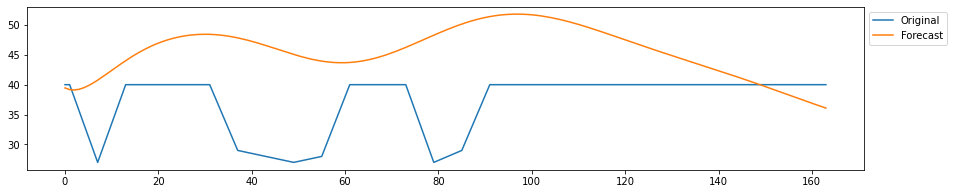

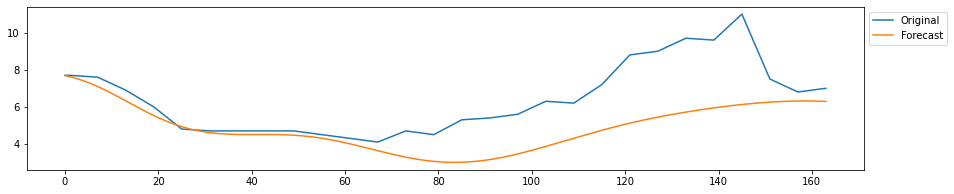

--------------------
training window 13140


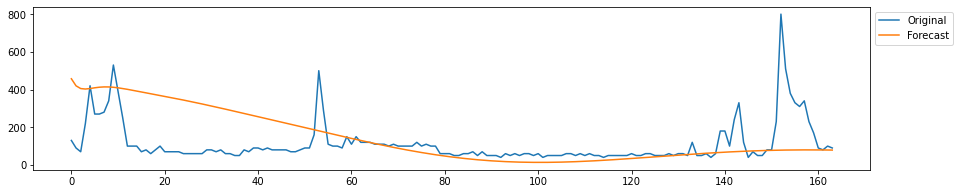

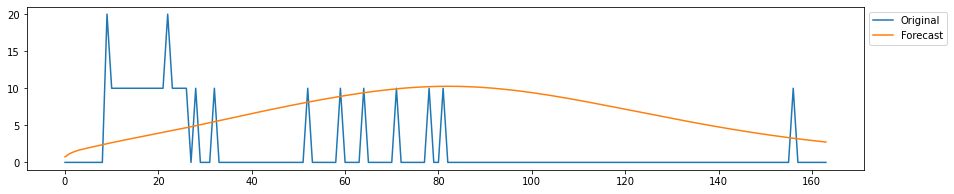

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


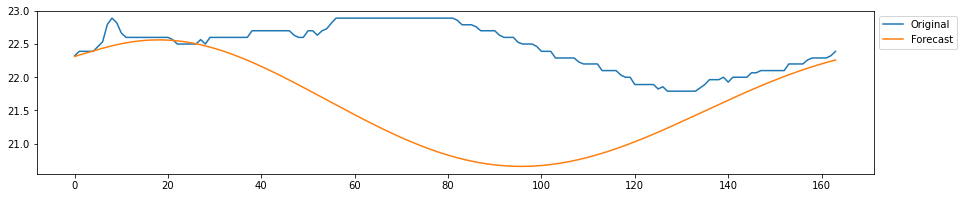

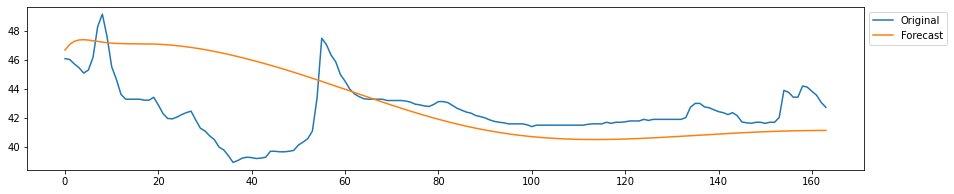

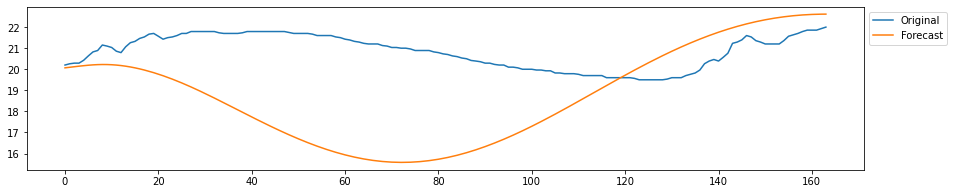

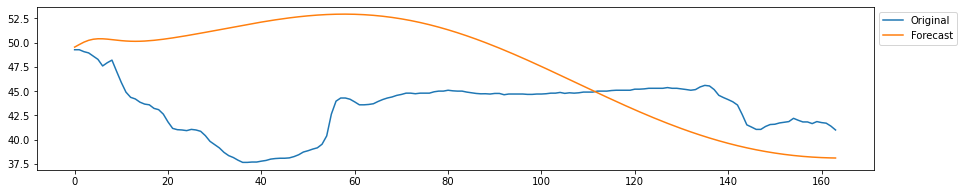

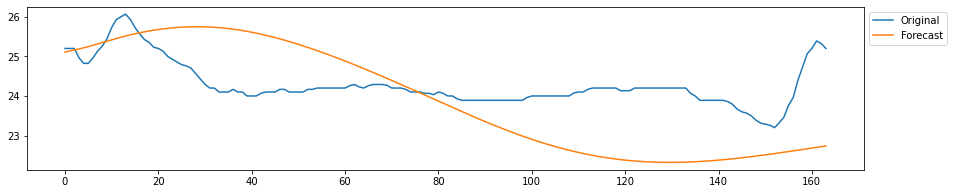

...

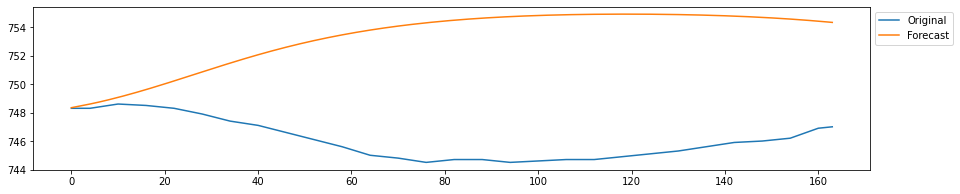

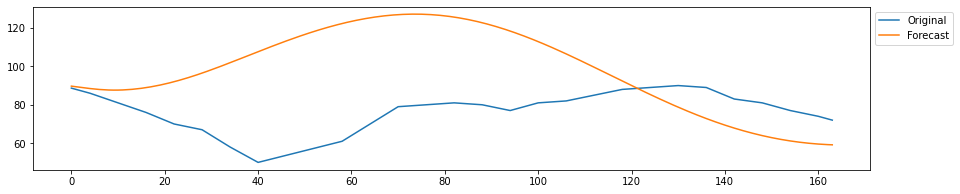

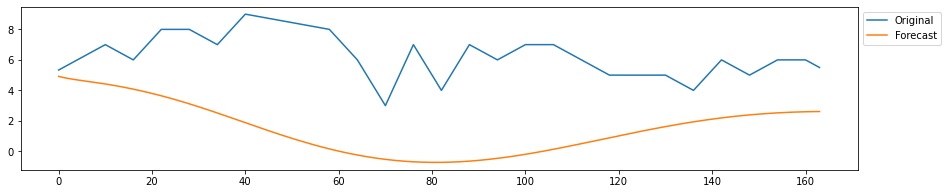

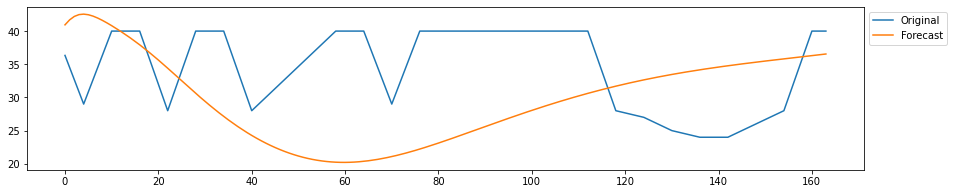

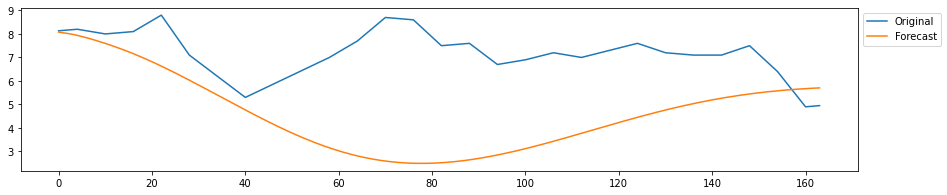

--------------------
training window 13797


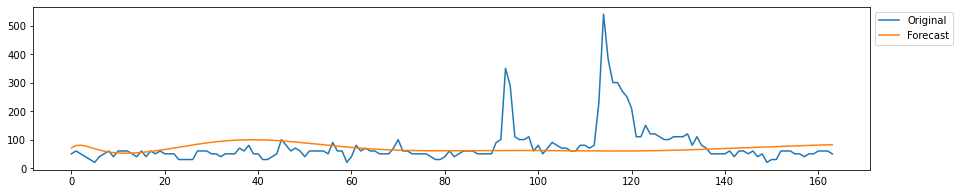

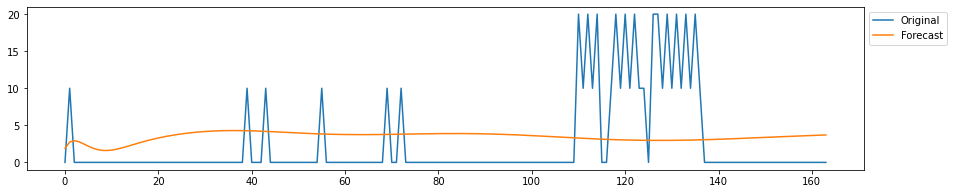

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


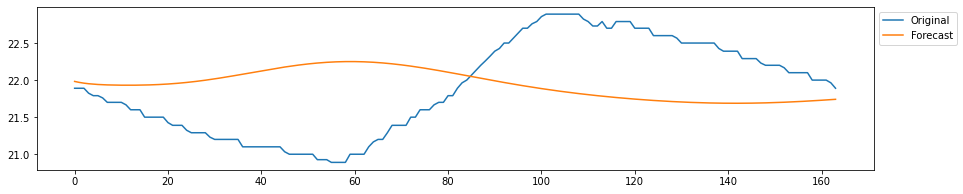

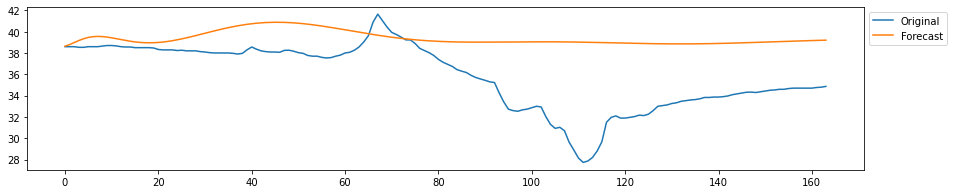

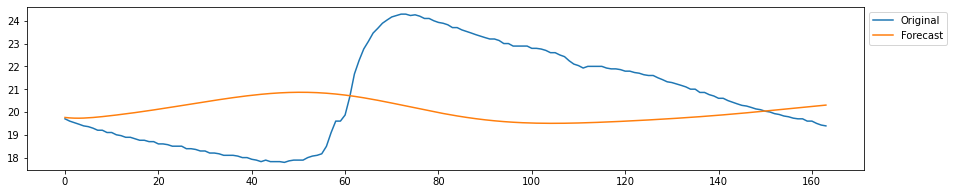

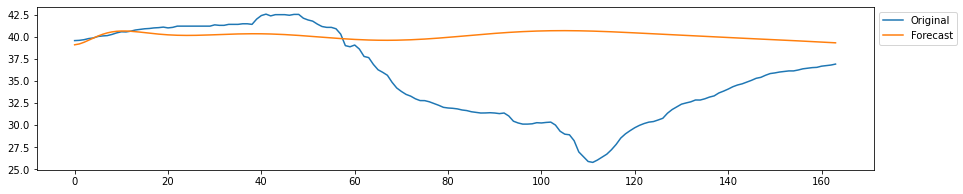

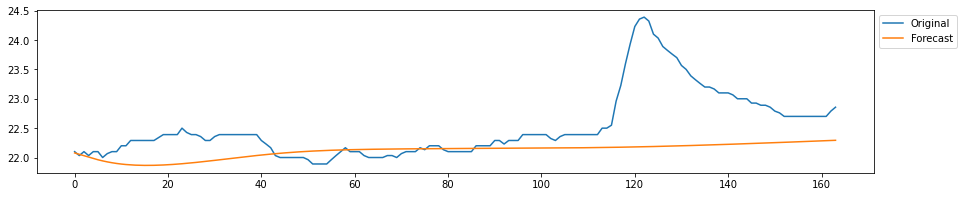

...

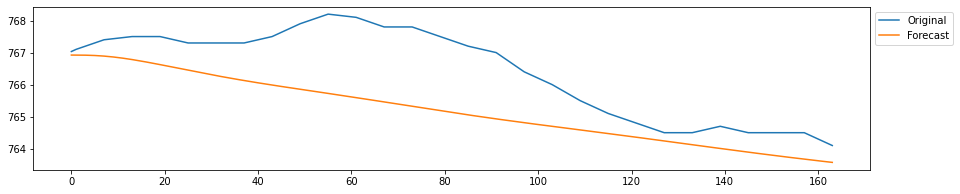

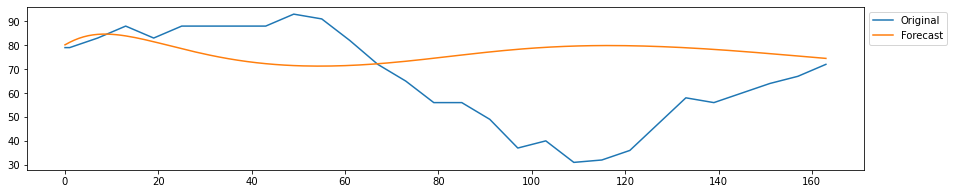

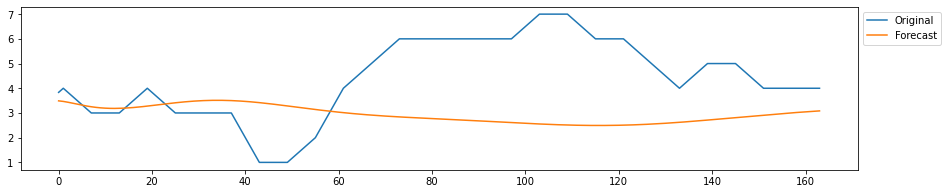

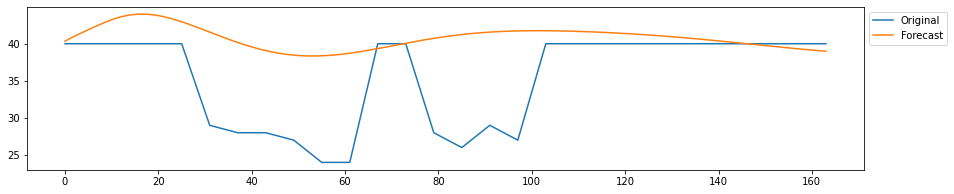

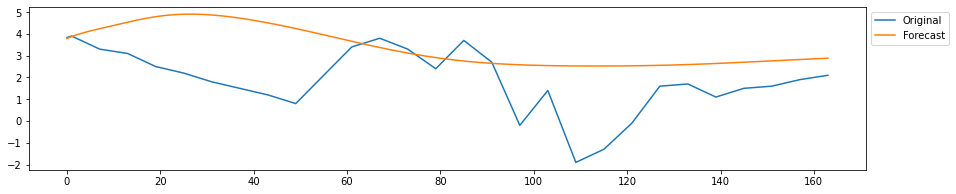

--------------------
training window 14454


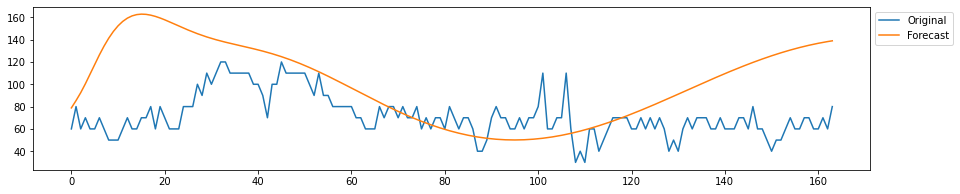

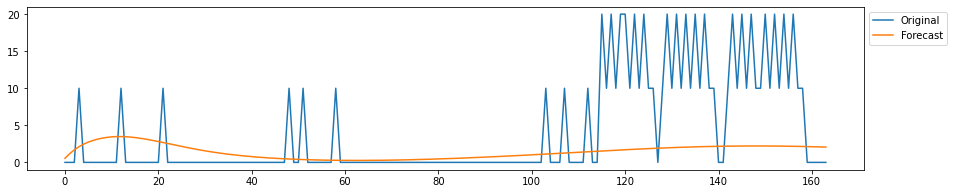

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


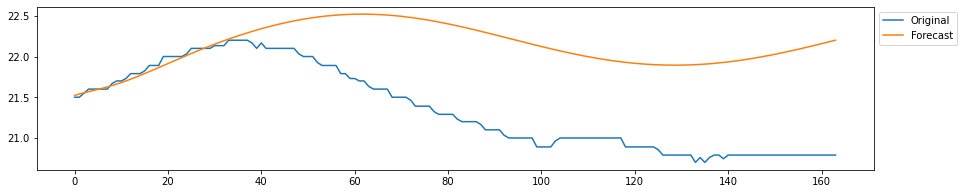

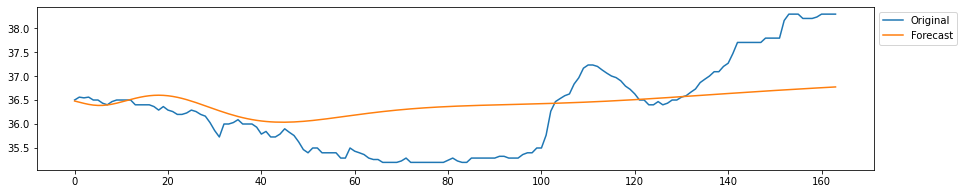

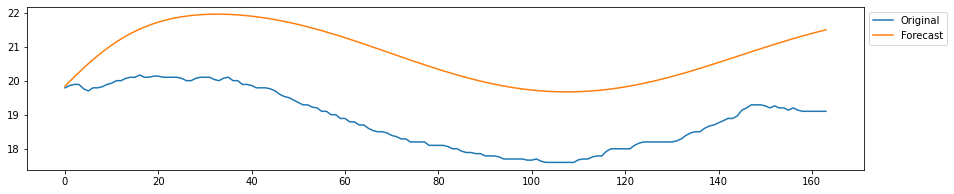

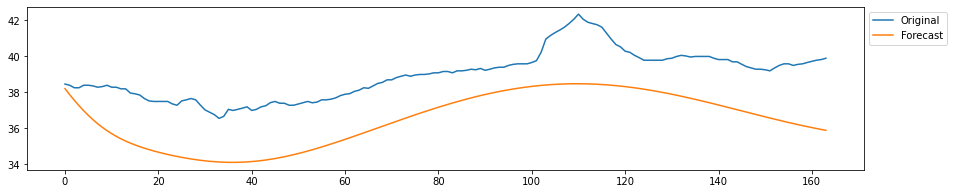

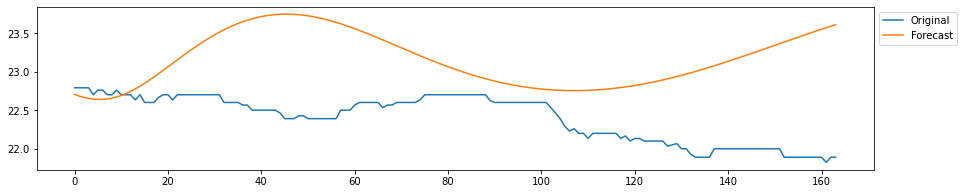

...

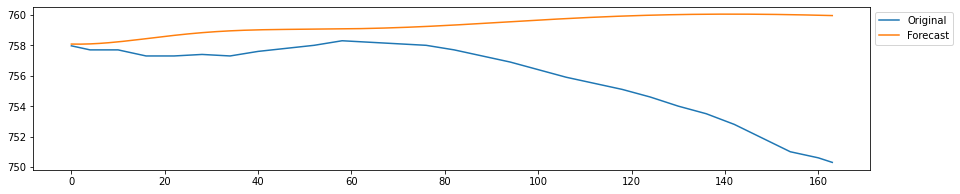

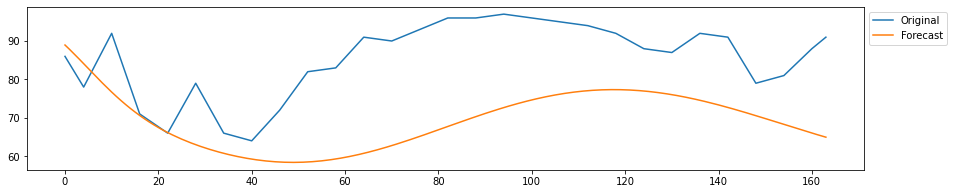

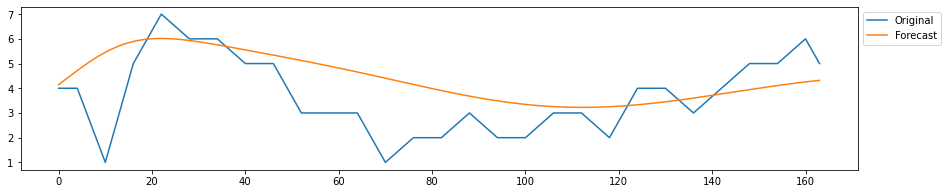

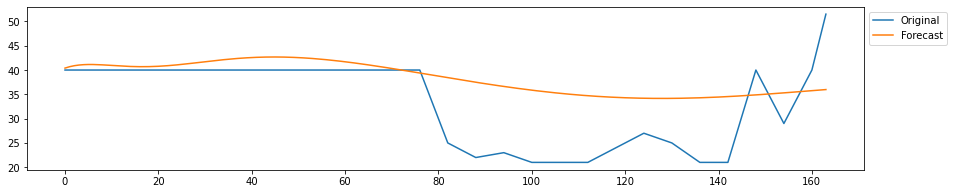

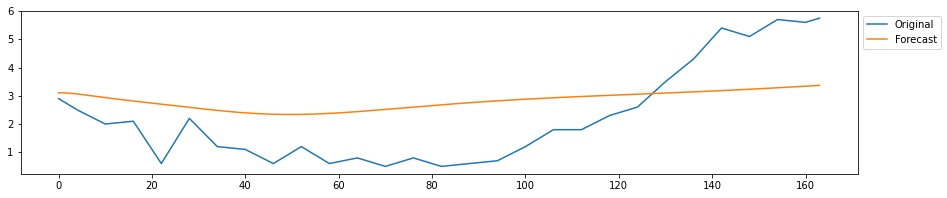

--------------------
training window 15111


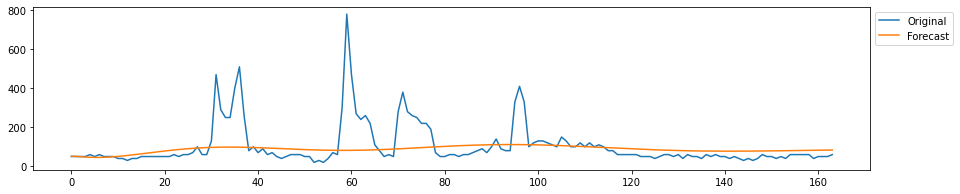

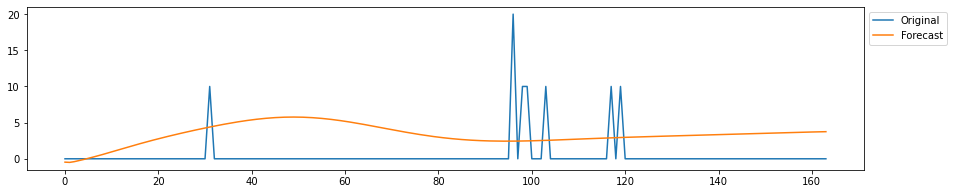

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


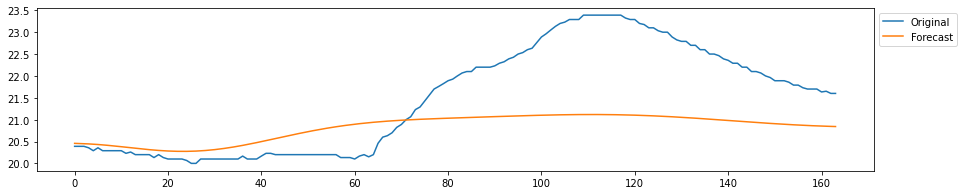

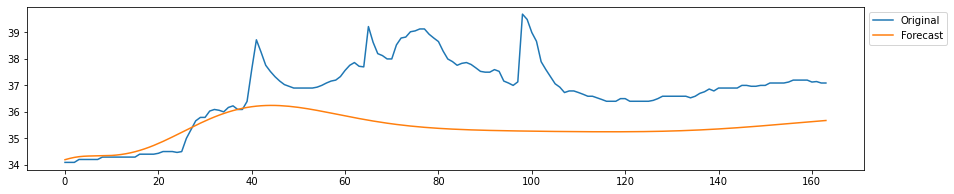

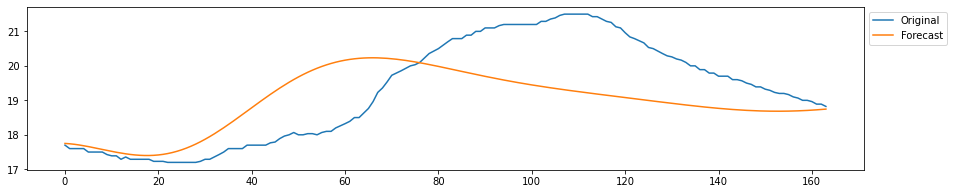

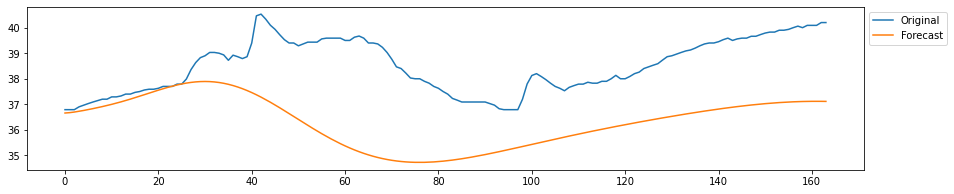

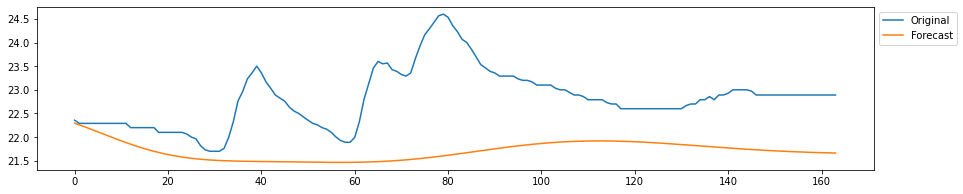

...

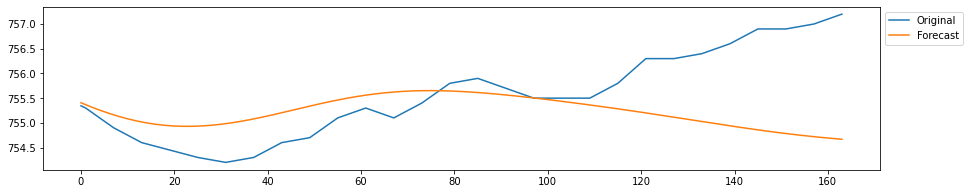

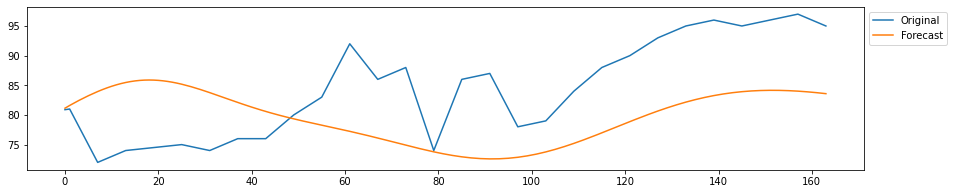

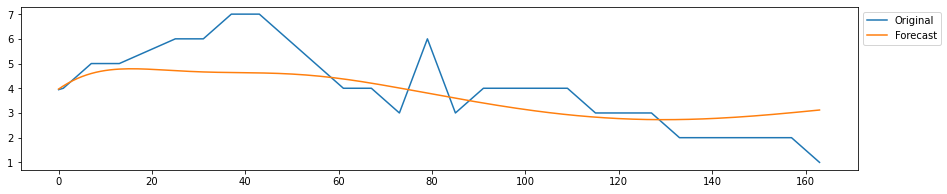

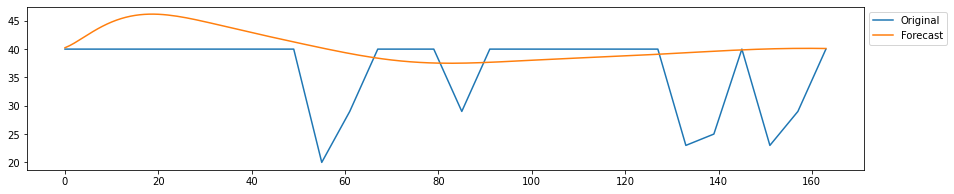

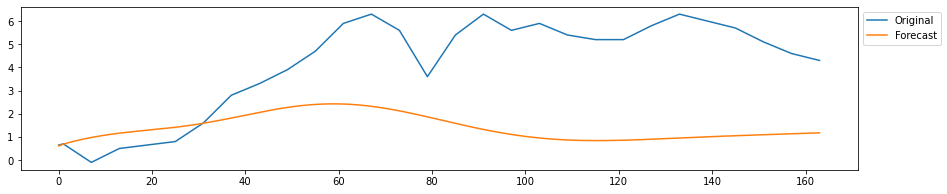

--------------------
training window 15768


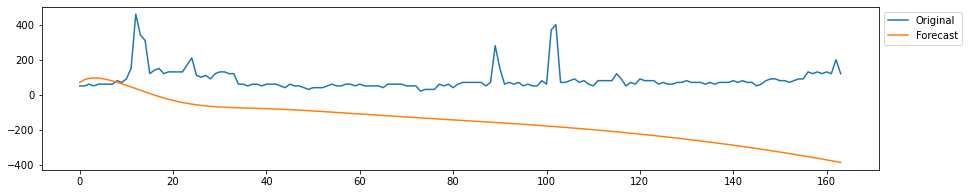

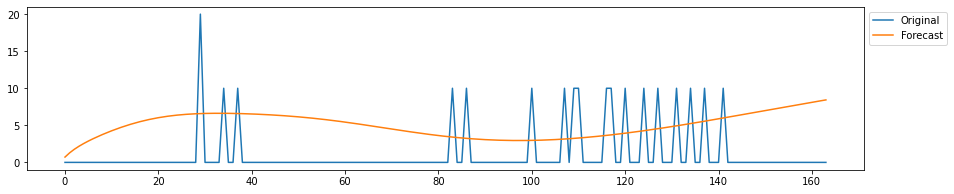

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


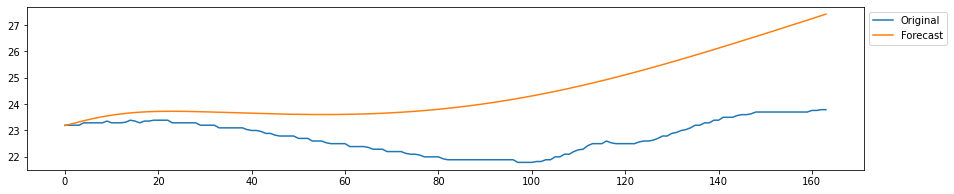

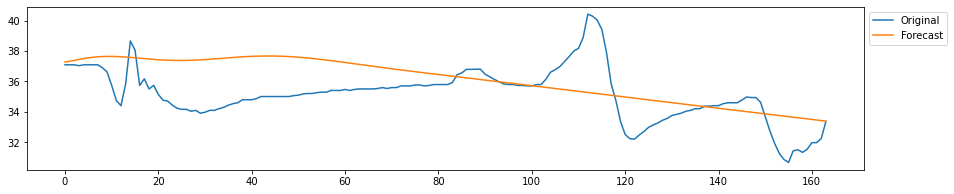

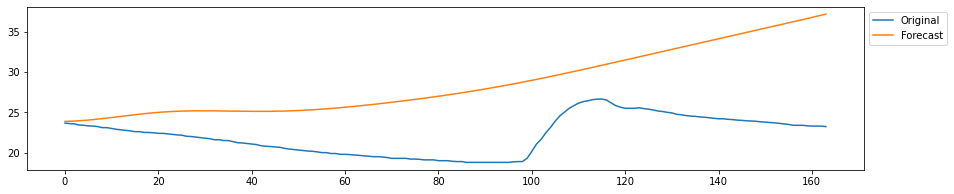

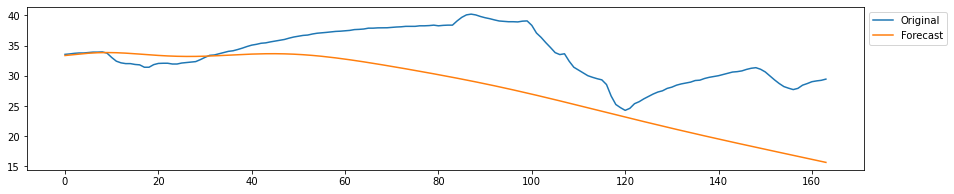

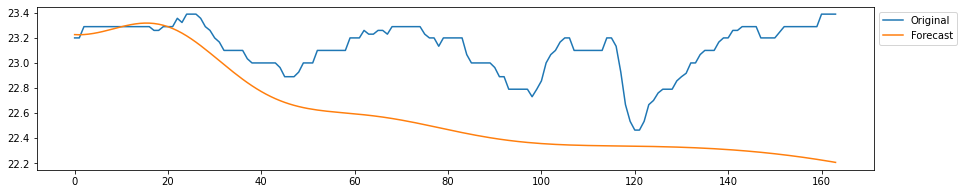

...

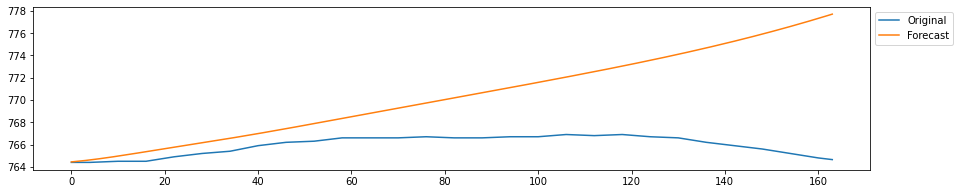

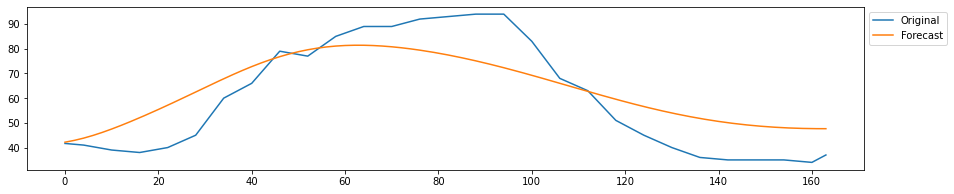

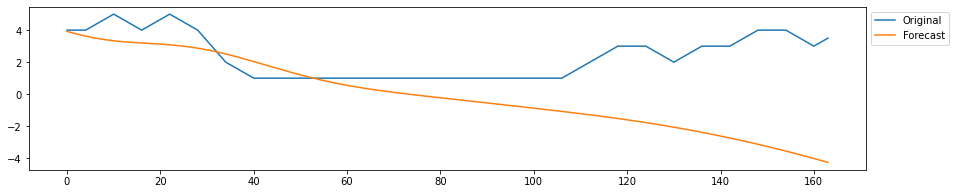

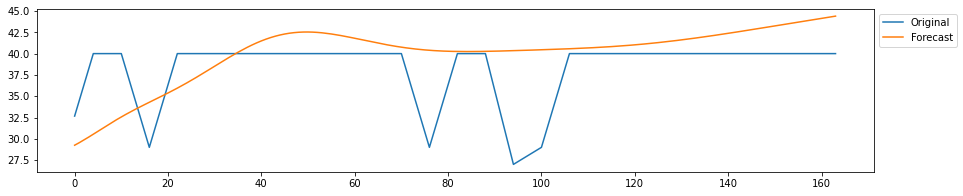

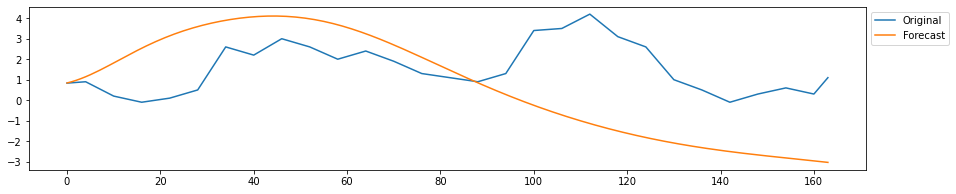

--------------------
training window 16425


/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


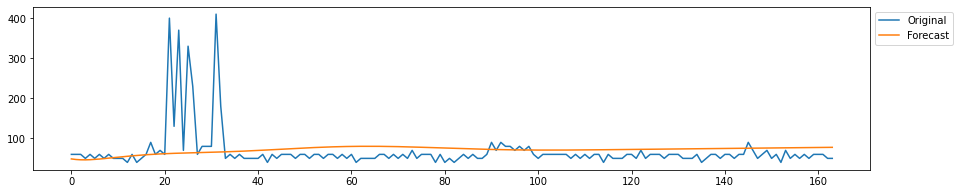

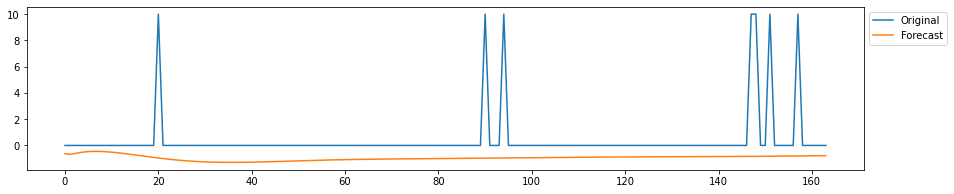

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


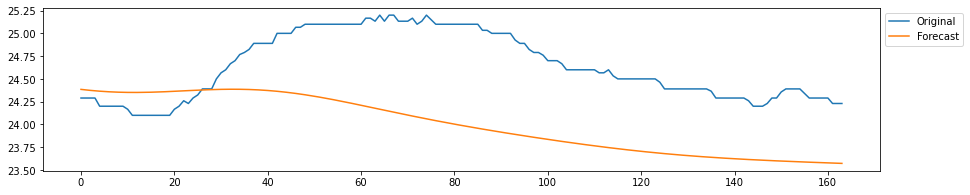

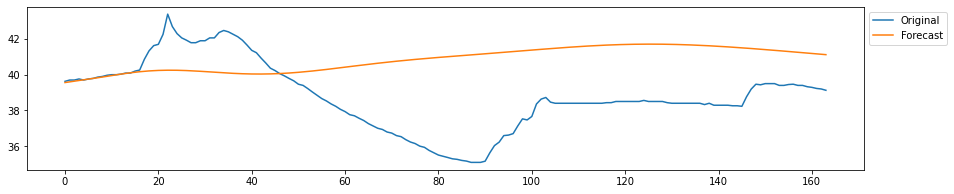

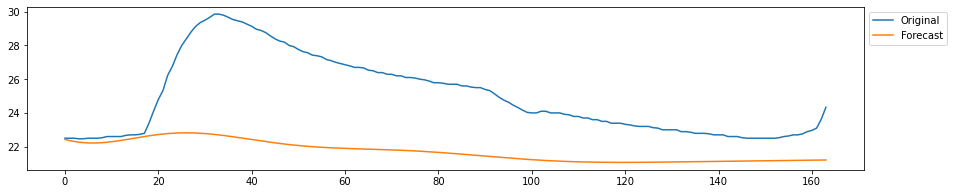

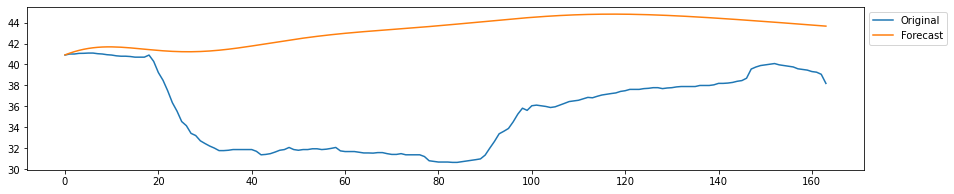

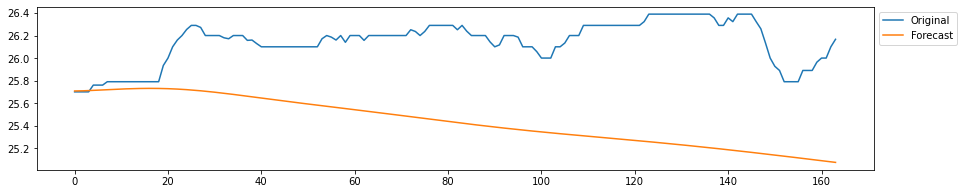

...

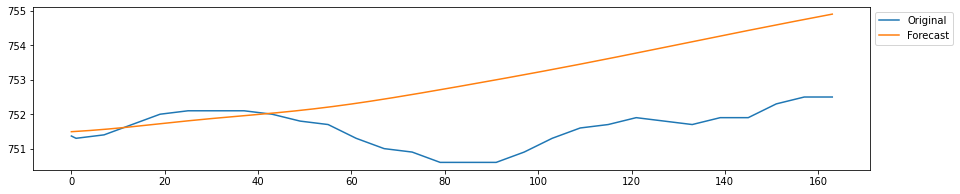

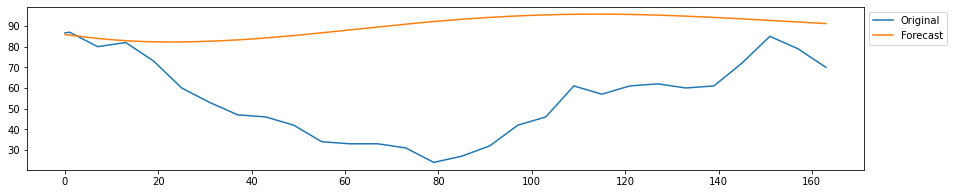

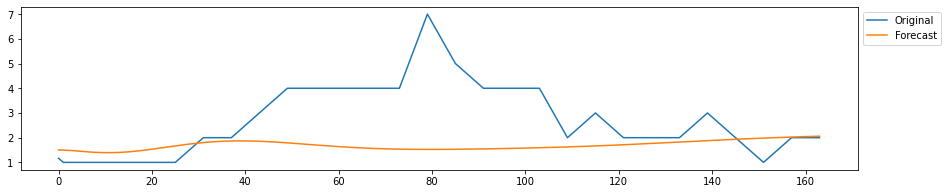

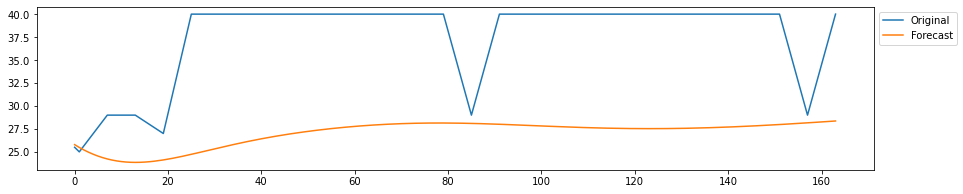

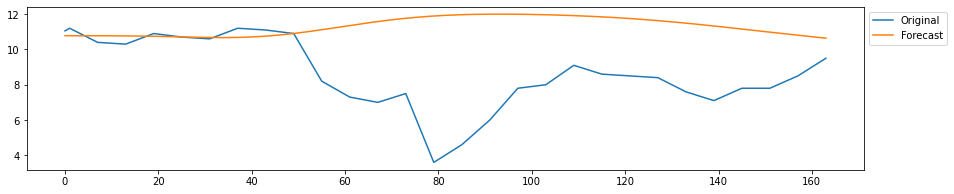

--------------------
training window 17082


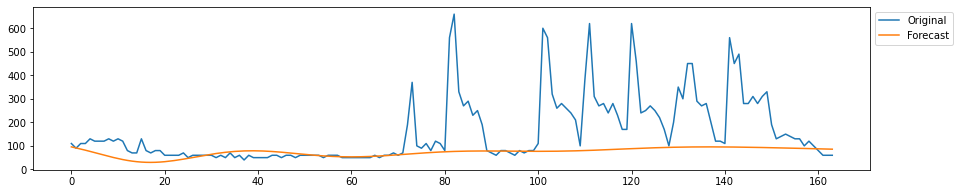

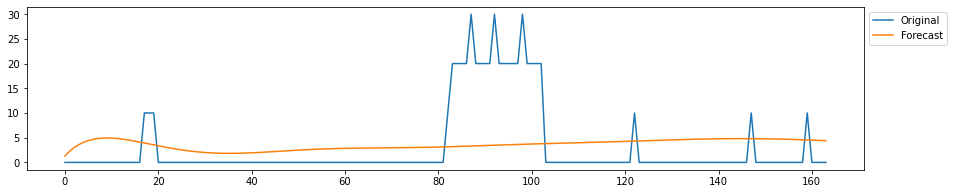

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


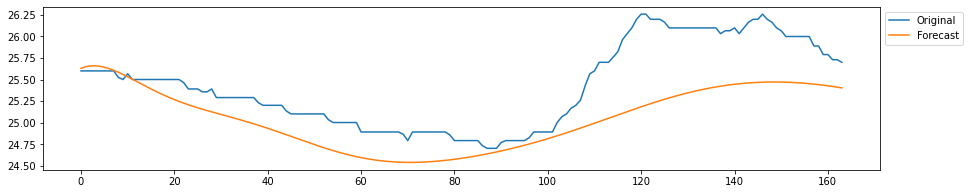

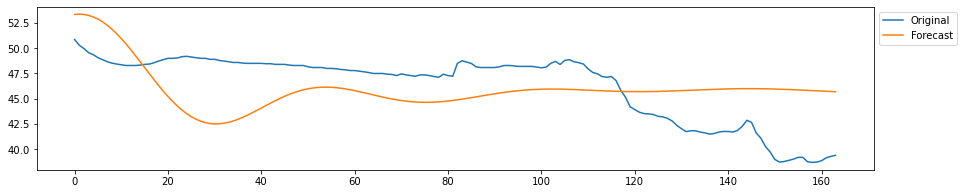

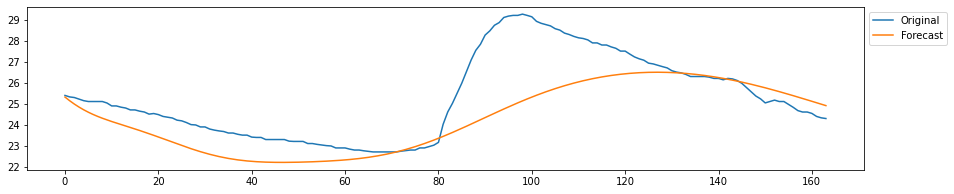

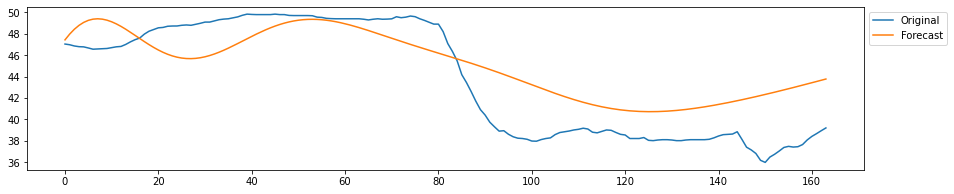

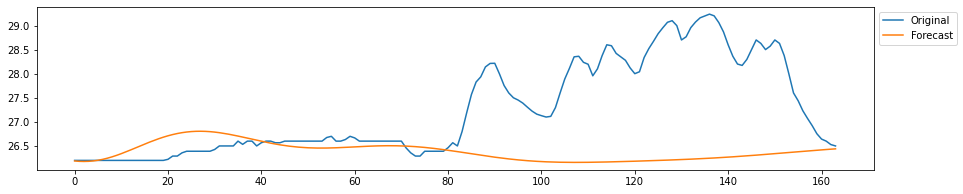

...

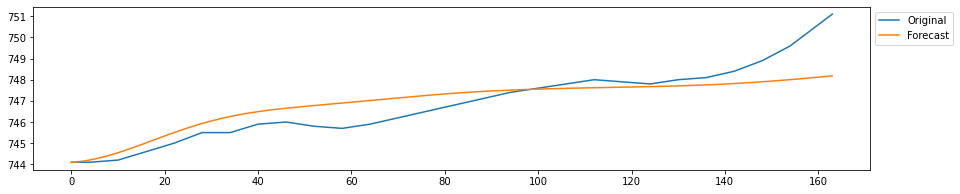

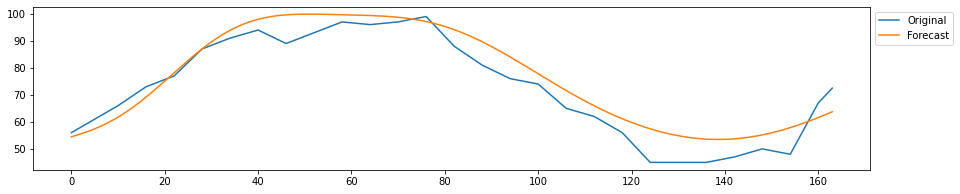

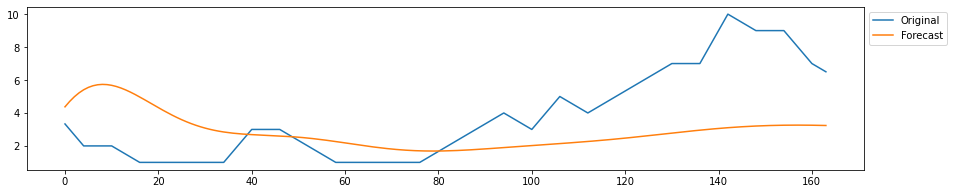

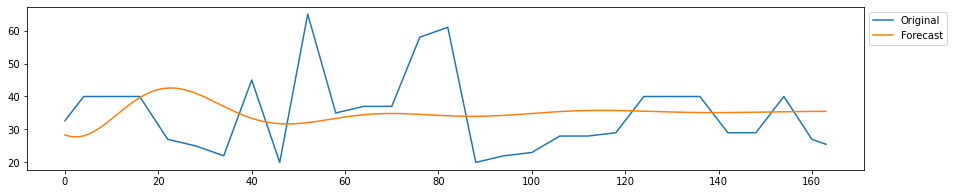

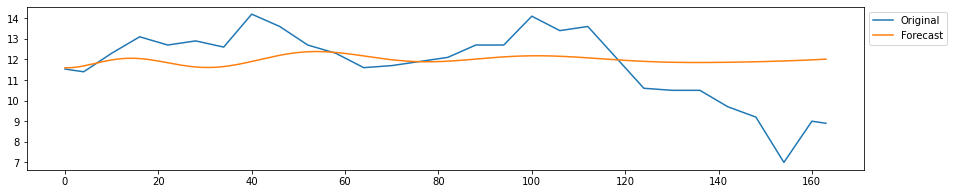

--------------------
training window 17739


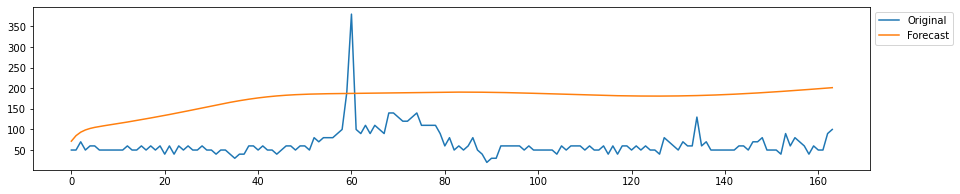

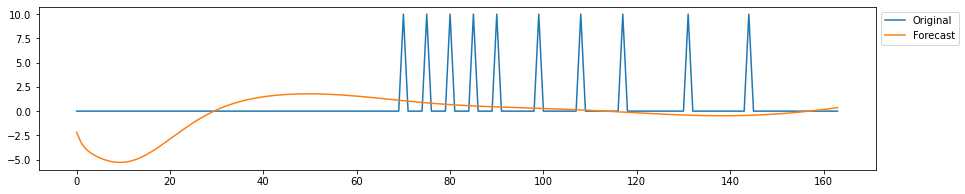

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


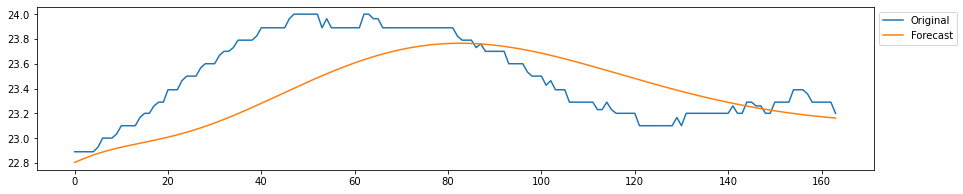

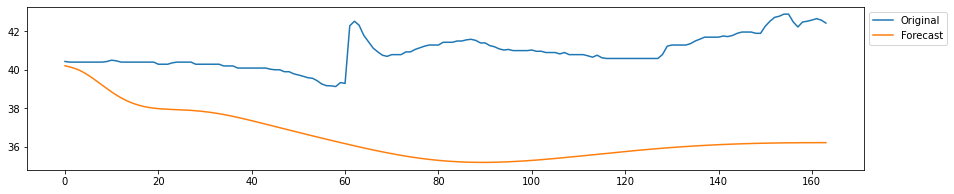

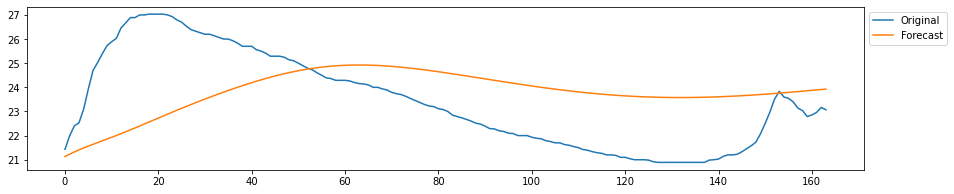

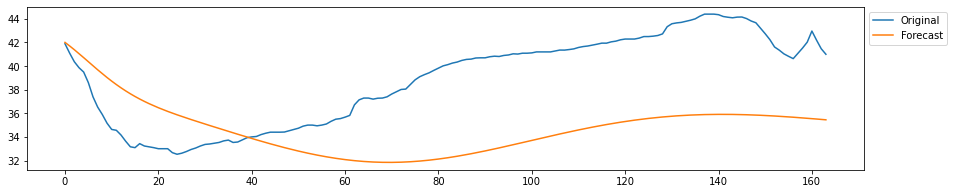

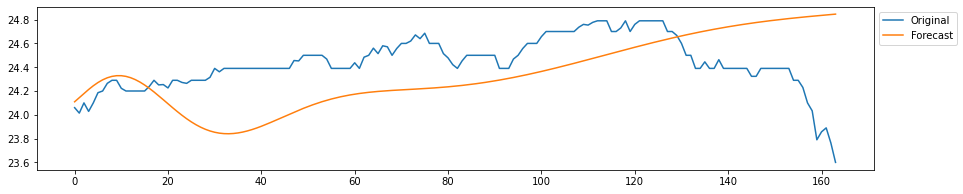

...

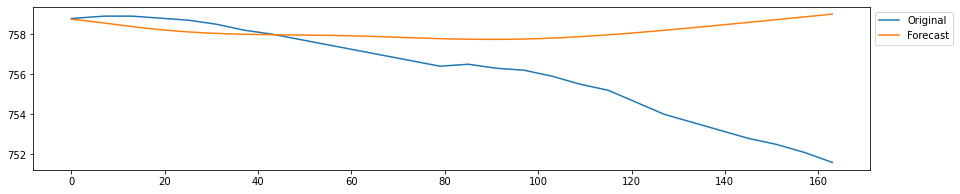

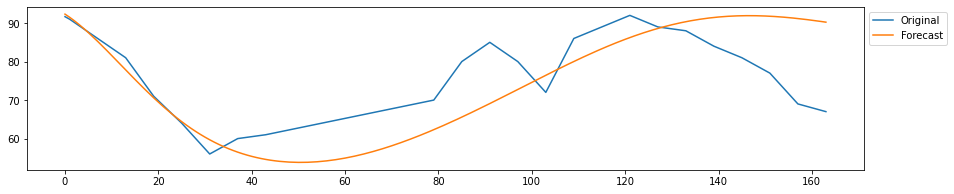

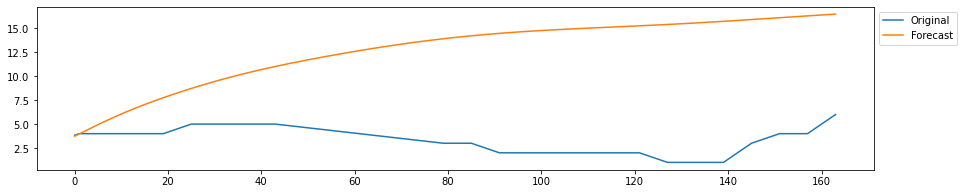

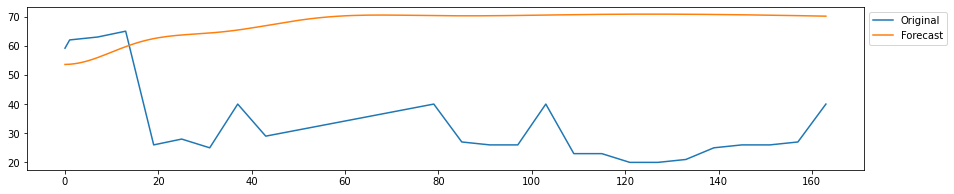

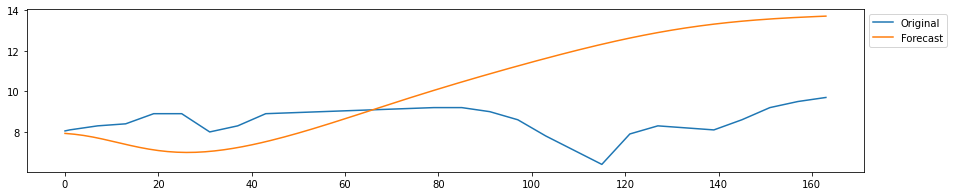

--------------------
training window 18396


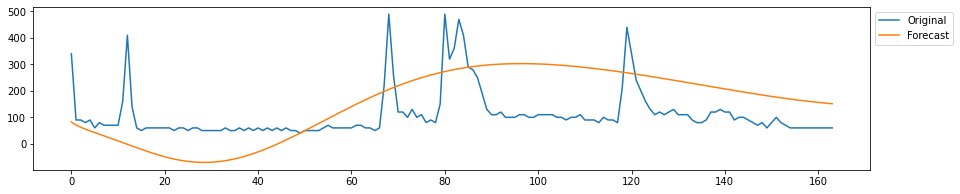

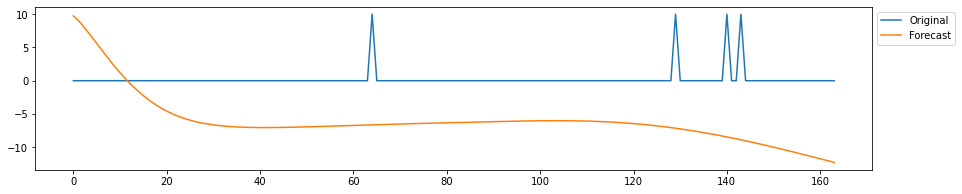

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


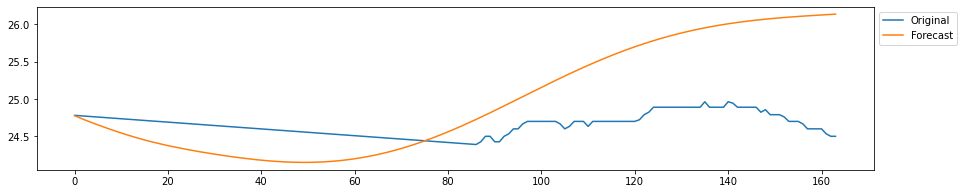

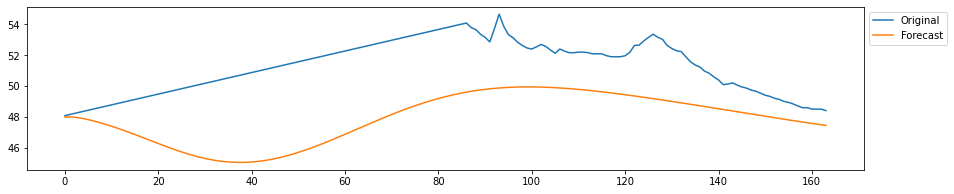

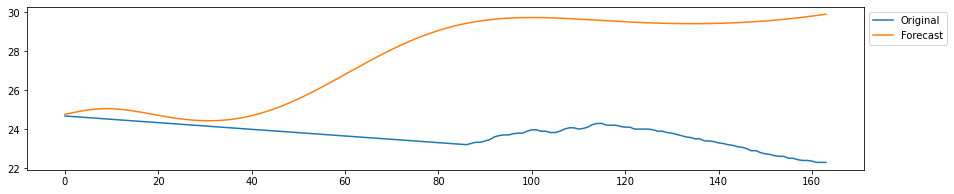

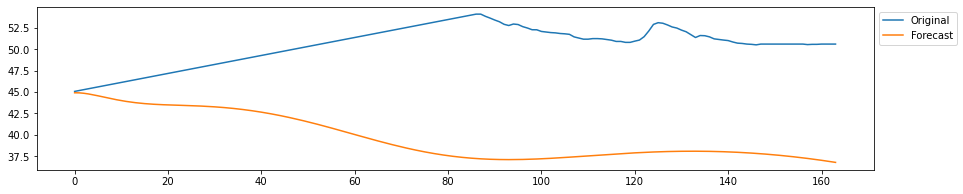

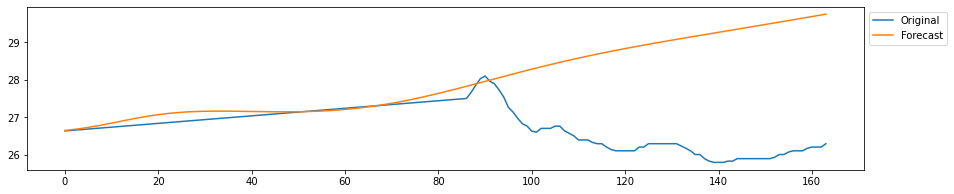

...

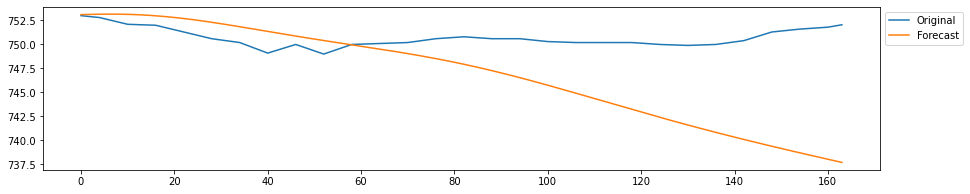

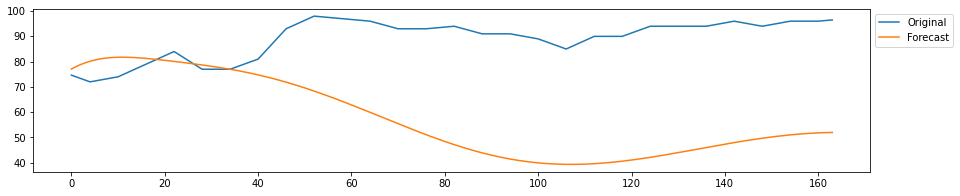

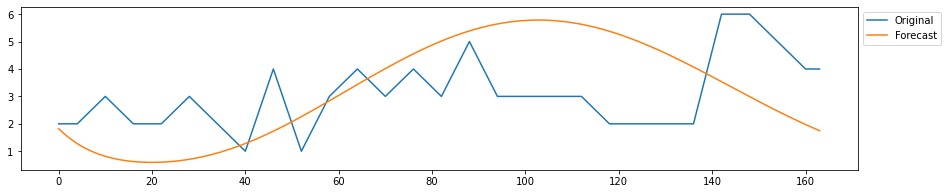

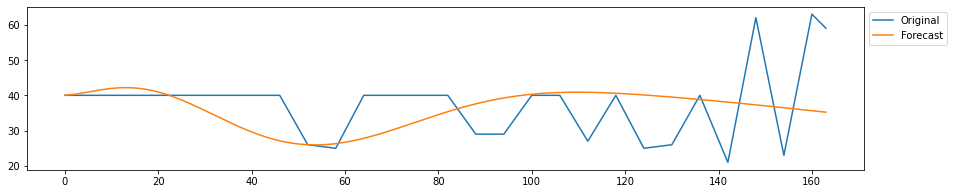

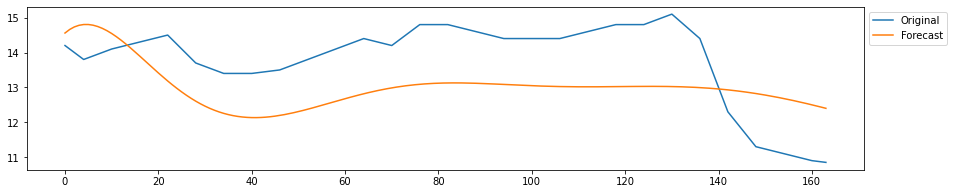

--------------------
training window 19053


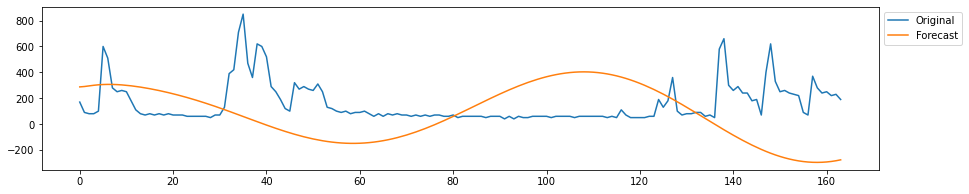

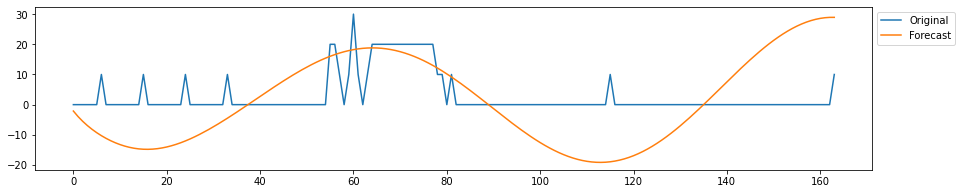

/home/hugo/anaconda3/lib/python3.8/site-packages/pyFTS/benchmarks/Measures.py:83: RuntimeWarning: divide by zero encountered in true_divide
  return np.nanmean(np.abs(np.divide(np.subtract(targets, forecasts), targets))) * 100


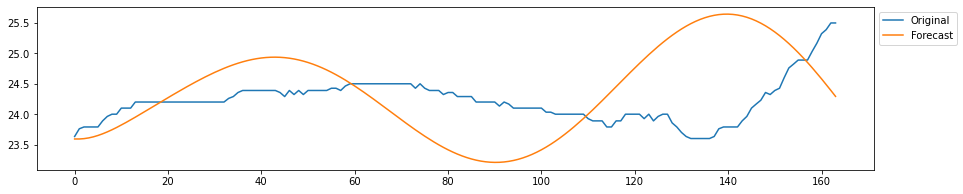

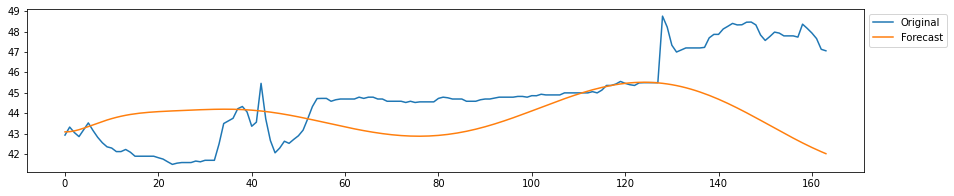

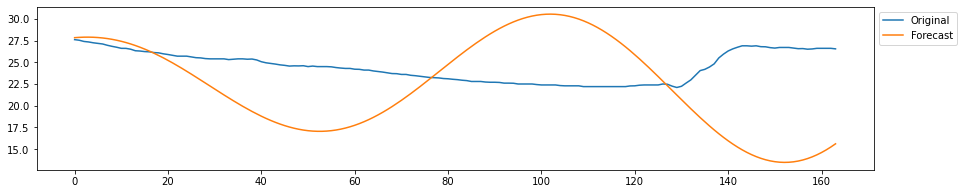

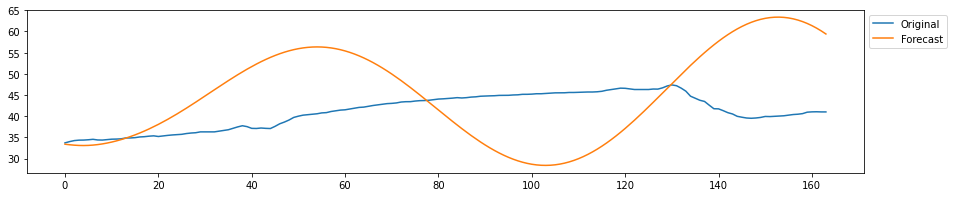

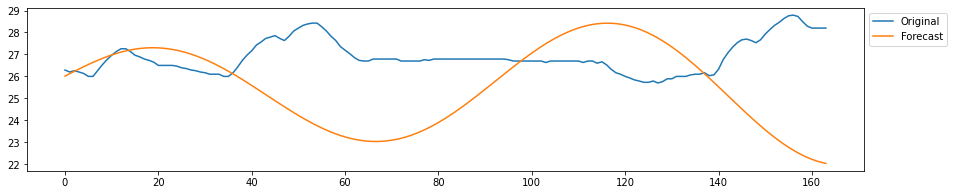

...

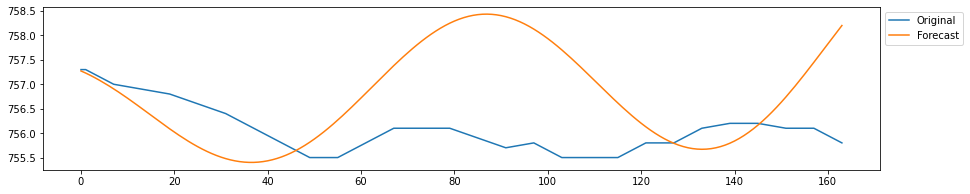

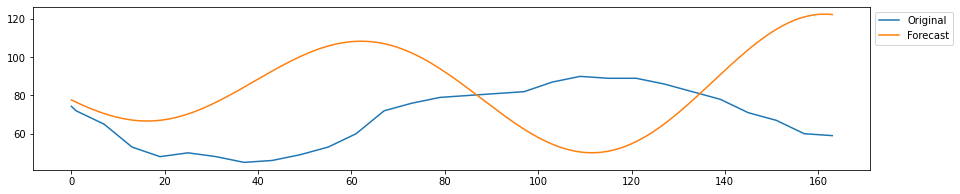

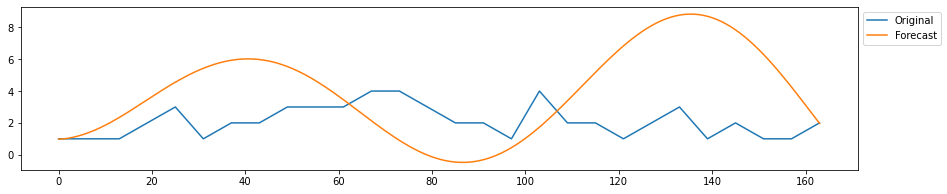

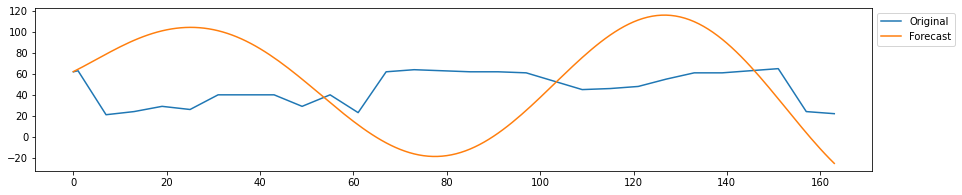

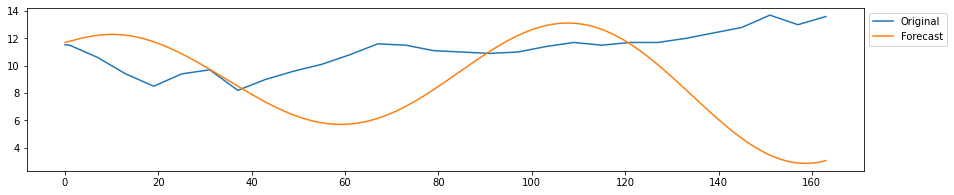

In [23]:
# p = 1
var_result =  sliding_window(data=reframed,n_windows=30,train_size=0.75)

In [13]:
import statistics
columns = reframed.loc[:,'Appliances(t)':'Tdewpoint(t)'].columns


final_result = {
    "variable": [],
    "rmse": [],
    "mae": [],
    "mape": [],
    "r2": [],
    "smape": [],
    "nrmse": []
}

measures = var_result
var = measures.groupby("variable")

for col in columns:

    var_agr = var.get_group(col)

    rmse = round(statistics.mean(var_agr.loc[:,'rmse']),3)
    mape = round(statistics.mean(var_agr.loc[:,'mape']),3)
    mae = round(statistics.mean(var_agr.loc[:,'mae']),3)
    r2 = round(statistics.mean(var_agr.loc[:,'r2']),3)
    smape = round(statistics.mean(var_agr.loc[:,'smape']),3)
    nrmse = round(statistics.mean(var_agr.loc[:,'nrmse']),3)

    final_result["variable"].append(col)
    final_result["rmse"].append(rmse)
    final_result["mape"].append(mape)
    final_result["mae"].append(mae)
    final_result["r2"].append(r2)
    final_result["smape"].append(smape)
    final_result["nrmse"].append(nrmse)

    #print(f'Results: {(col,rmse,mae,r2)}')


final_measures = round(pd.DataFrame(final_result),3)

In [17]:
final_measures

,variable,rmse,mae,mape,r2,smape,nrmse
0,Appliances(t),125.775,91.901,117.295,-2.543000e+00,38.755,0.272
1,lights(t),9.207,7.200,inf,-1.701000e+00,90.328,inf
2,T1(t),1.037,0.885,4.148,-3.454000e+00,2.088,0.542
3,RH_1(t),2.380,1.971,4.879,-2.291000e+00,2.437,0.327
4,T2(t),2.049,1.752,8.284,-5.265000e+00,4.131,0.567
5,RH_2(t),3.623,3.094,7.814,-2.905000e+00,3.892,0.452
6,T3(t),1.016,0.841,3.745,-6.684000e+00,1.887,0.607
7,RH_3(t),1.918,1.629,4.229,-3.618000e+00,2.073,0.454
8,T4(t),1.271,1.114,5.517,-8.002000e+00,2.799,0.662
9,RH_4(t),2.190,1.912,4.876,-3.501000e+00,2.437,0.467


In [16]:
#final_measures.to_csv("a.csv",index = False, header=True)